# Fifth Exercise (Chapter 10)

This exercise focuses on recurrent neural networks (RNN). Also, we'll be using Pytorch from now on 🎉!

We will:
- implement an LSTM cell in Pytorch,
- train two forms of RNNs, namely:
    - many to one: value memorization
    - many to many: de-noising sequences

In [1]:
from typing import Tuple, Union

import numpy as np  # generate training data
# pytorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt

from torch.nn.parameter import Parameter
import math

## Preliminary Questions

Before we dive into the implementation parts, let's think about a few aspects of recurrent neural networks.
*Hint: Reading chapter 10 of the deep learning book might help with answering the questions.* Two other great resources are:
- Andrej Karpathy's [blog post on RNNs](http://karpathy.github.io/2015/05/21/rnn-effectiveness/), which, among other things, nicely explains the different variants of RNNs (one-to-one, many-to-many, etc).
- Chris Olah's [blog post on LSTMs](http://colah.github.io/posts/2015-08-Understanding-LSTMs/).



**1.** In what sense are convolutional neural networks and recurrent neural networks similar? In what sense are they different?

**Answer**:  

Convolutional Neural Networks (CNNs) use as input a fixed-sized vector (e.g. an image) and it produces a fixed-sized vector as output (e.g. the probability that such image belongs to different classes). CNNs perform this mapping between input and output through a fixed amount of computational steps (also called number of layers). As can be seen, CNNs are constrained in their API.

However, Recurrent Neural Networks (RNNs) are more flexible. RNNs work with sequences of vectors, and they can be in the input, output or both of them. This sequence regime is much powerful than using fixed-sized networks.

In the other side, one of the features that both network architectures share, is Weight Sharing (but in different ways). CNNs share weights across their input dimensions, and RNNs do the same, but in/through  time. 

**2.** How can one counteract vanishing or exploding gradients in RNNs, allowing to learn long-term dependencies?

**Answer**:  

Before in MLPs, we faced the Vanishing Gradient problem with bypass or skips connections, which allow us to drive the unaltered gradients to other parts of the network. Here, LSTMs could to the same thing, if the cell state would persists indefinitely.

In the other hand, exploding gradients can be solved by clipping the cell states of the LSTMs.

## LSTM cell
See chapter 10.10.1 of the DL book.

In Pytorch, all layers inherit from `nn.Module` and implement the `forward` function (the `backward` pass is computed automatically). Parameters should be initialized in the constructor.

To get a feeling for how layers are implemented in pytorch, you can for example take a look at the source code of the [Linear layer](https://pytorch.org/docs/stable/_modules/torch/nn/modules/linear.html#Linear) ($h = wX+b$).

Your task here is to implement the LSTMCell, which takes a feature tensor and the hidden state as input and returns the new hidden state (sometimes also referred to as output) and the new cell state.


In [2]:
class LSTMCell(nn.Module):
    """The LSTM layer."""
    
    def __init__(self, input_size: int, hidden_size: int):
        super().__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size
        
        # START TODO #############
        # initialize required parameters / layers

        #Forget Gate
        self.Wf = Parameter(torch.Tensor(self.input_size + self.hidden_size, self.hidden_size))
        self.bf = Parameter(torch.Tensor((self.hidden_size)))
        #self.reset_parameter(self.Wf, self.bf)
        
        #Input Gate
        self.Wi = Parameter(torch.Tensor(self.input_size + self.hidden_size, self.hidden_size))
        self.bi = Parameter(torch.Tensor((self.hidden_size)))
        #self.reset_parameter(self.Wi, self.bi)
        
        #Cell state
        self.Wc = Parameter(torch.Tensor(self.input_size + self.hidden_size, self.hidden_size))
        self.bc = Parameter(torch.Tensor((self.hidden_size)))
        #self.reset_parameter(self.Wc, self.bc)
        
        #Output
        self.Wo = Parameter(torch.Tensor(self.input_size + self.hidden_size, self.hidden_size))
        self.bo = Parameter(torch.Tensor((self.hidden_size)))
        #self.reset_parameter(self.Wo, self.bo)
        
        for w in [
            self.Wf, self.bf,
            self.Wi, self.bi,
            self.Wc, self.bc,
            self.Wo, self.bo,
        ]:
            w.data.uniform_(-0.05, 0.05)
            
        # END TODO #############
            
    def reset_parameter(self, weight, bias):
        stdv = 1. / math.sqrt(weight.size(1))
        weight.data.uniform_(-stdv, stdv)
        if bias is not None:
            bias.data.uniform_(-stdv, stdv)
    
    def forward(self, x: torch.Tensor, hx: Tuple[torch.Tensor] = None) -> Tuple[torch.Tensor]:
        """
        
        Args:
            x: The input tensor with shape (batch_size, feature_dim)
            hx: The initial hidden state, optional. Is a two-tuple consisting of
                the current hidden state and the internal cell state. Both have
                shape (batch_size, hidden_size).
                
        Returns:
            Tuple as (output_hidden, new_internal_state).
        """
        if hx is None:
            hx = self._init_hidden_state(x)
        hidden_state, internal_state = hx
        
        # START TODO #############

        # First, we concatenate the hidden state (ht-1) with the input x
        # We will use this concatenation more times after
        conc = torch.cat((hidden_state,x),1)
        
        # 1°Step: Forgot Gate layer
        # ====================
        # We decide which information we throw away, and which we keep
        # It outputs a number between 0 and 1 determining the importance of the information
        # (e.g 1 is keep all, 0 is remove completely)
        f_tmp = torch.mm(conc,self.Wf)
        forget_gate = torch.sigmoid(f_tmp + self.bf.expand_as(f_tmp))
        
        # 2°Step: Input Gate layer
        # Here we decide which new information we are going to store in the cell state
        # To do so, there are two steps:
        
        # First, the sigmoid function says which values we are goint to update        
        i_tmp = torch.mm(conc,self.Wi)
        input_gate = torch.sigmoid(i_tmp + self.bi.expand_as(i_tmp))
        
        # Second, the tanh function create a vector of candidates to be added to the cell state
        c_tmp = torch.mm(conc, self.Wc)
        internal_state_candidates = torch.tanh(c_tmp + self.bc.expand_as(c_tmp))
        
        # 3°Step: Update Cell State
        # We replace the old Cell State by the updated one.
        # First, we multiply the old state by the Forgetting function, forgetting the things we decided to forget earlier. 
        # Then we add the new candidate values, scaled by how much we decided to update each state value
        new_internal_state = (forget_gate*internal_state) + (input_gate*internal_state_candidates)
        
        # 4°Step: Output
        # Here we decide what we are going to output. It is basically a "filtered" Cell State. There are two steps:
        
        # The sigmoid function "filters", by deciding which parts of the Cell State we are going to output
        temp_o = torch.mm(conc, self.Wo)
        output = torch.sigmoid(temp_o + self.bo.expand_as(temp_o))
        
        # Then, we multiply the previous output, by a tanh version of the (updated already) Cell State
        new_hidden_state = output*torch.tanh(new_internal_state)
                
        return new_hidden_state, new_internal_state
    
        # END TODO #############
    
    def _init_hidden_state(self, x):
        """Returns the hidden state with zeros.
        
        Returns:
            A two-tuple (initial_hidden_state, initial_cell_state).
            Both are all zeros with shape (batch_size, hidden_size).
        """
        batch_size = x.shape[0]
        return torch.zeros(batch_size, self.hidden_size),torch.zeros(batch_size, self.hidden_size)

In [3]:
class LSTM(LSTMCell):
    """Convenience class that automatically iterates over the sequence."""
    
    def forward(self, x: Union[np.ndarray, torch.Tensor], hx=None):
        """Iterate over the sequence and apply the LSTM cell.
        
        Args:
            x: The input tensor with shape (seq_len, batch, input_size)
            hx: The initial hidden state, optional. Is a two-tuple consisting of
                the current hidden state and the internal cell state. Both have
                shape (batch_size, hidden_size). If None, set to zero.
        
        Returns:
            Tuple as (output_stacked_hidden, (last_hidden_state, last_new_internal_state)).
            output_stacked_hidden is the stacked output of all LSTMCells
            (excluding the cell state!)
        """
        # START TODO #############
        
        if not isinstance(x, torch.Tensor):
            x = torch.Tensor(x, requires_grad=True)
        
        # Lengh of the sequence
        seq_len = x.shape[0]
        
        # Batch size
        batch_size = x.shape[1]
        
        # Input size
        input_size = x.shape[2]

        output_stacked_hidden = torch.Tensor(seq_len, batch_size, self.hidden_size) 
        
        # Iteration over each element of the sequence
        for i in range(seq_len):
            xt = x[i,:,:]
            hx = super().forward(xt,hx)
            output_stacked_hidden[i] = hx[0]
        
        return output_stacked_hidden, hx
    
        # END TODO #############

As a simple test, let's see if the LSTM can learn to echo a value at a specific index of the sequence. If your implementation is correct, you should get around 97% accuracy.

In [4]:
# Create 100 training sequences of length 10
num_samples = 1000
seq_length = 10
batch_size = 5
# we use a hidden size larger 1 as it makes training easier
# as prediction we compute the mean over the output.
hidden_size = 6
training_sequences = torch.rand(seq_length, num_samples, 1)
print("training sequences size : {}".format(training_sequences.shape))
test_sequences = torch.rand(seq_length, 100, 1)
model = LSTM(1, hidden_size)
optimizer = optim.Adam(model.parameters(), lr=0.1)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=100)
loss_fn = torch.nn.MSELoss(reduction='elementwise_mean')


def accuracy(y, label, eps=1e-2):
    assert y.shape == label.shape, (y.shape, label.shape)
    return np.sum(np.abs(y - label) < eps) / len(y)


for epoch in range(101):
    for batch_idx in range(num_samples // batch_size):
        optimizer.zero_grad()
        batch = training_sequences[:, batch_idx * batch_size:(batch_idx + 1) * batch_size]
        # [10,5,1] batch sizes going in
        output = model(batch)[1][0]
        labels = batch[1]  # echo the second element
        loss = loss_fn(labels, output)
        loss.backward()
        optimizer.step()
    if epoch % 10 == 0: 
        #print(f"epoch: {epoch}, loss:{loss}")
        print("epoch: {}, loss:{}".format(epoch,loss))
        output = model(test_sequences)[1][0]
        labels = test_sequences[1]  # echo the second element
        acc = accuracy(np.squeeze(labels.numpy()),
                       np.mean(output.detach().numpy(), axis=-1))
        #print(f"test accuracy: {acc}")
        print("test accuracy: {}".format(acc))
    scheduler.step()

# 99% achieved using uniform distribution (-0.05, 0.05)

training sequences size : torch.Size([10, 1000, 1])
epoch: 0, loss:3.736010789871216
test accuracy: 0.06
epoch: 10, loss:0.04713137820363045
test accuracy: 0.25
epoch: 20, loss:0.02757234312593937
test accuracy: 0.41
epoch: 30, loss:0.17936159670352936
test accuracy: 0.26
epoch: 40, loss:0.03436749428510666
test accuracy: 0.45
epoch: 50, loss:0.013032358139753342
test accuracy: 0.54
epoch: 60, loss:0.008490351028740406
test accuracy: 0.73
epoch: 70, loss:0.007379497401416302
test accuracy: 0.78
epoch: 80, loss:0.0038124793209135532
test accuracy: 0.81
epoch: 90, loss:0.00281438953243196
test accuracy: 0.98
epoch: 100, loss:0.002418916905298829
test accuracy: 0.98


## LSTM Use Case - Noise Removal
Implement an RNN to remove noise from different sine function instances. If you didn't finish the `LSTM` implementation part, you can use `nn.LSTM` here.

The goal is to remove gaussian noise from a sequence generated from a sine function.

To get an idea what the data look like, plot six different sine function instances with and without noise.

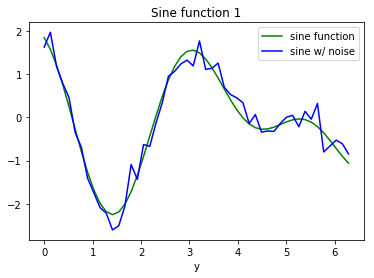

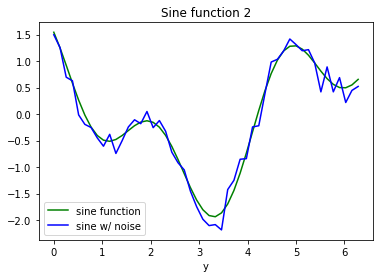

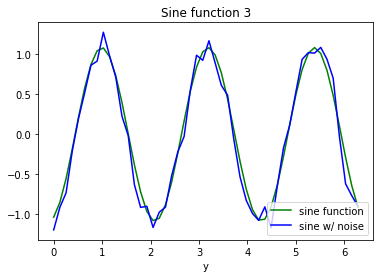

In [5]:
# let's create a generator for sine functions with different amplitudes, shift and frequency

class RandomSineFunction:
    
    def __init__(self):
        num_sines = np.random.randint(1, 4)
        self.amplitude = np.random.uniform(0, 2, num_sines)
        self.offsets = np.random.uniform(-np.pi, np.pi, num_sines)
        self.frequency = np.random.uniform(0.1, 1, num_sines)
        
    def __call__(self, x):
        return np.array([a * np.sin(np.pi * f * x + o)
                         for a, f, o in zip(self.amplitude, self. frequency, self.offsets)]).sum(axis=0)

    
def sample_sine_functions(num_functions):
    return [RandomSineFunction() for _ in range(num_functions)]


def noisy(y, noise_ratio=0.05, axes=None):
    noise_range = np.ptp(y, axis=axes, keepdims=True) * noise_ratio
    return y + np.random.normal(0, noise_range, size=y.shape)

# START TODO #############

functions = sample_sine_functions(3)
for i in range(len(functions)):

    # Generate equally spaced data in x and function in y
    x = np.linspace(0, 2*np.pi, 50)
    y = functions[i](x)
    yn = noisy(y)
    
    plt.figure(i)
    plt.title("Sine function %s" % (i+1) )
    plt.xlabel("x")
    plt.xlabel("y")
    plt.plot(x,y, color = 'green', label = 'sine function')
    plt.plot(x,yn, color = 'blue', label = 'sine w/ noise')
    plt.legend()
    plt.show()

# END TODO #############


Now it's time to define the model! Let's stack two LSTMs both with output shape (sequence_length, batch_size, hidden_size) followed by a Linear layer which takes a (sequence_length, batch_size, hidden_size) vector as input and outputs a tensor with shape (sequence_length, batch_size, 1).


To allow the model to see some values before estimating the output, pad the sequence accordingly.

In [6]:
class NoiseRemovalModel(nn.Module):
    """
    """
    
    def __init__(self, hidden_size: int, shift: int = 10):
        """
        Args:
            hidden_size: the number of units of the LSTM hidden state size.
            shift:       the number of steps the RNN is run before its output
                             is considered ("many-to-many shifted to the right").
        """
        super().__init__()
        self.shift = shift
        
        # START TODO #############
        
        # LSTM_1 (x=1, hx) -> LSTM_2 (x=hx, hx) -> Linear(x=hx, 1)
        self.LSTM_1 = LSTM(1, hidden_size)
        self.LSTM_2 = LSTM(hidden_size, hidden_size)
        self.LINEAR = nn.Linear(hidden_size, 1)
    
        # END TODO #############

        
    def forward(self, x: np.ndarray) -> torch.Tensor:
        """Forward pass of noise removal.
        
        This function
        1) pads the input sequence with self.interval zeros at the end,
        2) applies an LSTM
        3) cuts the first self.interval outputs
        4) applies another LSTM
        5) applies Linear layer.
        
        Args:
            x: The input sequence (equence_length, batch_size, 1)
        
        Returns:
            A torch.Tensor of shape (sequence length, batch_size, 1)
        """
        
        # Pad input sequence x at the end (shifted many-to-many model).
        # This allows the model to see a few numbers before it has to guess
        # the noiseless output.
        
        # START TODO #############
        
        # 1) We pad the input sequence at the end
        # x.size before (80, 10, 1)
        x = F.pad(x, (0,0,0,0,0,self.shift), 'constant', 0)    
        # x.size before (90, 10, 1)

        # 2) LSTM_1
        h1, (_,_) = self.LSTM_1.forward(x)
        
        # 3) Cuts the first self.interval outputs
        h1 = h1[self.shift:,:,:]
                
        # 4) LSTM_2
        h2, (_,_) = self.LSTM_2.forward(h1)
                
        # h1.size before (90, 10, 40)
        # h1.size after (80, 10, 40)
        # h2.size before (80, 10, 40)   
        # h2.size after (80, 10, 1)

        # 5) Linear layer
        out = self.LINEAR.forward(h2)
        # output size (80, 10, 1)

        return out
    
        # END TODO #############

In [7]:
num_functions = 200
sequence_length = 80
noise_ratio = 0.05
np.random.seed(0)
train_functions = sample_sine_functions(num_functions)
val_functions = sample_sine_functions(50)
# interval on which we'll train and evaluate
x = np.linspace(0, 5, sequence_length)


def prepare_sequences(functions):
    """Convert to tensor and create noisy sequence"""
    sequences = np.array([f(x).reshape(-1, 1) for f in functions])
    # put the sequence into the first dimension
    sequences = sequences.transpose([1, 0, 2])
    # add some noise
    noisy_sequences = noisy(sequences, noise_ratio, axes=(0, 2))
    return torch.Tensor(sequences), torch.Tensor(noisy_sequences)


train_sequences, noisy_train_sequences = prepare_sequences(train_functions)
val_sequences, noisy_val_sequences = prepare_sequences(val_functions)
print(train_sequences.shape)

torch.Size([80, 200, 1])


In [8]:
loss_fn = torch.nn.MSELoss(reduction='elementwise_mean')


def plot_curves(ground_truth, noisy_sequence, model_output):
    plt.figure(figsize=(14,3))
    for i in range(min(len(ground_truth), 5)):
        plt.subplot(1, 5, i + 1)
        plt.plot(x, ground_truth[i], label="ground_truth")
        plt.plot(x, noisy_sequence[i], label="noisy_sequence")
        plt.plot(x, model_output[i], label="model_output")
    plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
    plt.show()

    
def percentage_noise_removed(ground_truth, noisy_sequence, model_output):
    """Computes the percentage of noise the model removed."""
    return 100 * (1 - (np.abs(ground_truth - model_output).sum() /
                  np.abs(ground_truth - noisy_sequence).sum()))


def train(model, optimizer, scheduler, num_epochs, batch_size, plot=True):
    for epoch in range(num_epochs):
        for batch_idx in range(num_functions//batch_size): # 20 batches going in, each of size 80x10x1
            batch =  noisy_train_sequences[:, batch_idx * batch_size:(batch_idx + 1) * batch_size]
            output = model(batch)
            labels = train_sequences[:, batch_idx * batch_size:(batch_idx + 1) * batch_size]
            loss = loss_fn(labels, output)
            loss.backward()
            optimizer.step()
        # compute the validation loss
        output = model(noisy_val_sequences)
        loss = loss_fn(val_sequences, output)
        print("epoch: {}, validation loss:{}".format(epoch,loss))
        if epoch % 1 == 0:
            np_tensors = [a.detach().numpy().transpose([1, 0, 2])
                          for a in (val_sequences, noisy_val_sequences, output)]
            if plot:
                plot_curves(*np_tensors)
            #print(f"{percentage_noise_removed(*np_tensors):2.4f}% of noise removed.")
        #scheduler.step()


cuda avialable : False
epoch: 0, validation loss:3717.550048828125


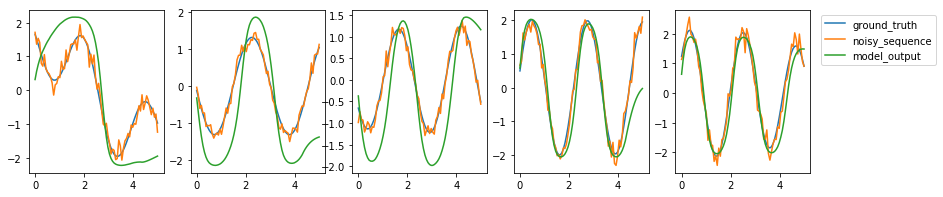

epoch: 1, validation loss:4408.279296875


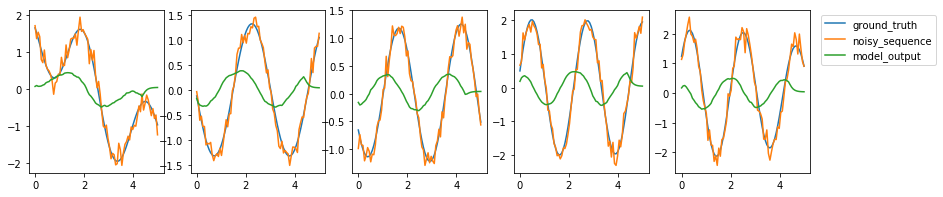

epoch: 2, validation loss:2888.97607421875


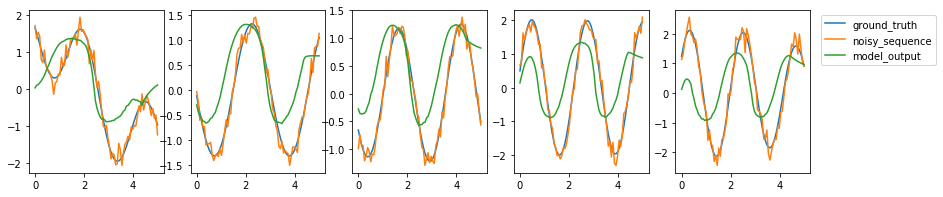

epoch: 3, validation loss:3613.495849609375


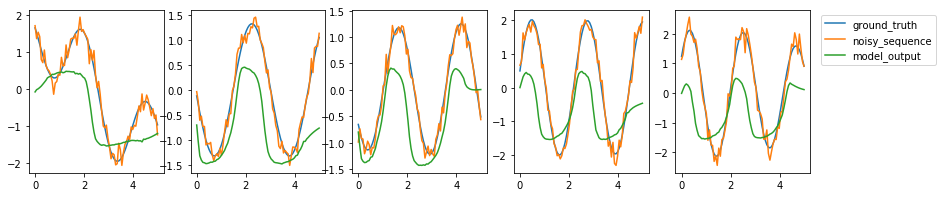

epoch: 4, validation loss:3662.571533203125


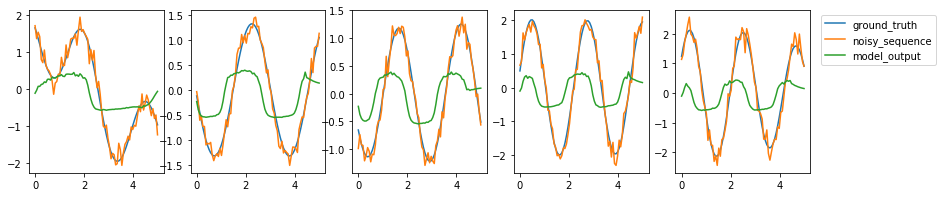

epoch: 5, validation loss:3780.7421875


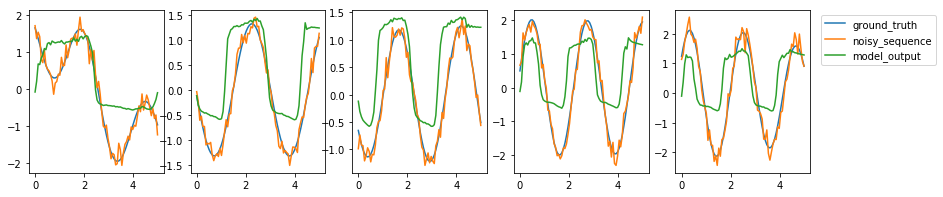

epoch: 6, validation loss:2522.09423828125


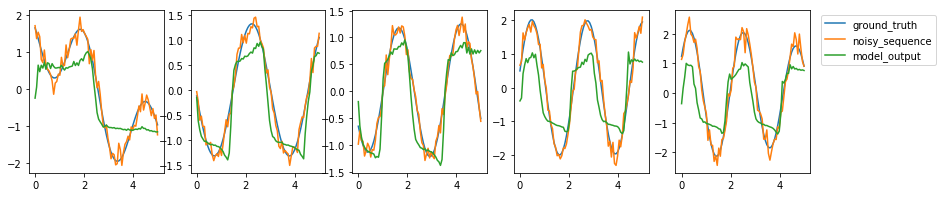

epoch: 7, validation loss:2193.97412109375


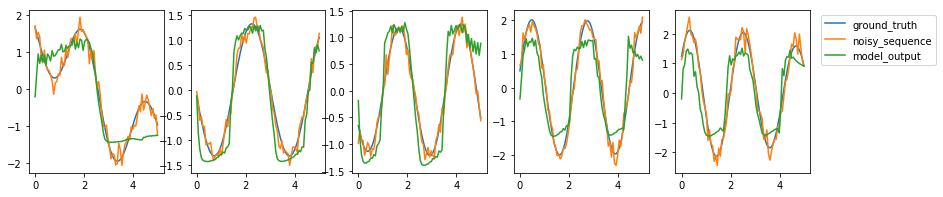

epoch: 8, validation loss:1987.9033203125


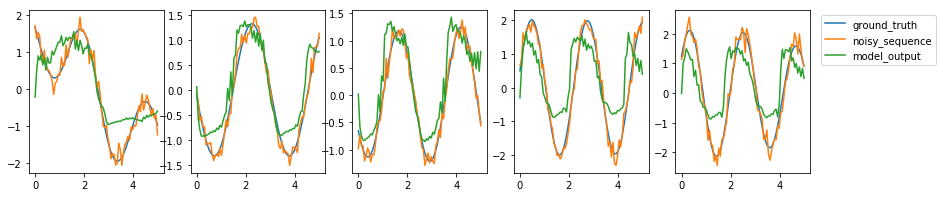

epoch: 9, validation loss:2391.505859375


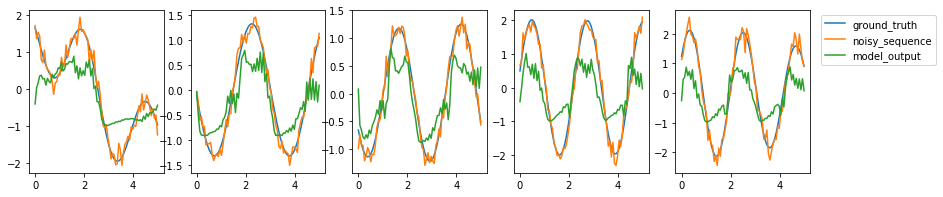

epoch: 10, validation loss:1771.9376220703125


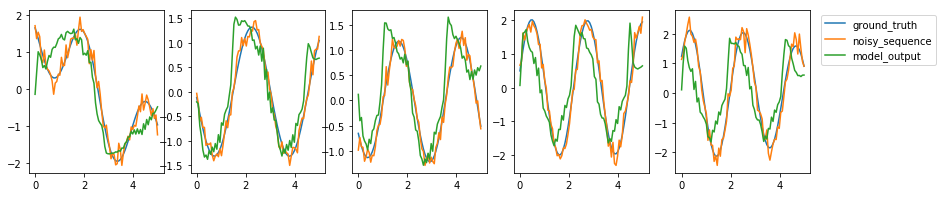

epoch: 11, validation loss:2032.363037109375


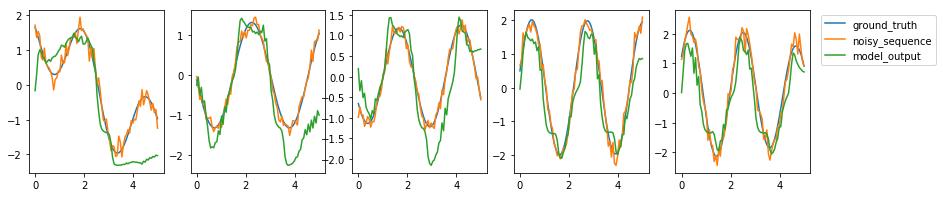

epoch: 12, validation loss:1057.102783203125


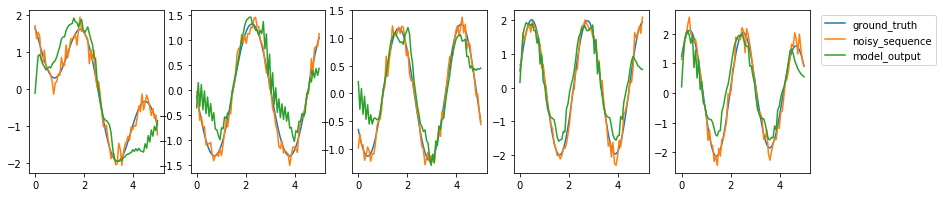

epoch: 13, validation loss:1083.38037109375


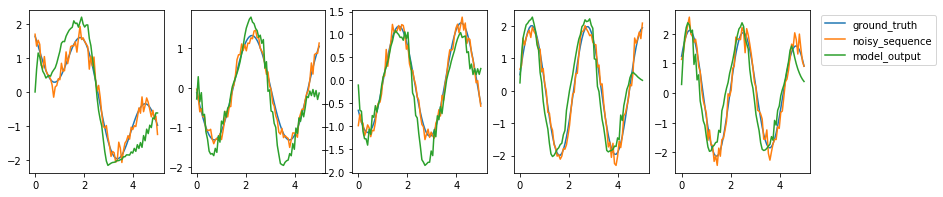

epoch: 14, validation loss:1061.053955078125


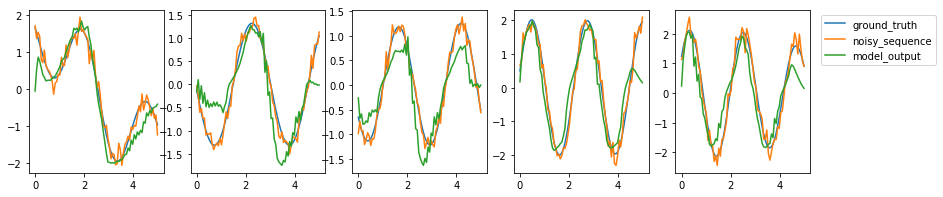

epoch: 15, validation loss:1097.4158935546875


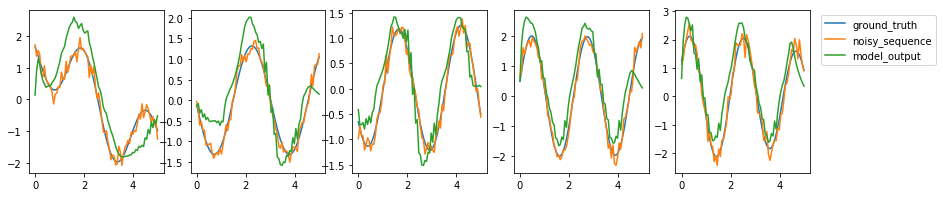

epoch: 16, validation loss:1302.628173828125


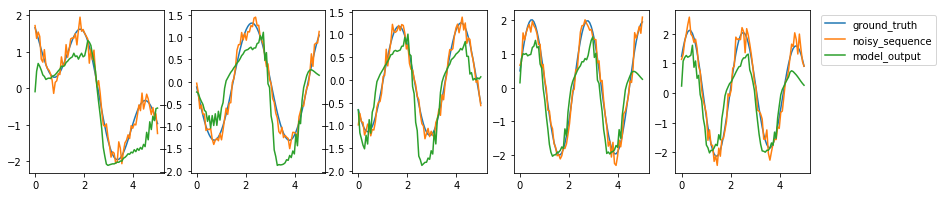

epoch: 17, validation loss:801.1044921875


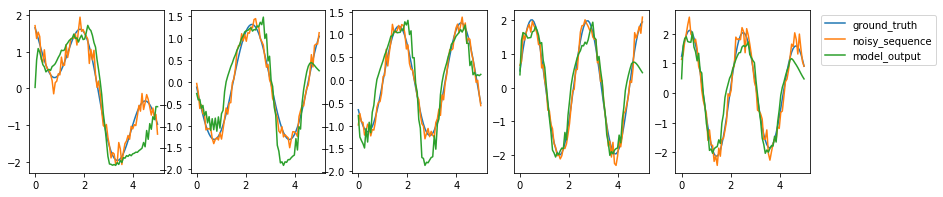

epoch: 18, validation loss:930.9172973632812


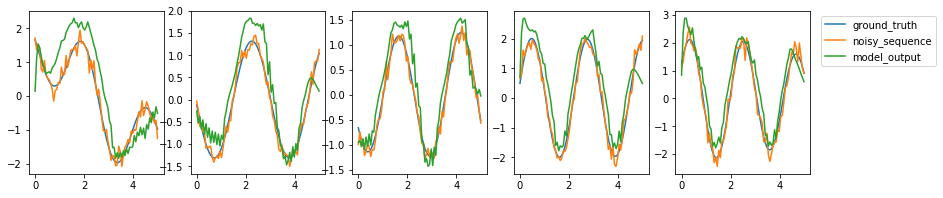

epoch: 19, validation loss:857.7894287109375


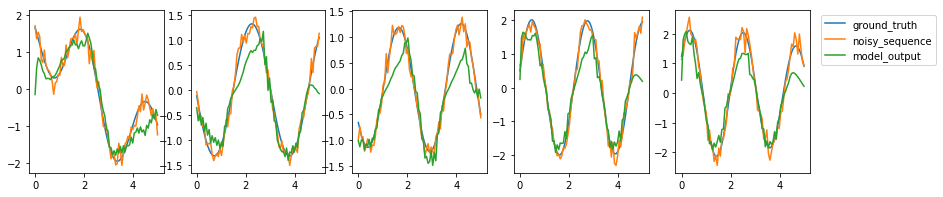

epoch: 20, validation loss:786.943603515625


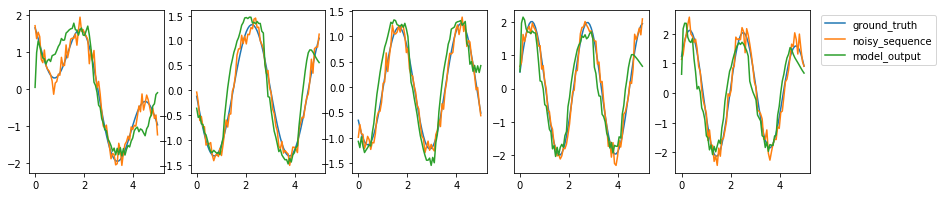

epoch: 21, validation loss:797.9872436523438


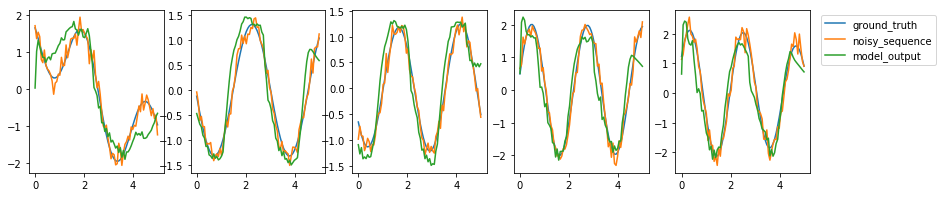

epoch: 22, validation loss:719.4782104492188


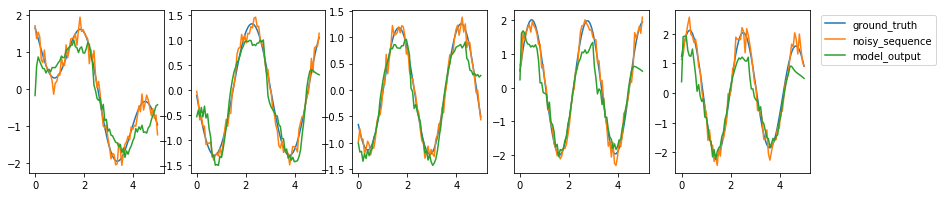

epoch: 23, validation loss:595.3848266601562


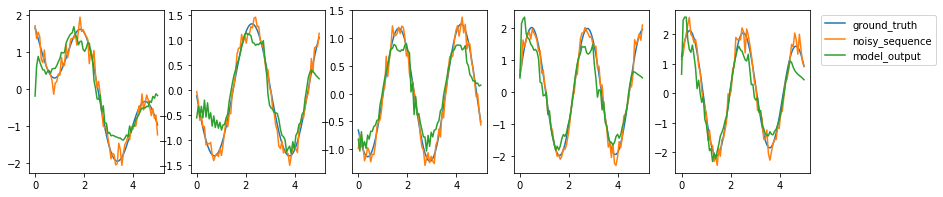

epoch: 24, validation loss:648.6597900390625


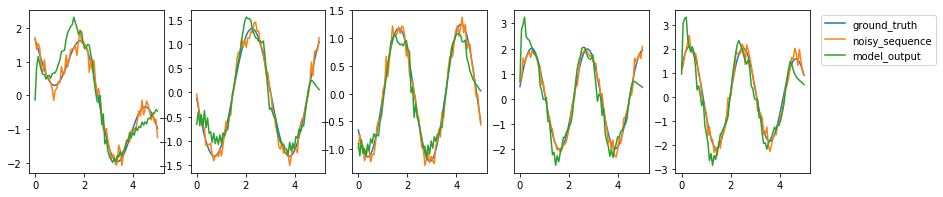

epoch: 25, validation loss:695.7216186523438


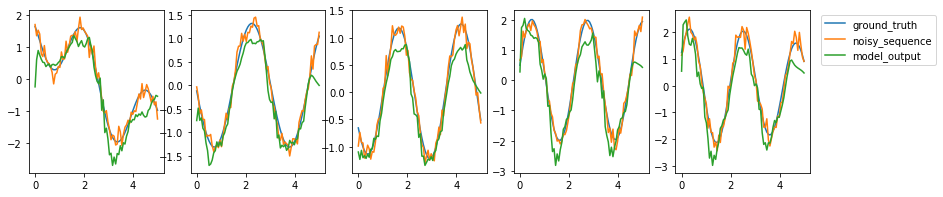

epoch: 26, validation loss:689.8682861328125


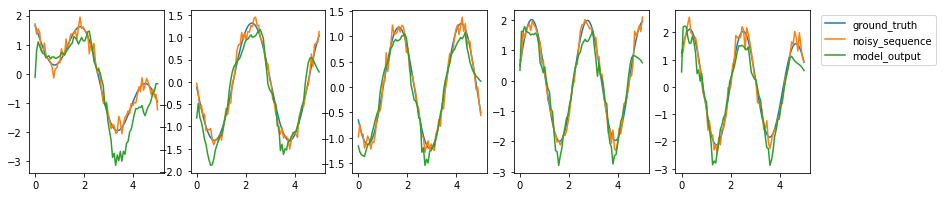

epoch: 27, validation loss:738.9071044921875


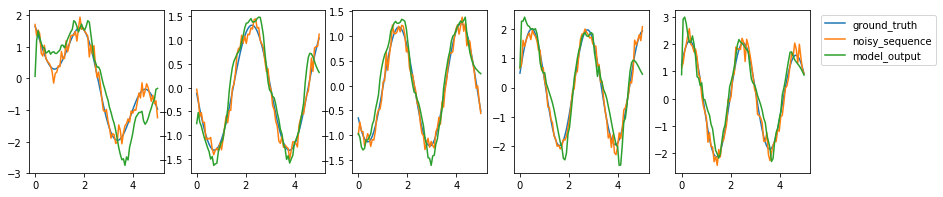

epoch: 28, validation loss:575.2330322265625


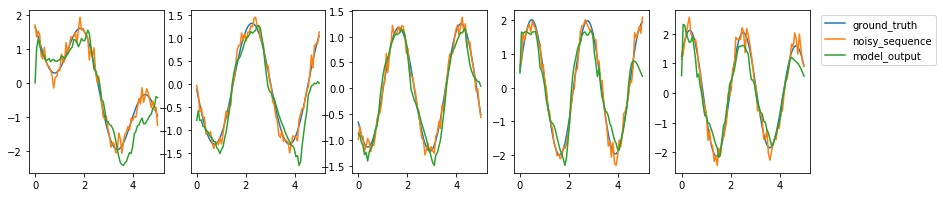

epoch: 29, validation loss:691.5154418945312


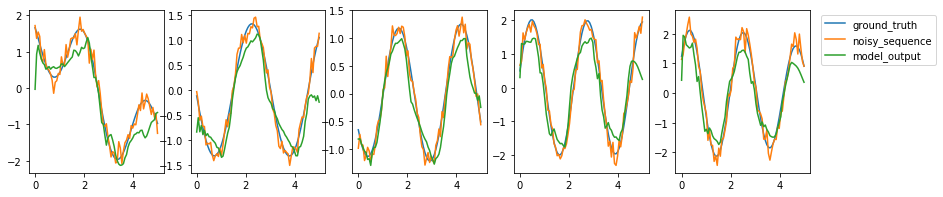

epoch: 30, validation loss:672.8607177734375


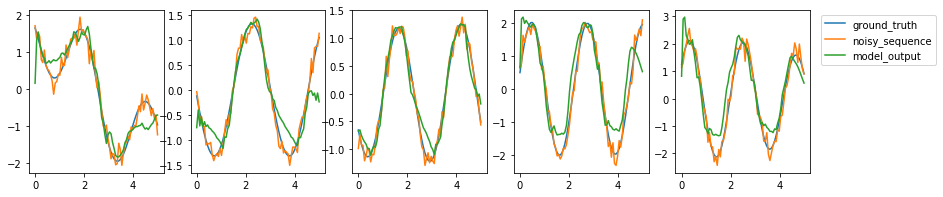

epoch: 31, validation loss:642.4508666992188


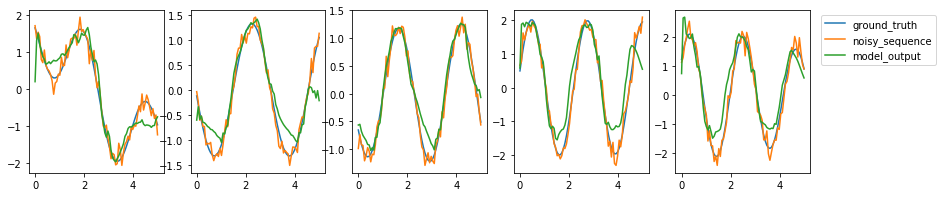

epoch: 32, validation loss:765.0042114257812


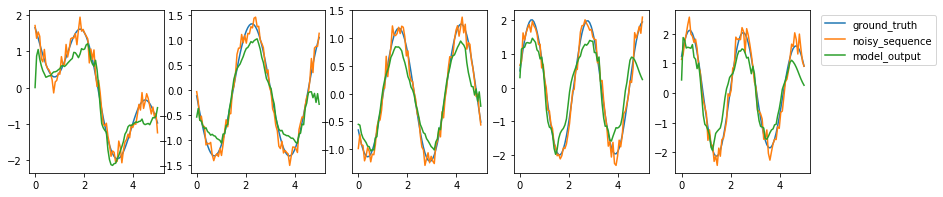

epoch: 33, validation loss:649.405517578125


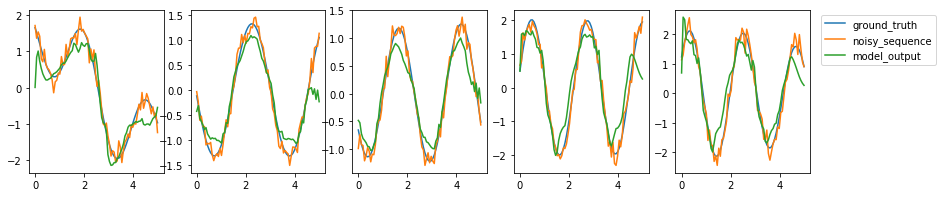

epoch: 34, validation loss:768.4618530273438


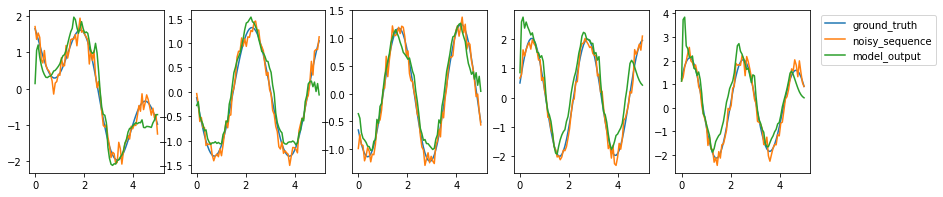

epoch: 35, validation loss:544.5005493164062


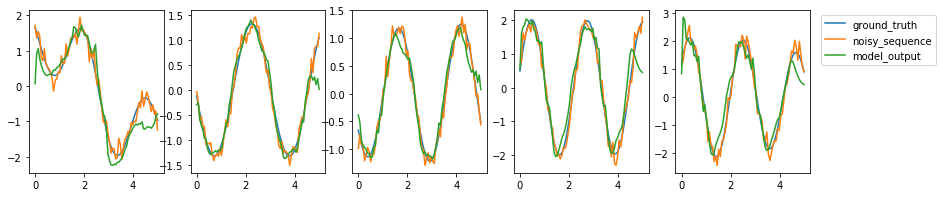

epoch: 36, validation loss:606.9508056640625


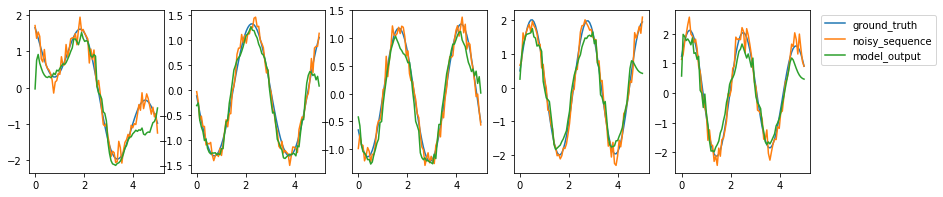

epoch: 37, validation loss:554.187255859375


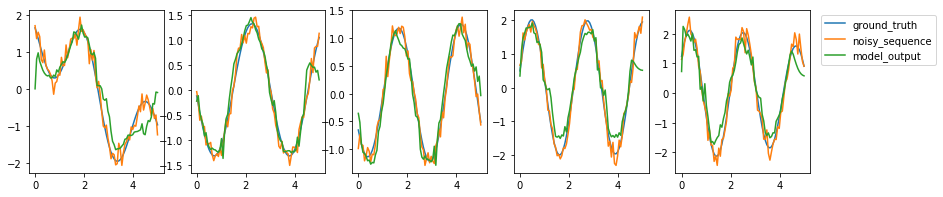

epoch: 38, validation loss:552.0032958984375


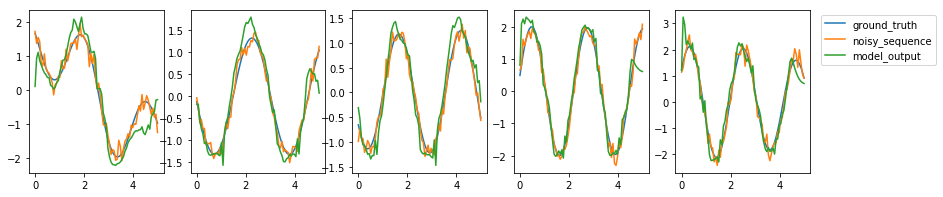

epoch: 39, validation loss:608.1827392578125


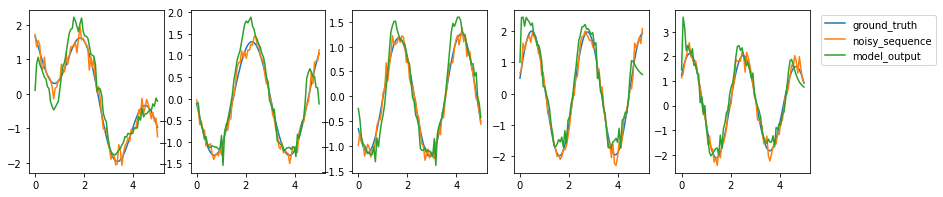

epoch: 40, validation loss:528.3479614257812


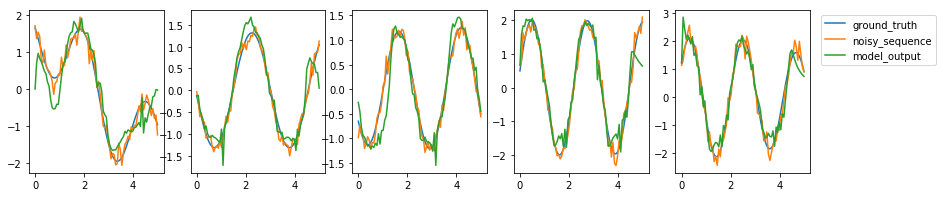

epoch: 41, validation loss:557.2957153320312


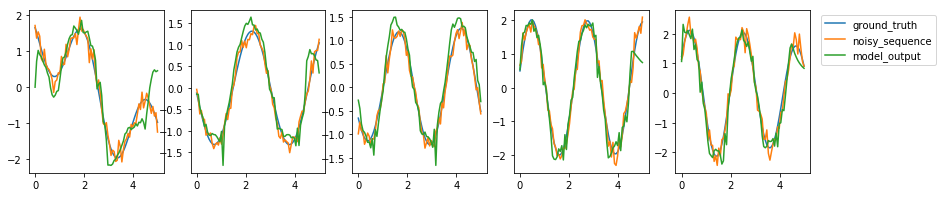

epoch: 42, validation loss:481.65167236328125


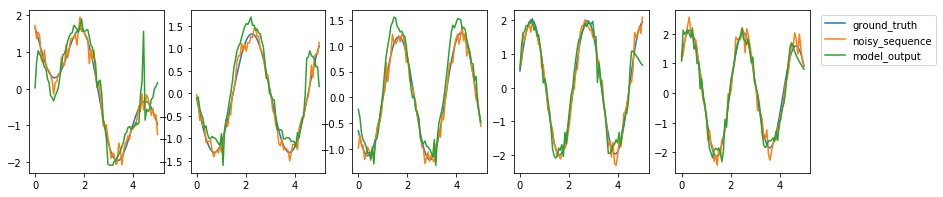

epoch: 43, validation loss:491.90509033203125


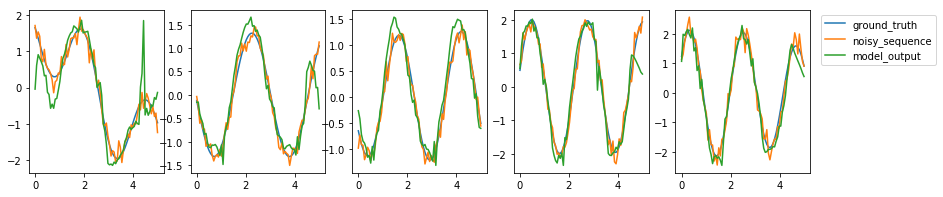

epoch: 44, validation loss:480.1068420410156


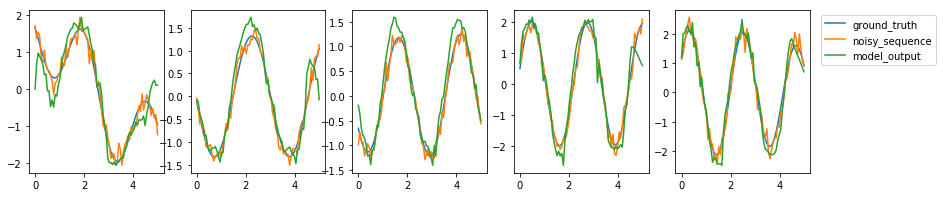

epoch: 45, validation loss:416.4696350097656


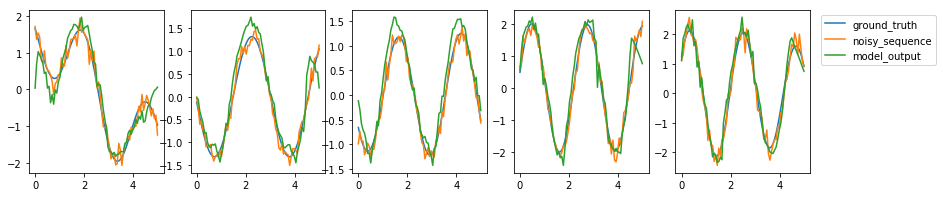

epoch: 46, validation loss:496.48150634765625


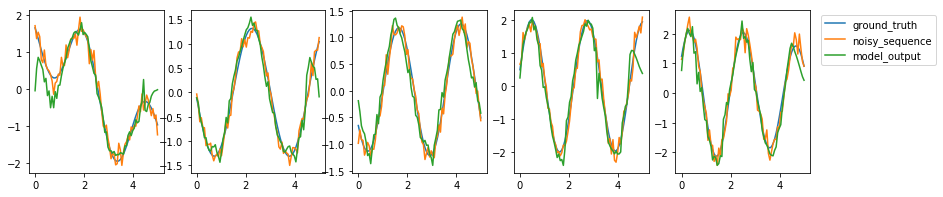

epoch: 47, validation loss:512.8698120117188


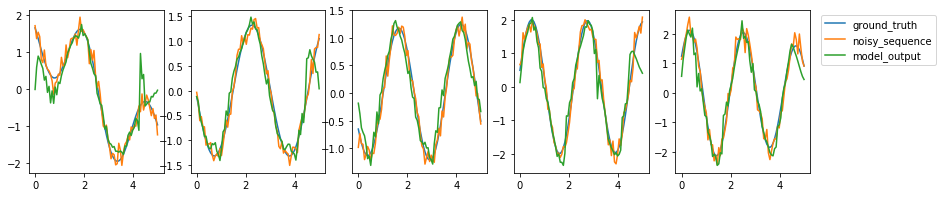

epoch: 48, validation loss:575.1328735351562


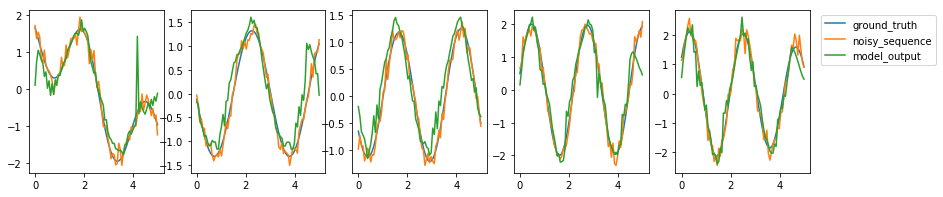

epoch: 49, validation loss:954.0377197265625


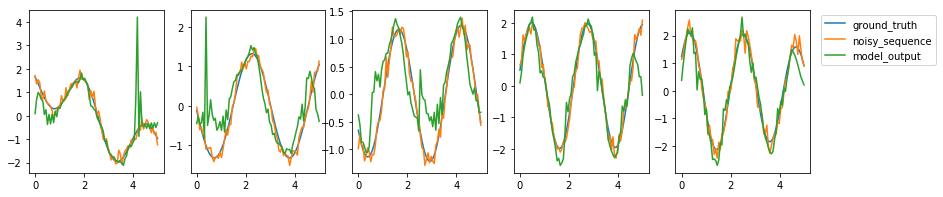

epoch: 50, validation loss:1563.685546875


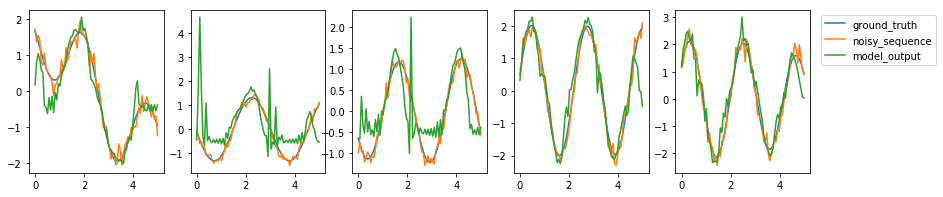

epoch: 51, validation loss:1373.37548828125


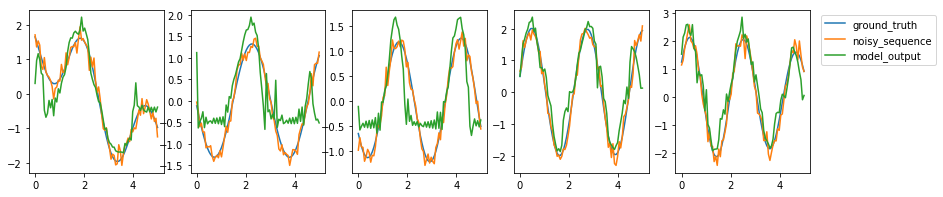

epoch: 52, validation loss:1271.11083984375


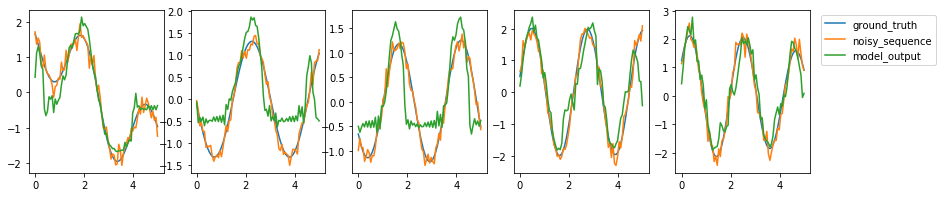

epoch: 53, validation loss:1207.6845703125


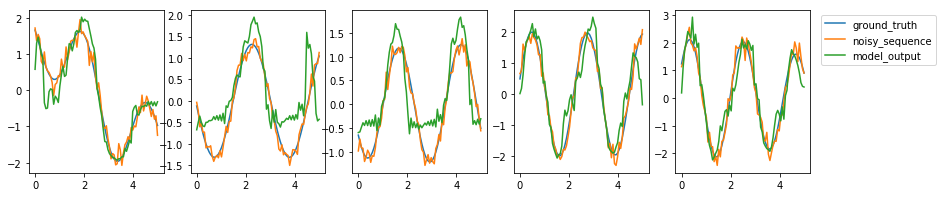

epoch: 54, validation loss:1144.2271728515625


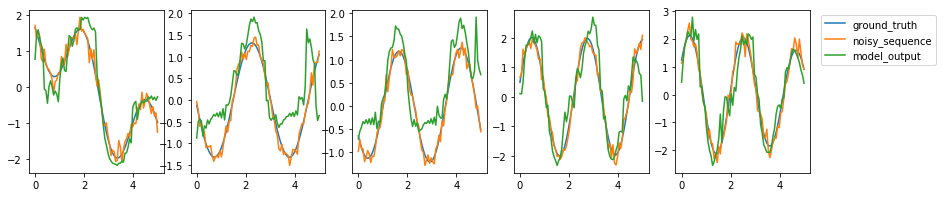

epoch: 55, validation loss:1034.448974609375


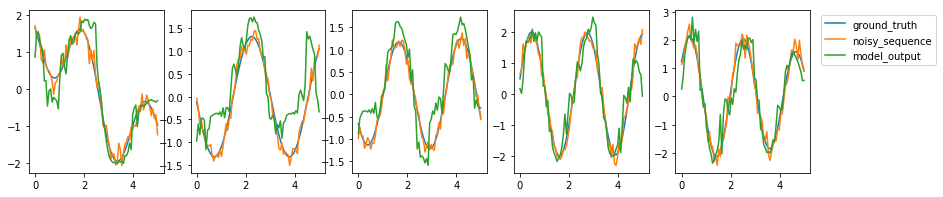

epoch: 56, validation loss:939.8197021484375


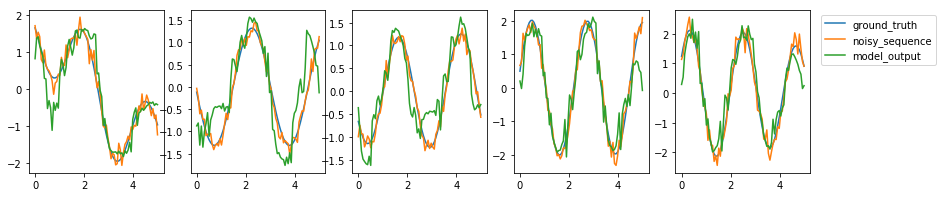

epoch: 57, validation loss:977.802978515625


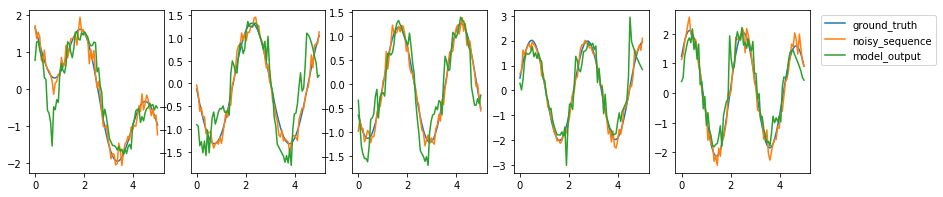

epoch: 58, validation loss:987.8275756835938


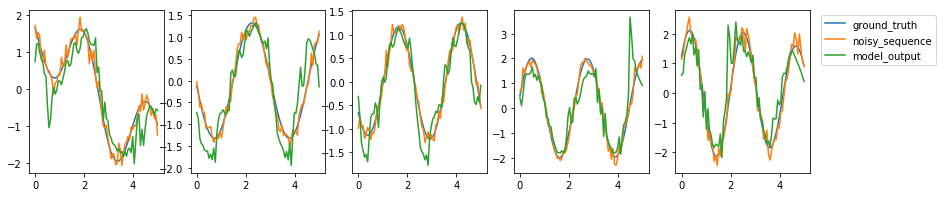

epoch: 59, validation loss:887.3250732421875


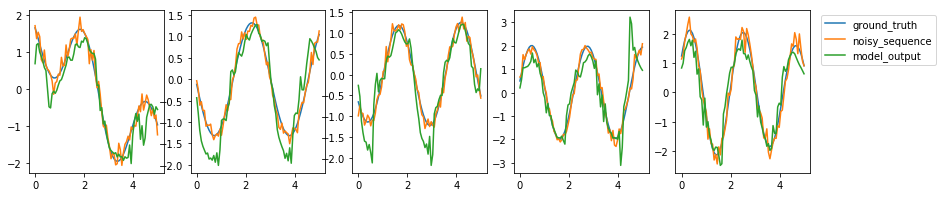

epoch: 60, validation loss:936.3651123046875


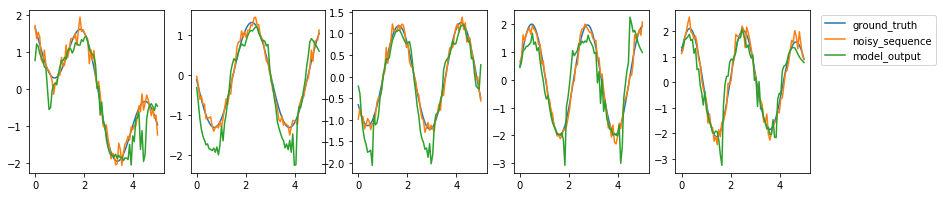

epoch: 61, validation loss:899.7587280273438


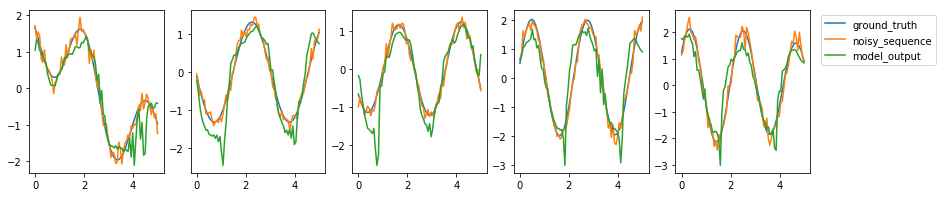

epoch: 62, validation loss:864.7164306640625


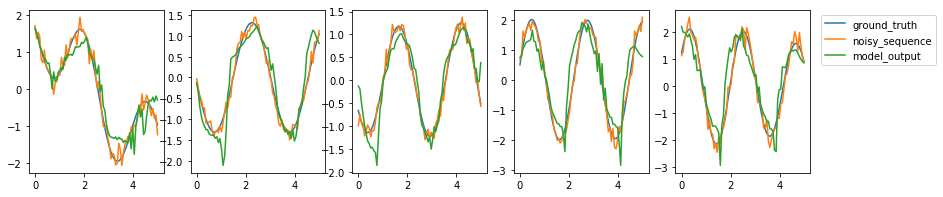

epoch: 63, validation loss:1145.6802978515625


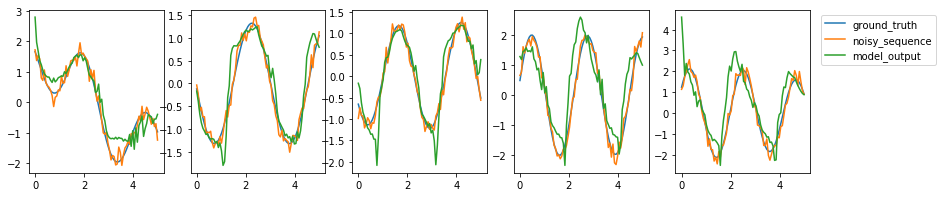

epoch: 64, validation loss:1093.5313720703125


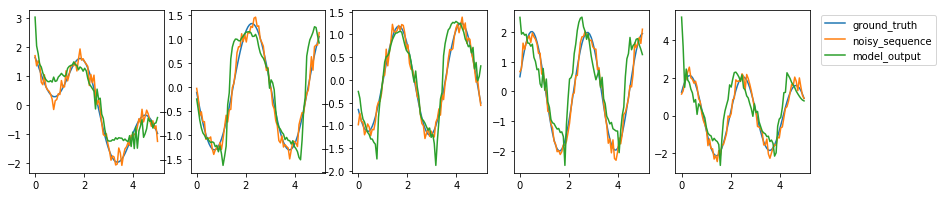

epoch: 65, validation loss:899.8773803710938


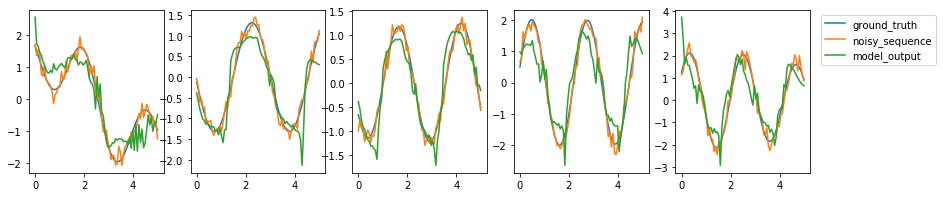

epoch: 66, validation loss:978.8984985351562


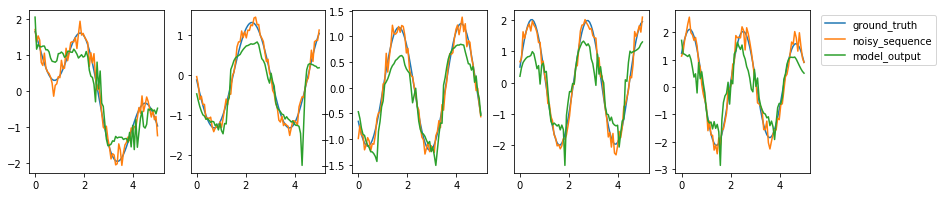

epoch: 67, validation loss:1085.501220703125


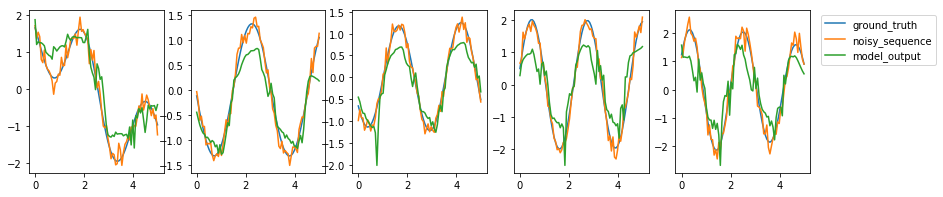

epoch: 68, validation loss:1124.935302734375


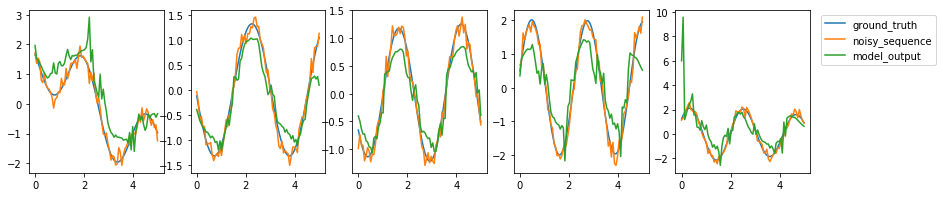

epoch: 69, validation loss:1075.690673828125


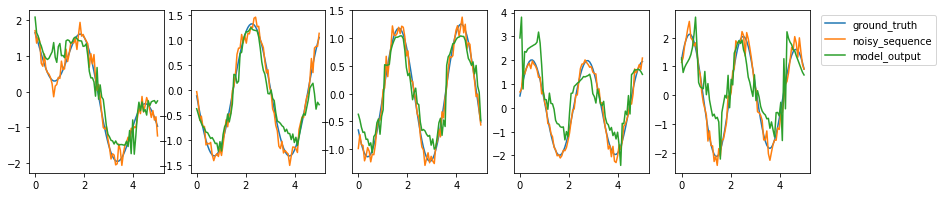

epoch: 70, validation loss:1058.318603515625


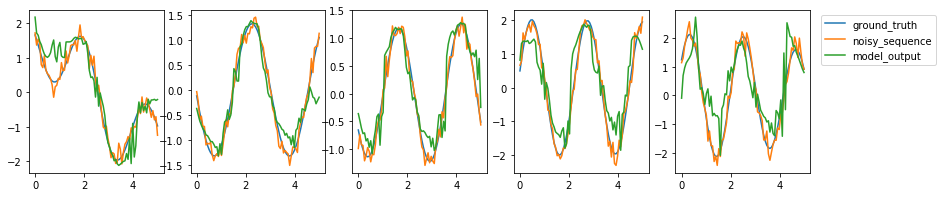

epoch: 71, validation loss:1271.8941650390625


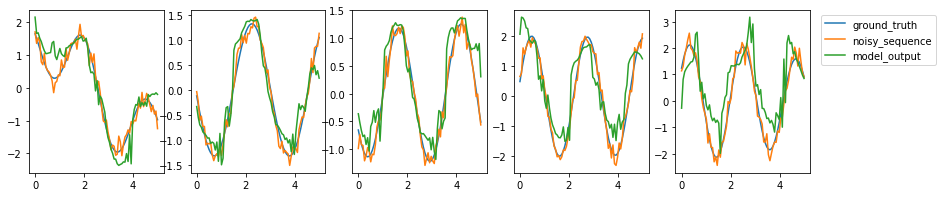

epoch: 72, validation loss:1763.3839111328125


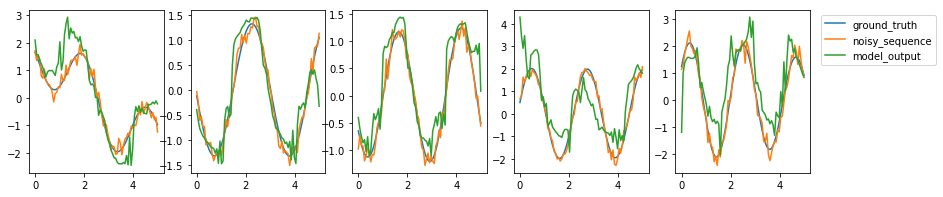

epoch: 73, validation loss:2190.8466796875


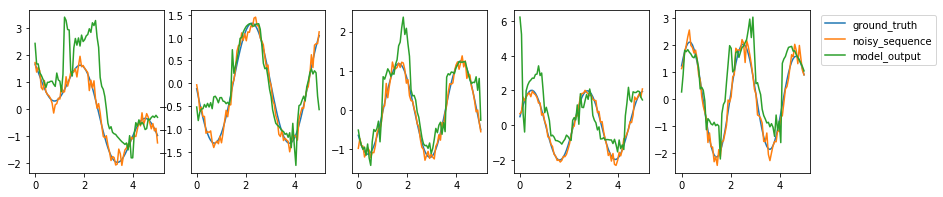

epoch: 74, validation loss:1873.8448486328125


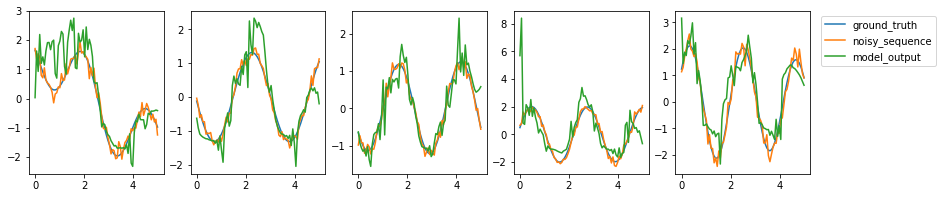

epoch: 75, validation loss:1697.0093994140625


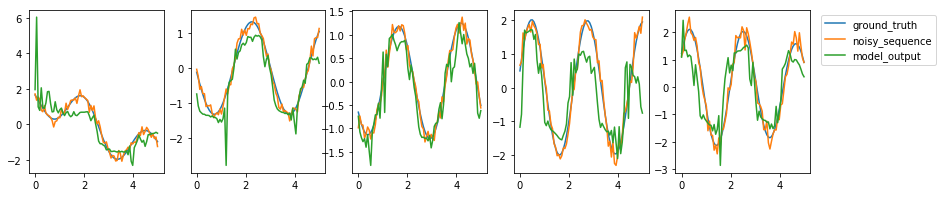

epoch: 76, validation loss:1873.9508056640625


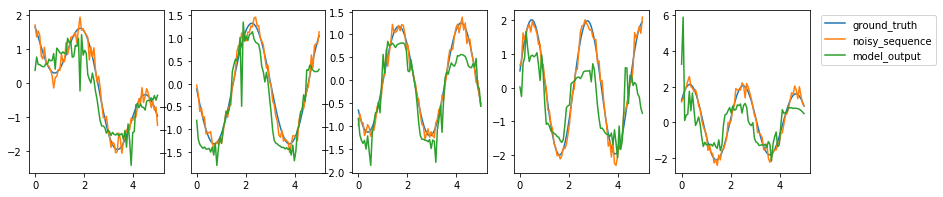

epoch: 77, validation loss:1757.3089599609375


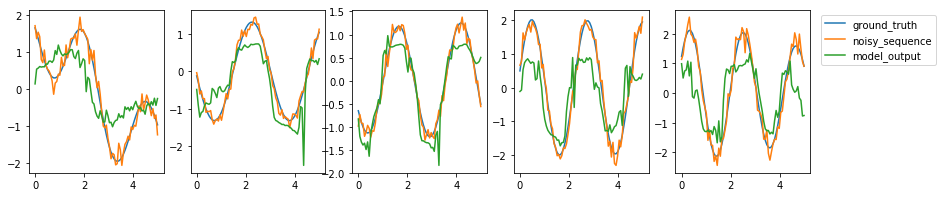

epoch: 78, validation loss:1592.9190673828125


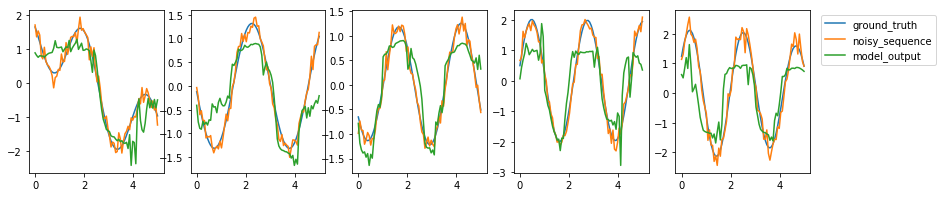

epoch: 79, validation loss:1680.967529296875


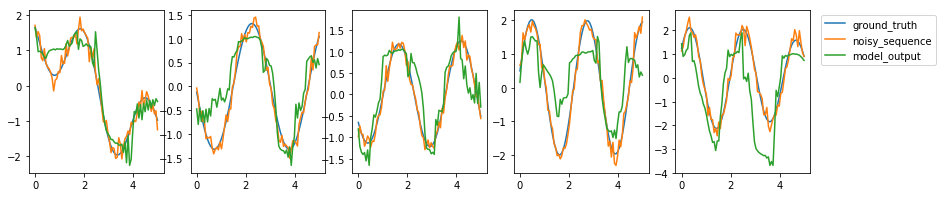

epoch: 80, validation loss:2025.55810546875


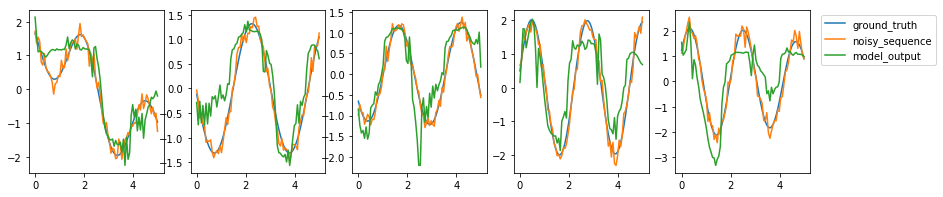

epoch: 81, validation loss:2194.4921875


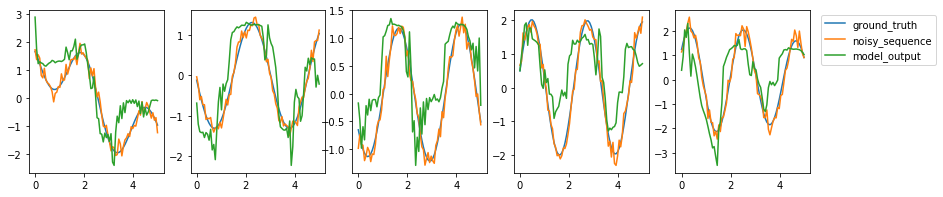

epoch: 82, validation loss:2554.1298828125


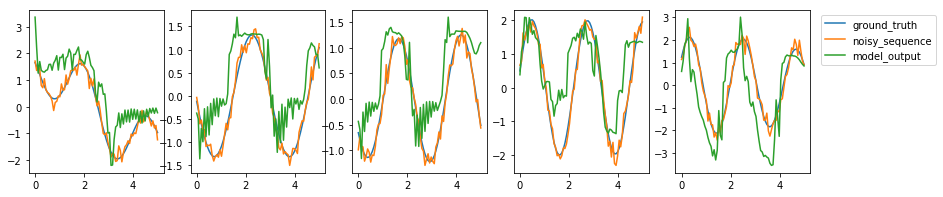

epoch: 83, validation loss:2474.531494140625


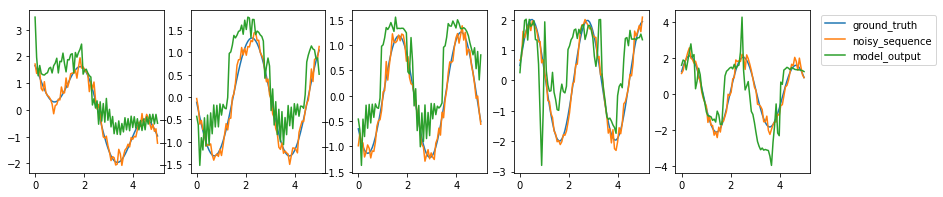

epoch: 84, validation loss:2387.466552734375


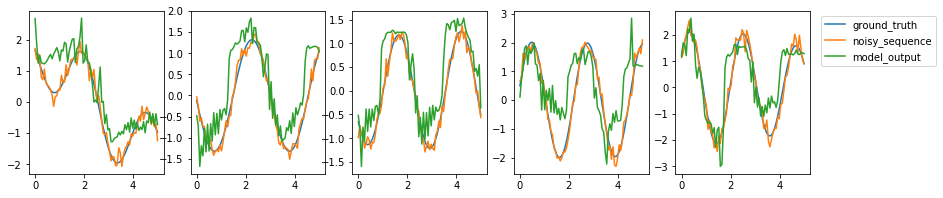

epoch: 85, validation loss:2436.425537109375


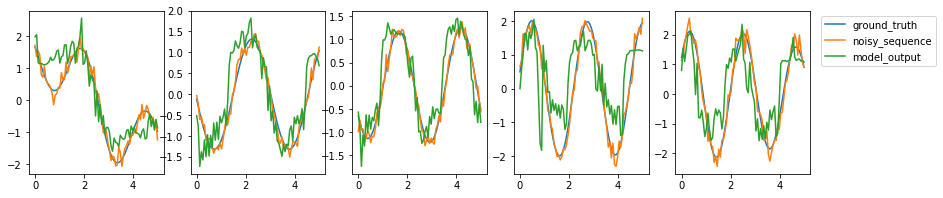

epoch: 86, validation loss:2622.445068359375


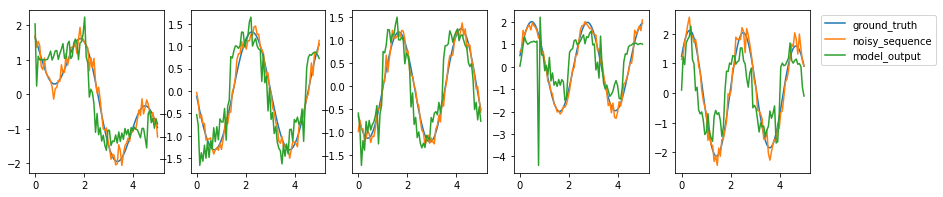

epoch: 87, validation loss:2451.44580078125


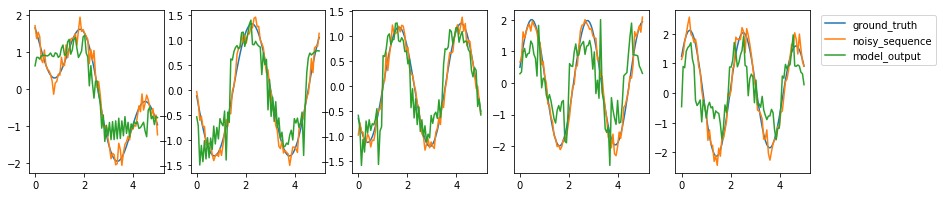

epoch: 88, validation loss:2501.1845703125


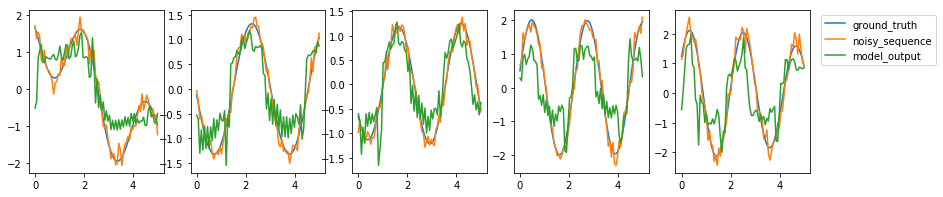

epoch: 89, validation loss:2536.5947265625


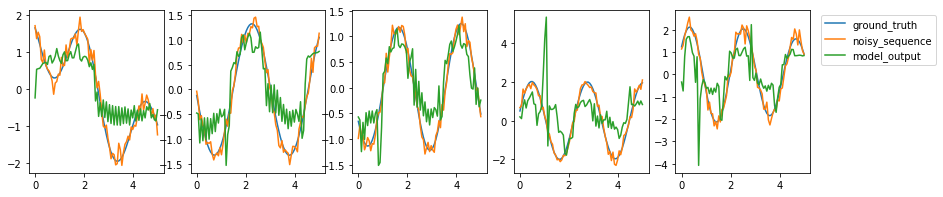

epoch: 90, validation loss:2576.00146484375


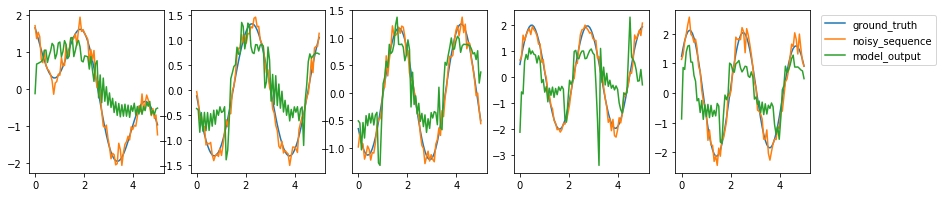

epoch: 91, validation loss:2847.39599609375


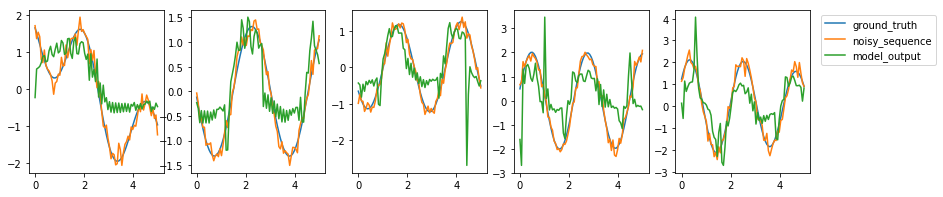

epoch: 92, validation loss:2590.22705078125


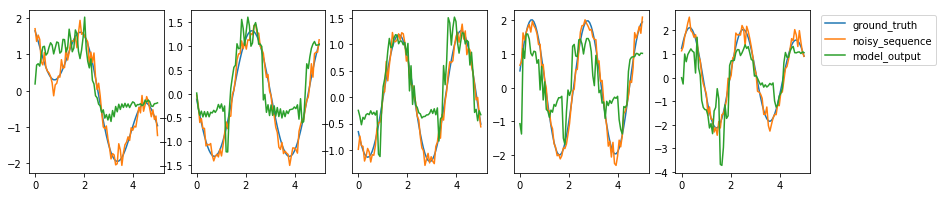

epoch: 93, validation loss:2789.373046875


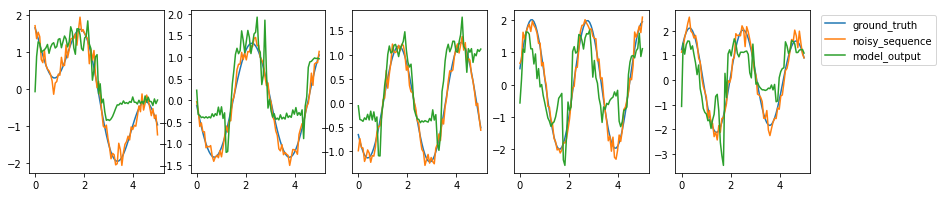

epoch: 94, validation loss:2567.916259765625


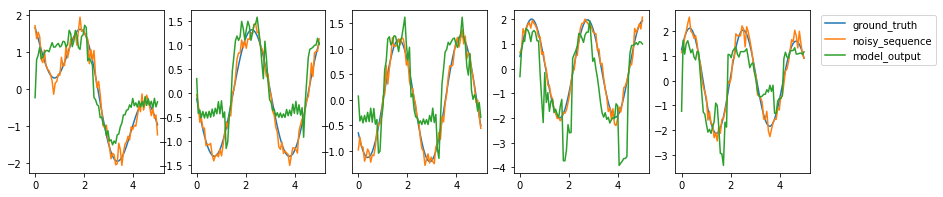

epoch: 95, validation loss:2383.6318359375


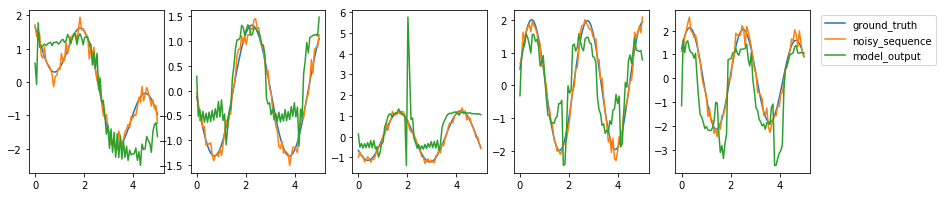

epoch: 96, validation loss:2036.13623046875


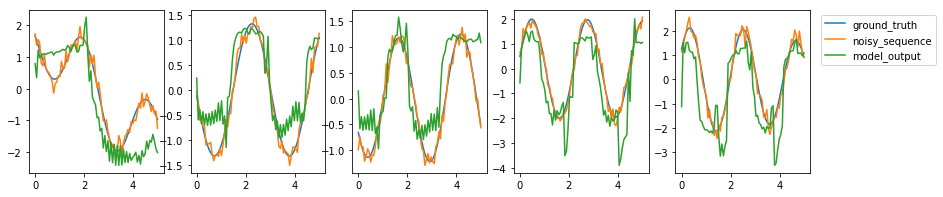

epoch: 97, validation loss:2056.54443359375


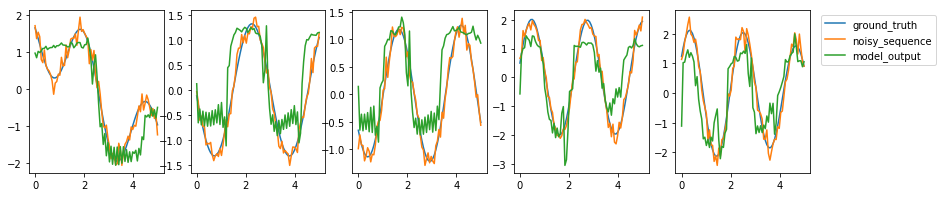

epoch: 98, validation loss:2115.390625


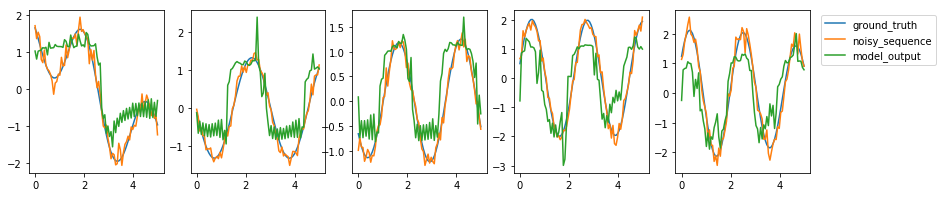

epoch: 99, validation loss:2702.36669921875


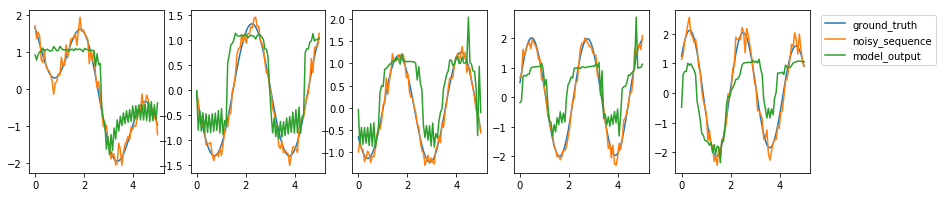

epoch: 100, validation loss:3201.18603515625


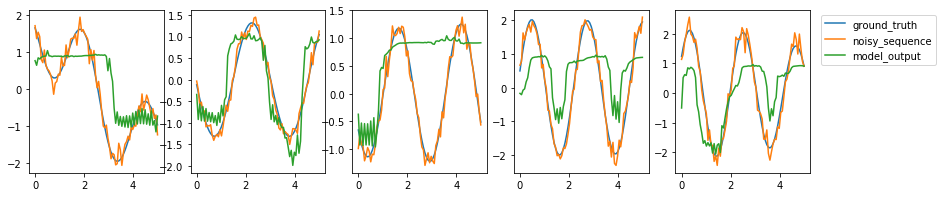

In [9]:
batch_size = 20
num_epochs = 101

model = NoiseRemovalModel(hidden_size=40, shift=10)
optimizer = optim.Adam(model.parameters(), lr=0.005, betas=(0.6, 0.87))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
print("cuda avialable :", torch.cuda.is_available())
# this should remove ~32% of the noise
train(model, optimizer, scheduler, num_epochs, batch_size)

## Hyperparameter Optimization
As a preparation for next week's lecture, play with the model's hyperparameters and try to improve the amount of noise removed. List at least three different configurations you have tried and the respective percentage of noise removed. Make sure to always create a new model and that you train and validate on the same data!

| configuration        | Noise removed in percent |
| -------------------- | --------------------------: |
| initial configuration| 32.52%               |

cuda avialable : False
epoch: 0, validation loss:4328.60107421875


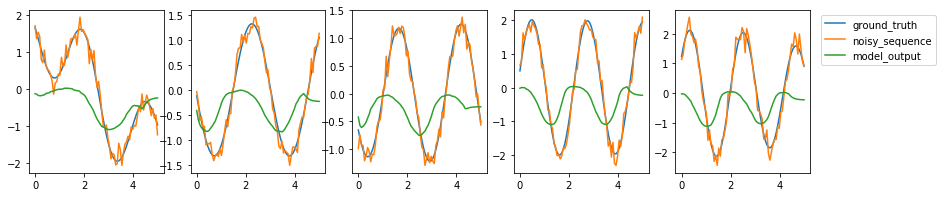

epoch: 1, validation loss:5665.20068359375


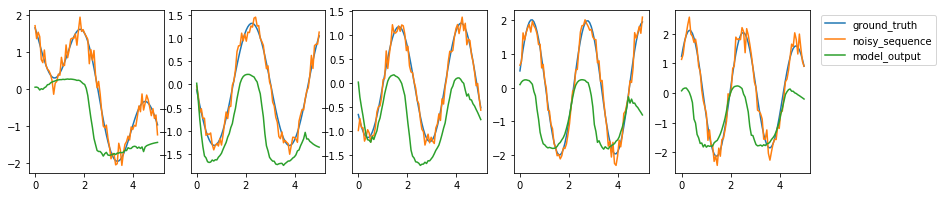

epoch: 2, validation loss:2432.9765625


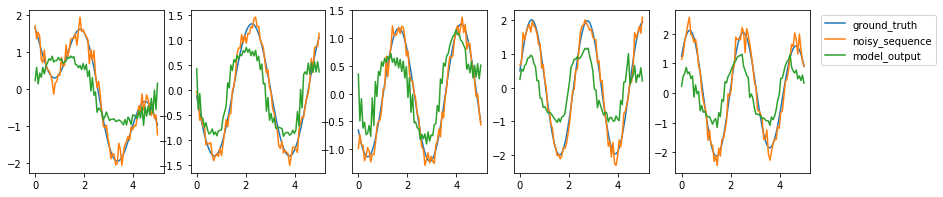

epoch: 3, validation loss:2460.339111328125


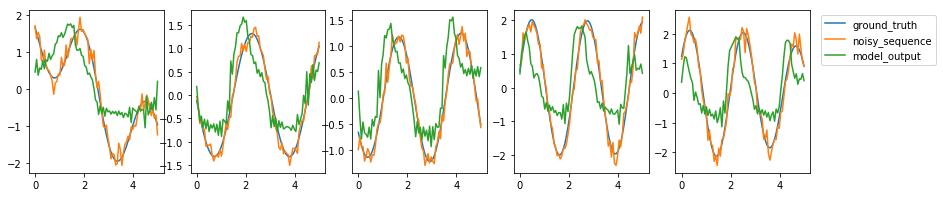

epoch: 4, validation loss:2116.70361328125


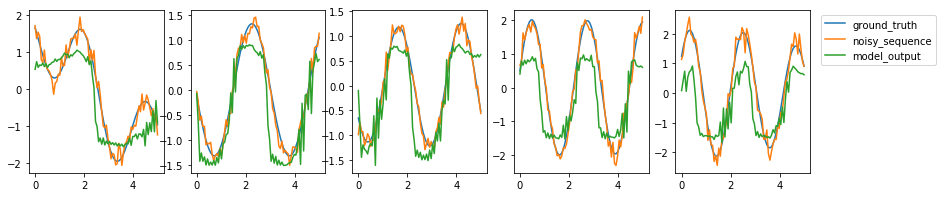

epoch: 5, validation loss:1742.774169921875


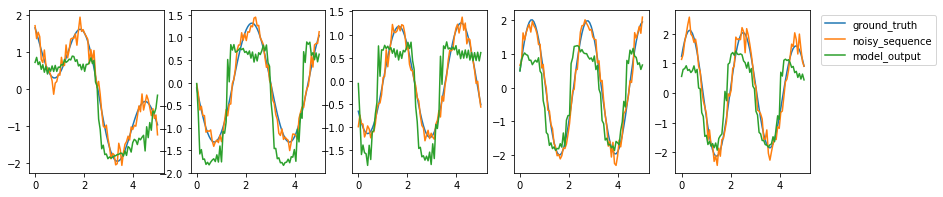

epoch: 6, validation loss:1565.17626953125


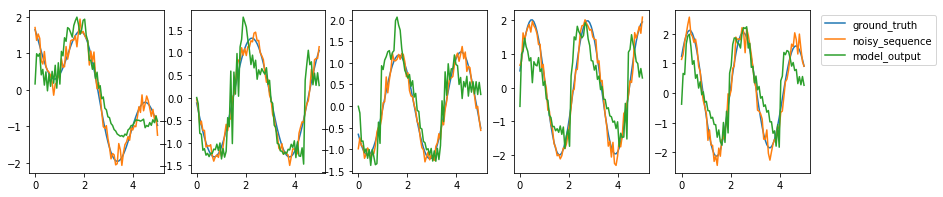

epoch: 7, validation loss:2340.61767578125


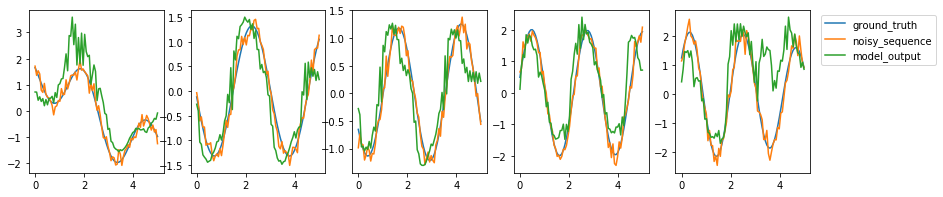

epoch: 8, validation loss:5195.53857421875


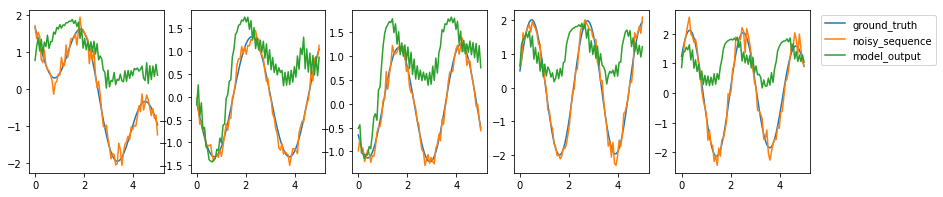

epoch: 9, validation loss:4154.5009765625


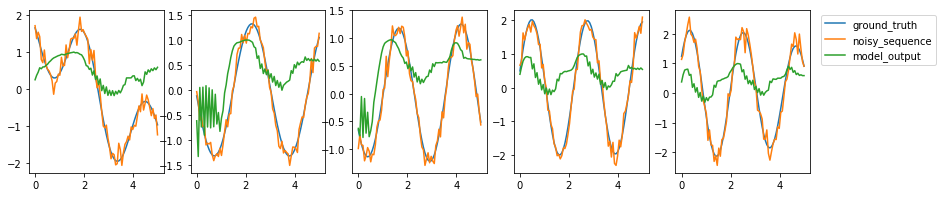

epoch: 10, validation loss:5318.89111328125


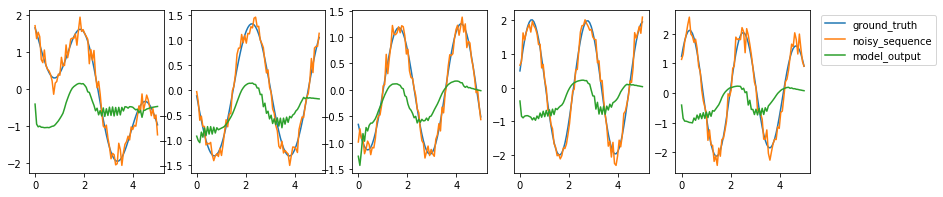

epoch: 11, validation loss:4771.806640625


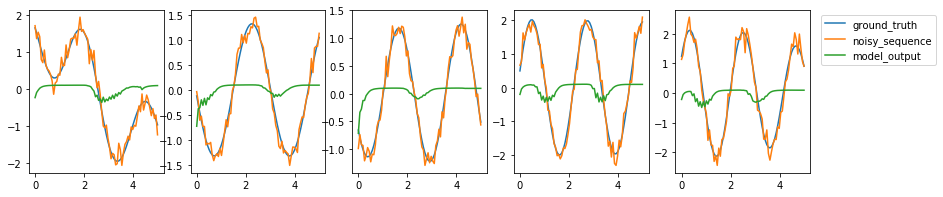

epoch: 12, validation loss:5415.7041015625


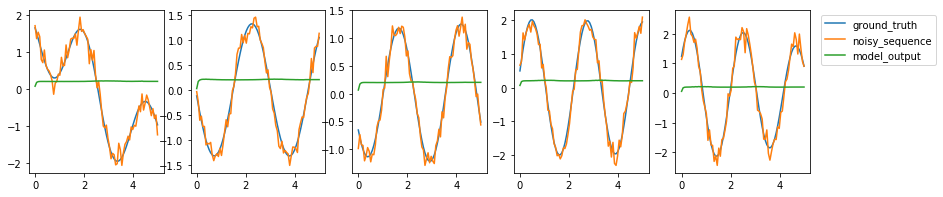

epoch: 13, validation loss:5329.08349609375


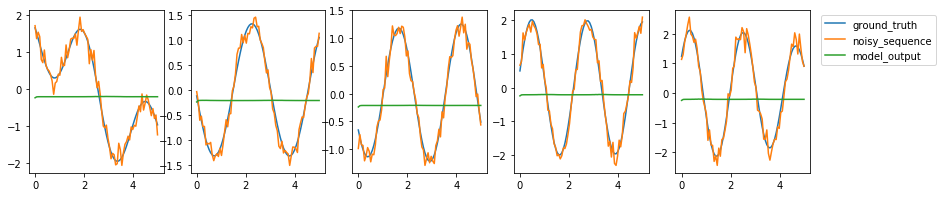

epoch: 14, validation loss:5309.79296875


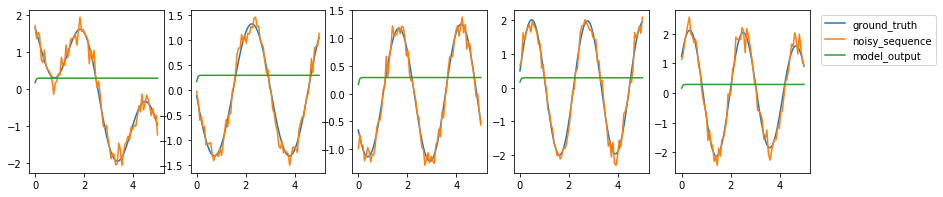

epoch: 15, validation loss:5083.7412109375


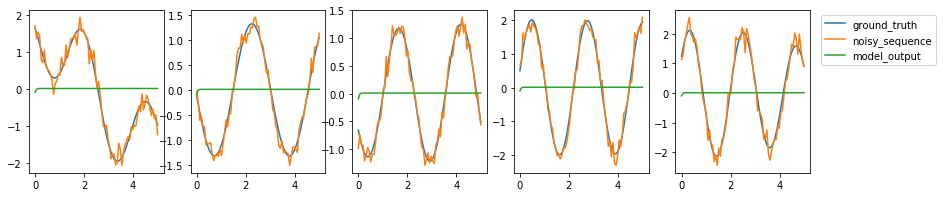

epoch: 16, validation loss:5324.666015625


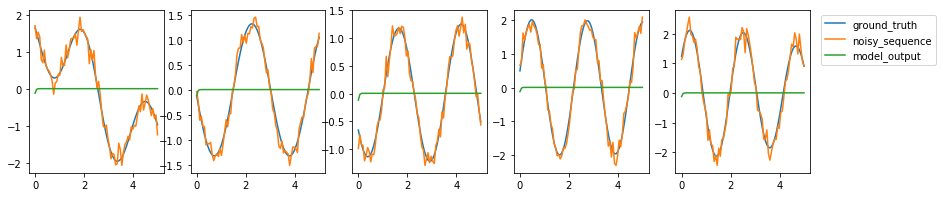

epoch: 17, validation loss:5844.15185546875


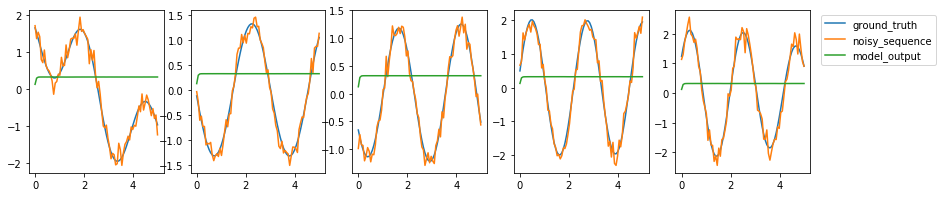

epoch: 18, validation loss:5632.7744140625


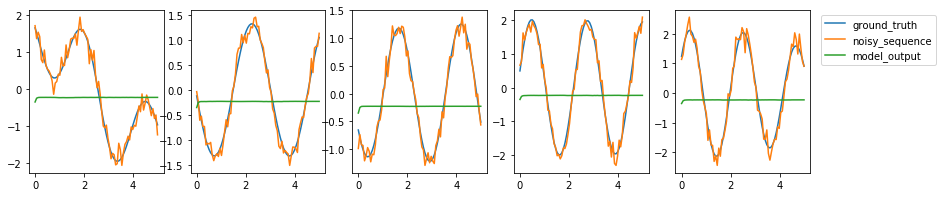

epoch: 19, validation loss:5448.5849609375


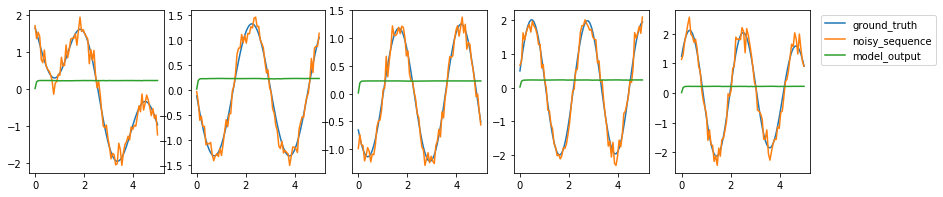

epoch: 20, validation loss:5305.9892578125


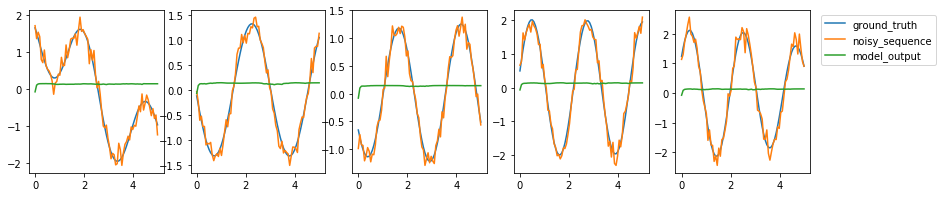

epoch: 21, validation loss:5361.95751953125


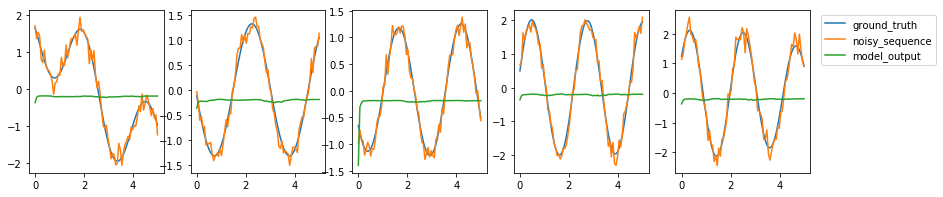

epoch: 22, validation loss:5741.71240234375


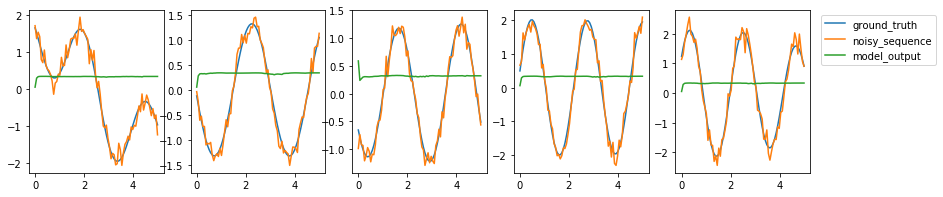

epoch: 23, validation loss:5279.85205078125


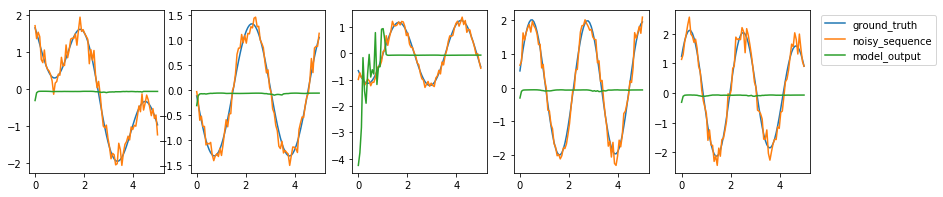

epoch: 24, validation loss:5232.3974609375


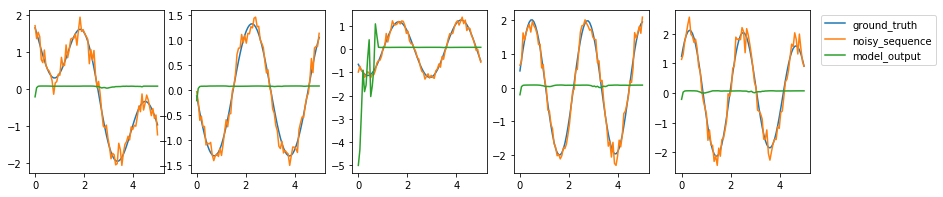

epoch: 25, validation loss:5682.525390625


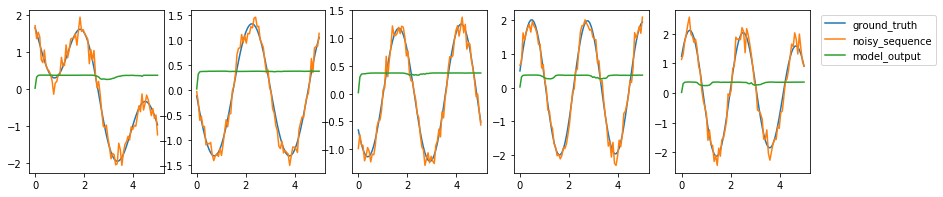

epoch: 26, validation loss:5532.662109375


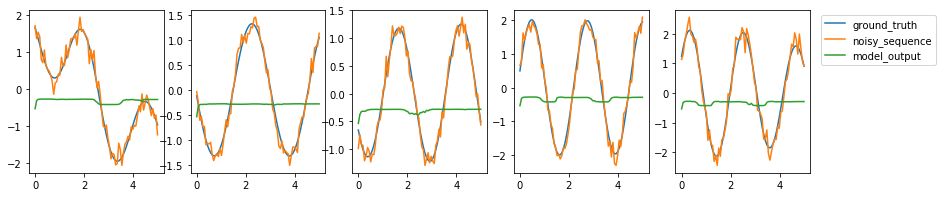

epoch: 27, validation loss:5157.5361328125


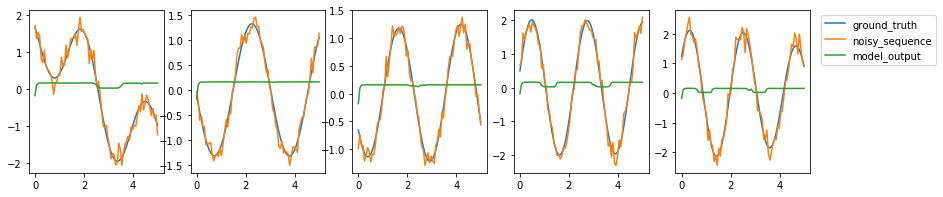

epoch: 28, validation loss:5481.55859375


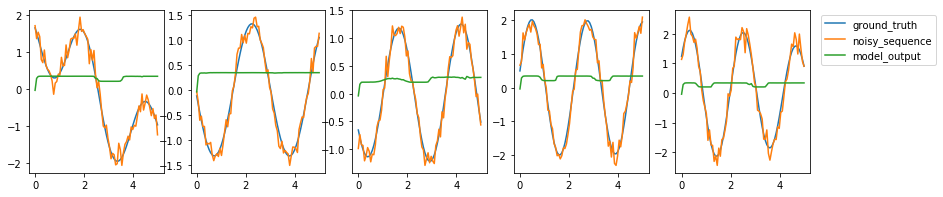

epoch: 29, validation loss:5606.96630859375


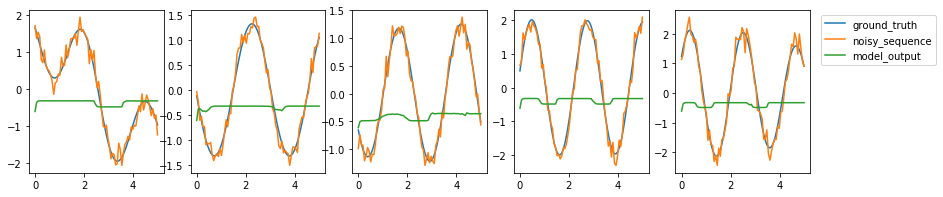

epoch: 30, validation loss:5139.177734375


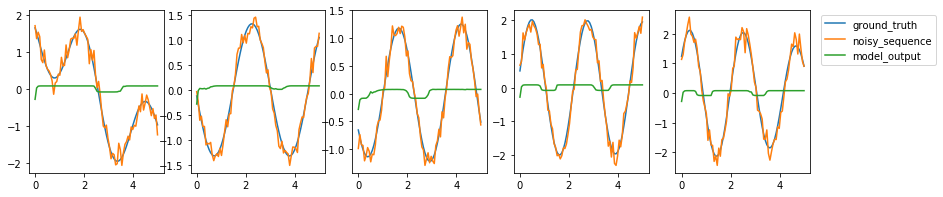

epoch: 31, validation loss:5753.69873046875


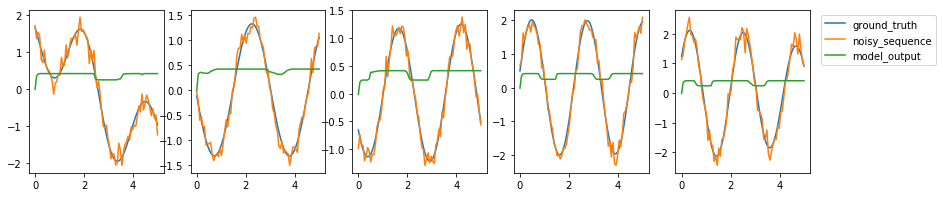

epoch: 32, validation loss:5312.125


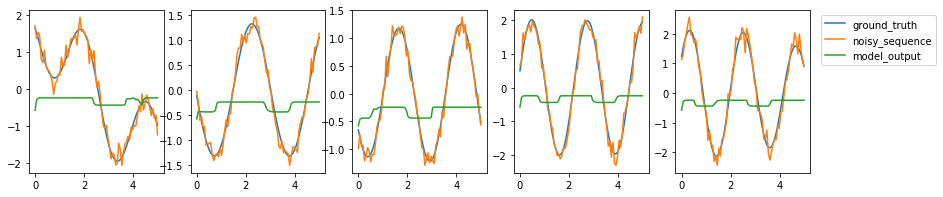

epoch: 33, validation loss:4982.99853515625


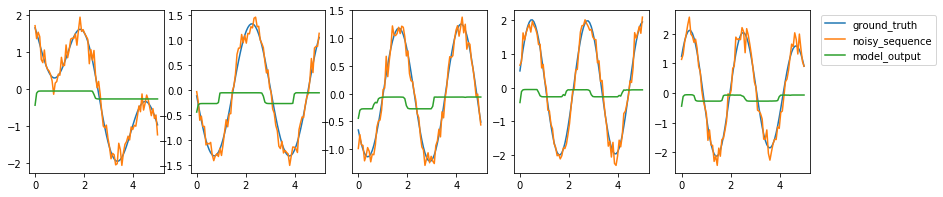

epoch: 34, validation loss:5479.4443359375


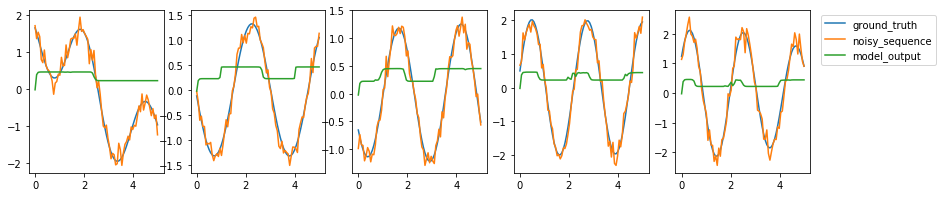

epoch: 35, validation loss:4865.37109375


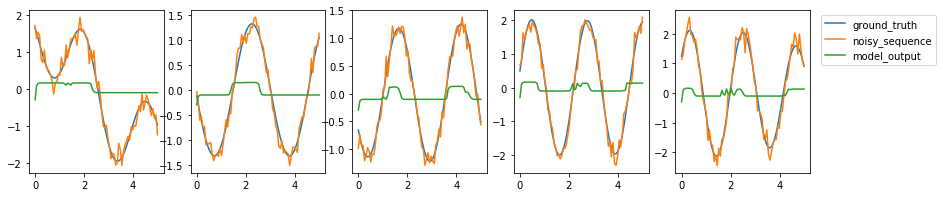

epoch: 36, validation loss:5171.591796875


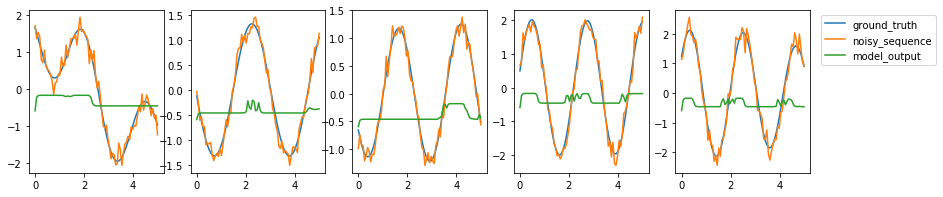

epoch: 37, validation loss:4957.7626953125


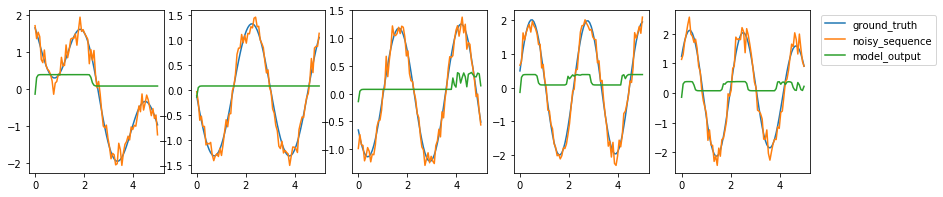

epoch: 38, validation loss:4947.19580078125


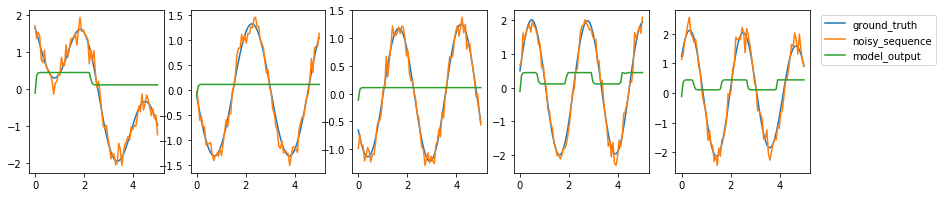

epoch: 39, validation loss:5076.9931640625


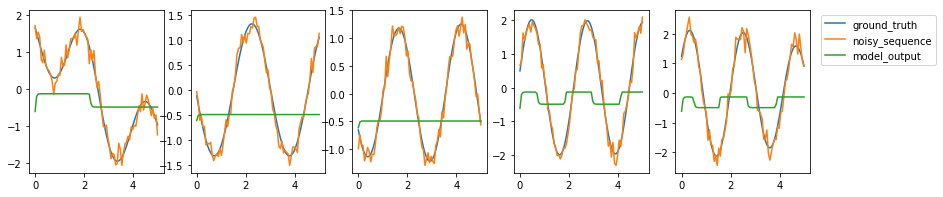

epoch: 40, validation loss:4689.36572265625


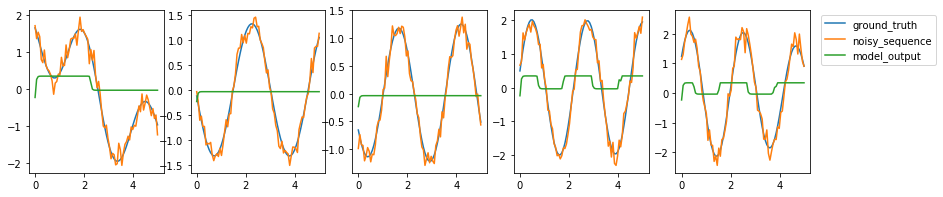

epoch: 41, validation loss:5324.58154296875


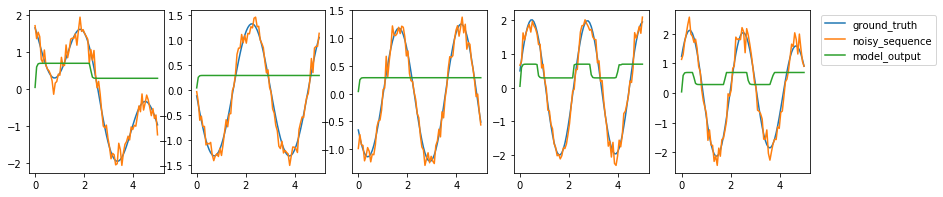

epoch: 42, validation loss:4809.34375


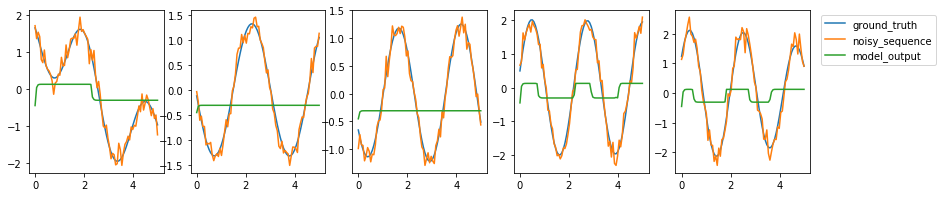

epoch: 43, validation loss:4675.85009765625


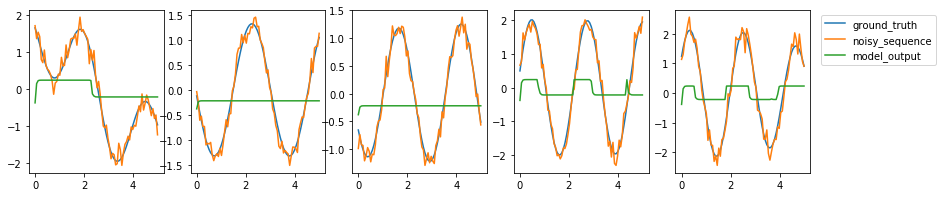

epoch: 44, validation loss:5226.47216796875


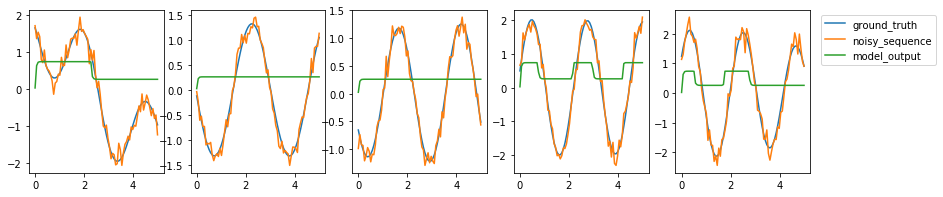

epoch: 45, validation loss:4610.83056640625


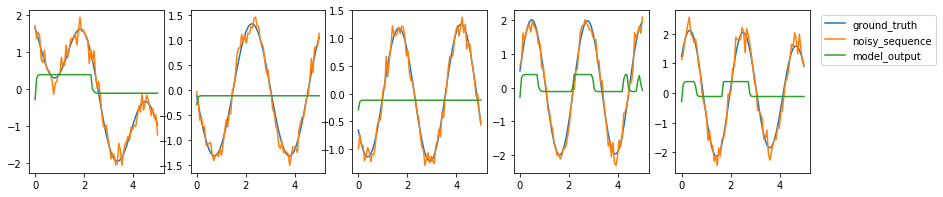

epoch: 46, validation loss:4815.21728515625


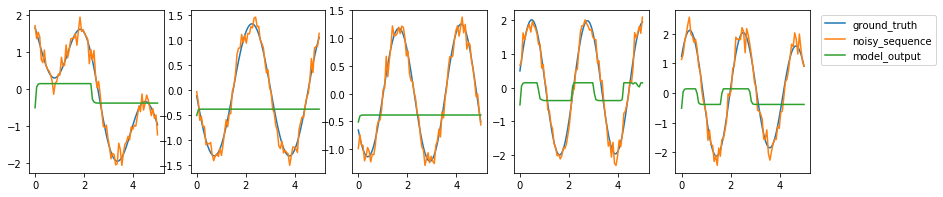

epoch: 47, validation loss:4839.20458984375


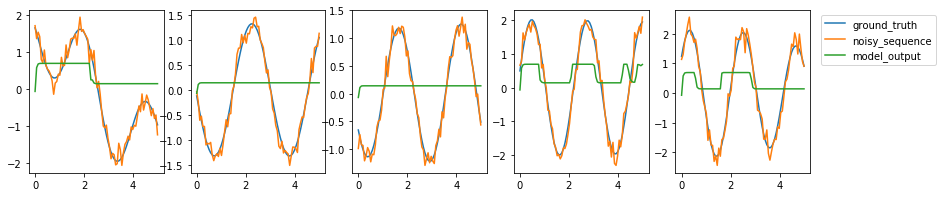

epoch: 48, validation loss:4469.40771484375


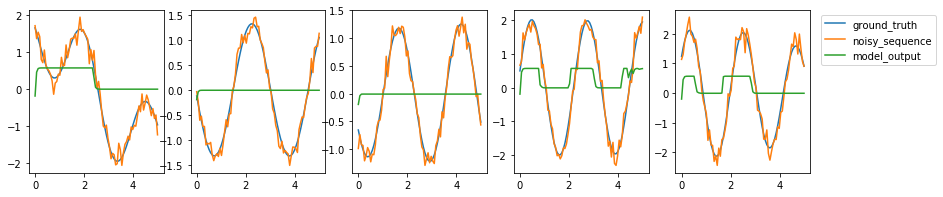

epoch: 49, validation loss:4849.23095703125


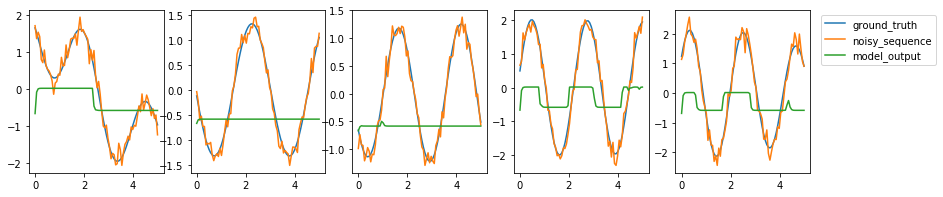

epoch: 50, validation loss:4593.31494140625


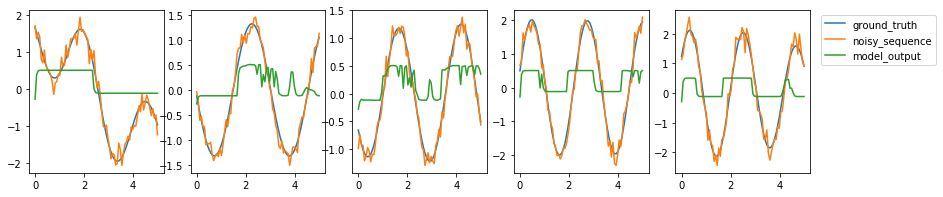

epoch: 51, validation loss:6049.17578125


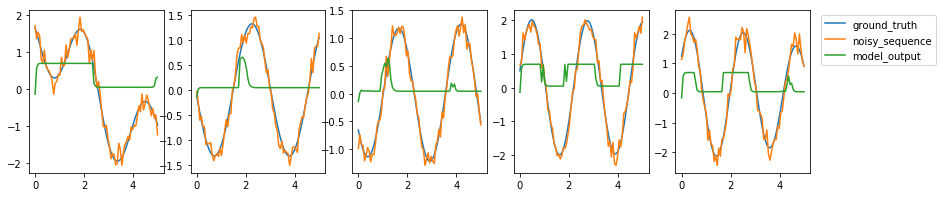

epoch: 52, validation loss:11959.10546875


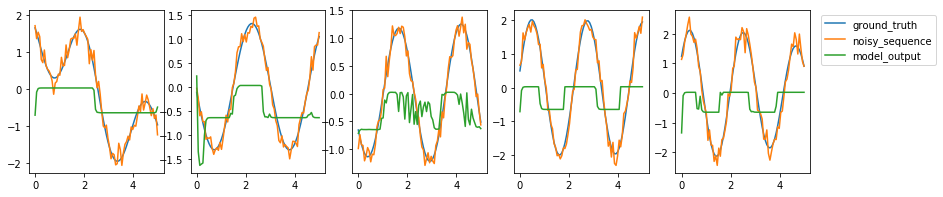

epoch: 53, validation loss:14868.2666015625


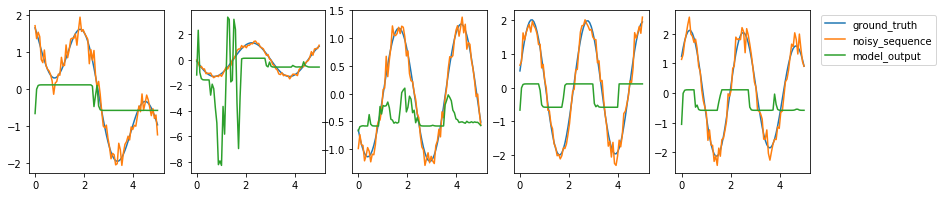

epoch: 54, validation loss:15568.12109375


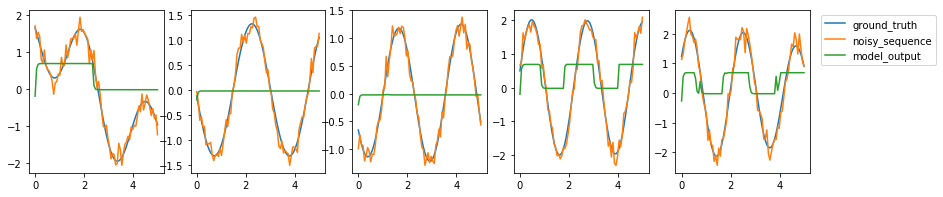

epoch: 55, validation loss:9863.59375


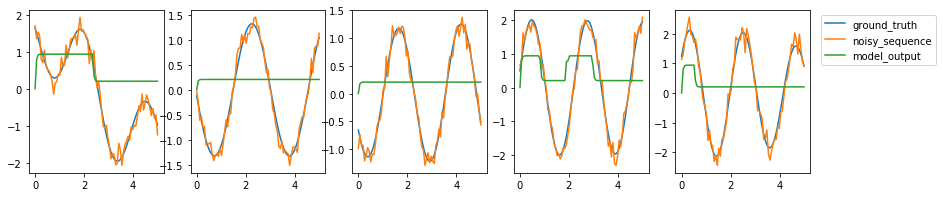

epoch: 56, validation loss:6087.5849609375


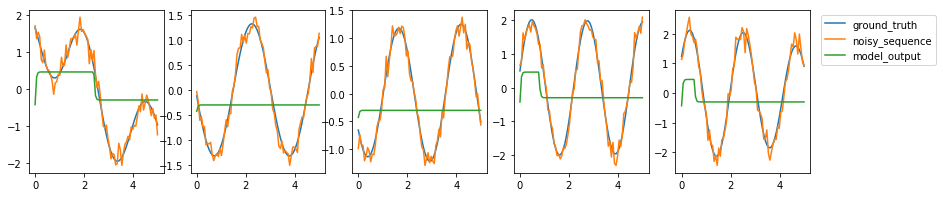

epoch: 57, validation loss:5523.65869140625


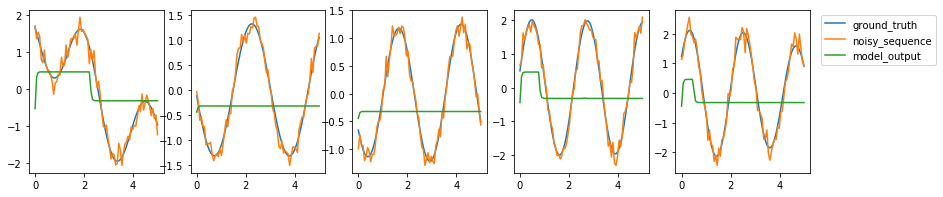

epoch: 58, validation loss:5829.36328125


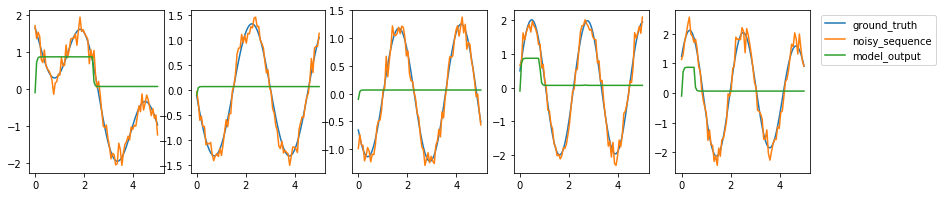

epoch: 59, validation loss:5948.34033203125


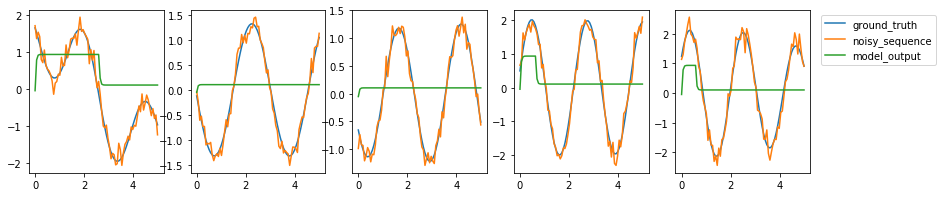

epoch: 60, validation loss:5362.66796875


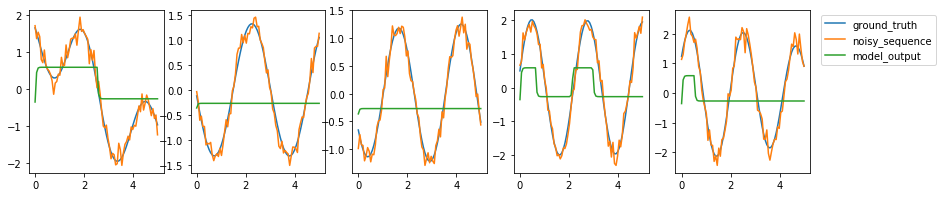

epoch: 61, validation loss:4848.08203125


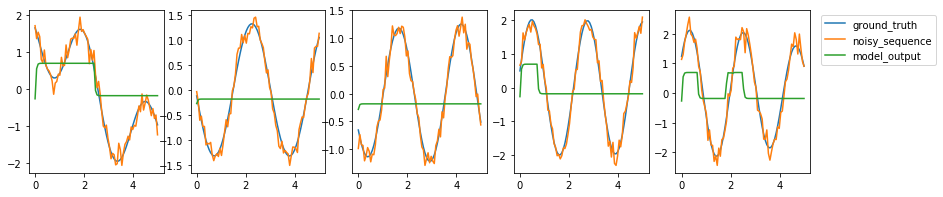

epoch: 62, validation loss:6296.23291015625


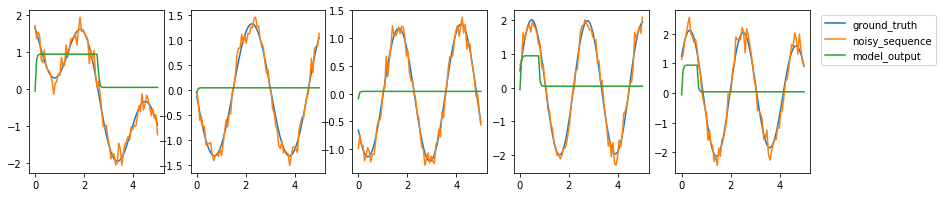

epoch: 63, validation loss:6108.6728515625


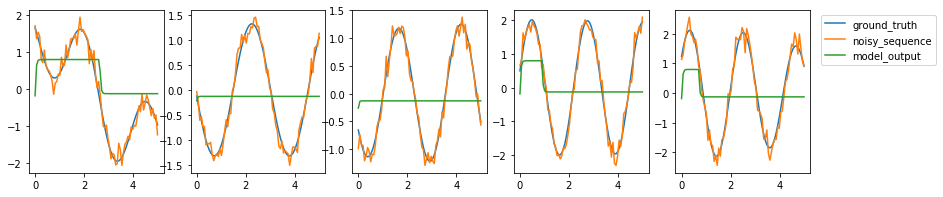

epoch: 64, validation loss:5643.509765625


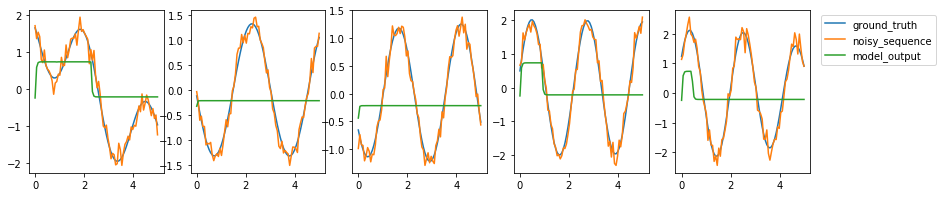

epoch: 65, validation loss:5810.8115234375


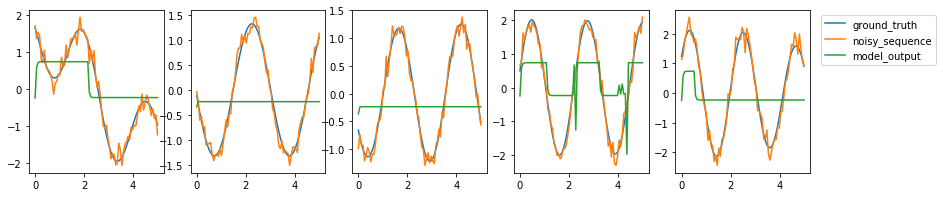

epoch: 66, validation loss:4847.81201171875


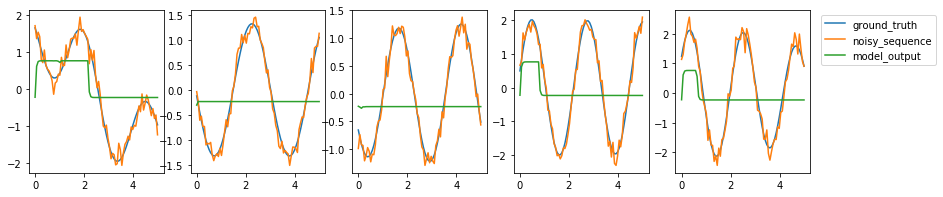

epoch: 67, validation loss:6903.9794921875


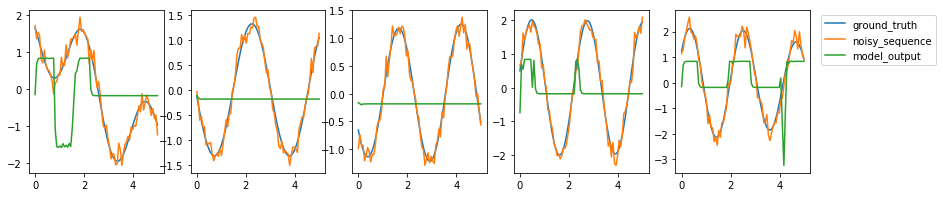

epoch: 68, validation loss:6885.45947265625


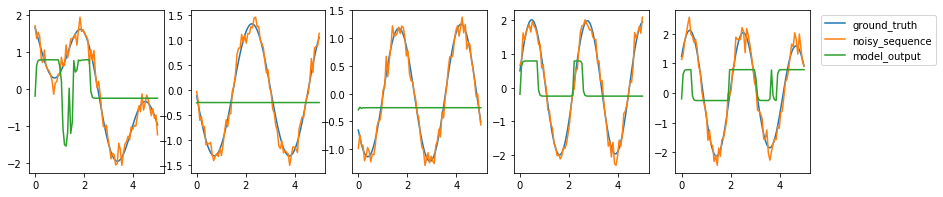

epoch: 69, validation loss:6261.20751953125


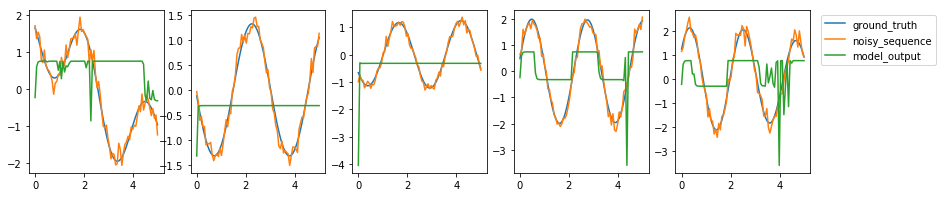

epoch: 70, validation loss:5336.14892578125


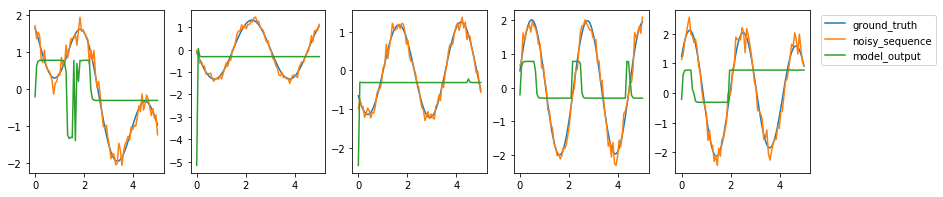

epoch: 71, validation loss:5872.9013671875


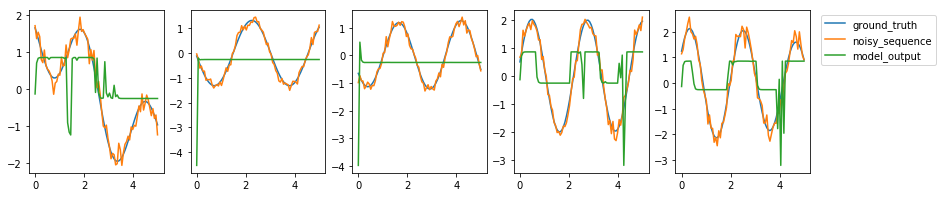

epoch: 72, validation loss:6820.35302734375


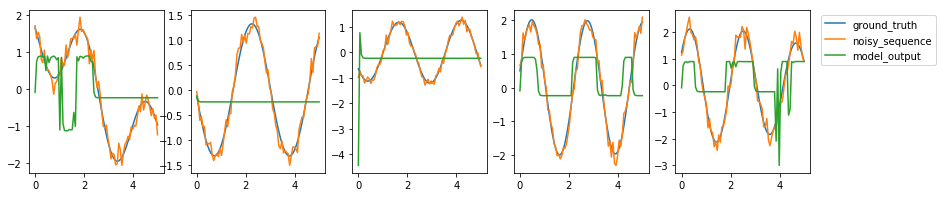

epoch: 73, validation loss:6445.11962890625


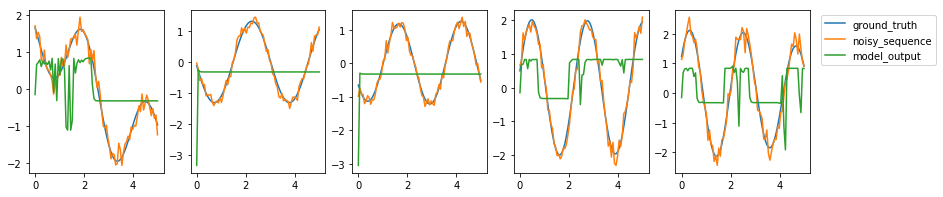

epoch: 74, validation loss:6490.447265625


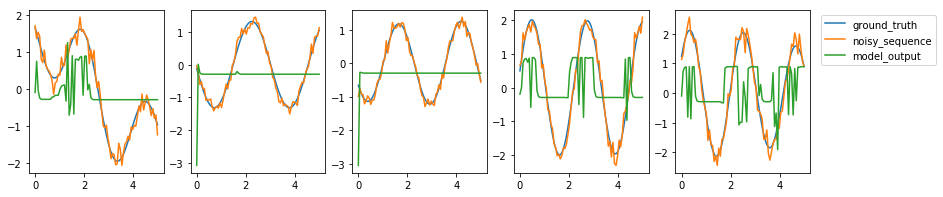

epoch: 75, validation loss:7645.22216796875


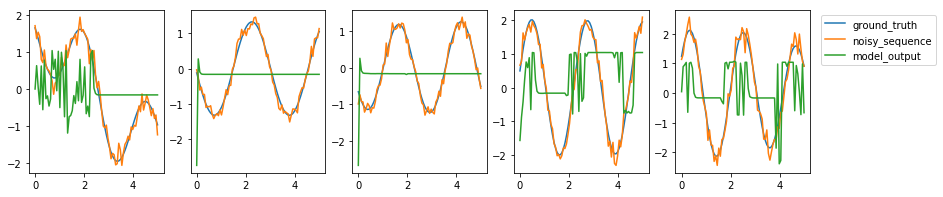

epoch: 76, validation loss:7434.078125


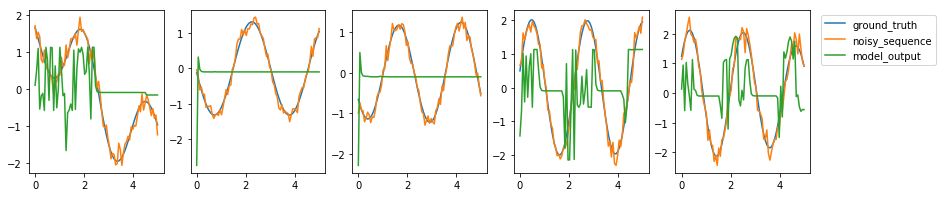

epoch: 77, validation loss:6724.8359375


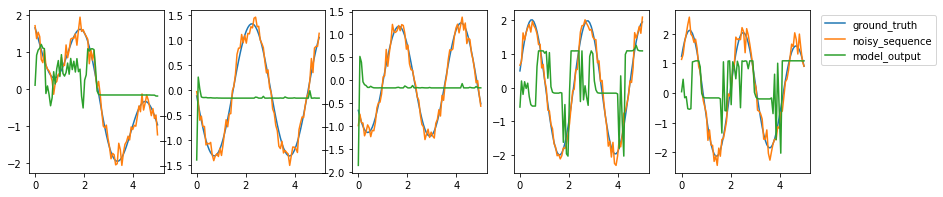

epoch: 78, validation loss:8799.943359375


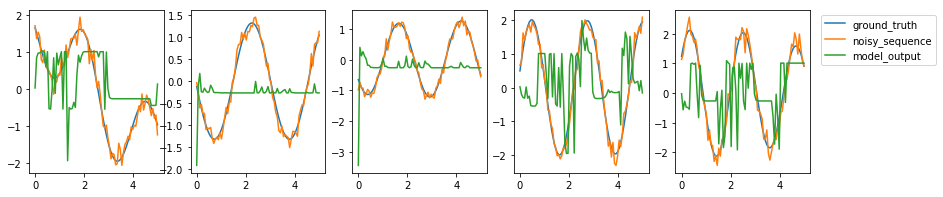

epoch: 79, validation loss:6675.14794921875


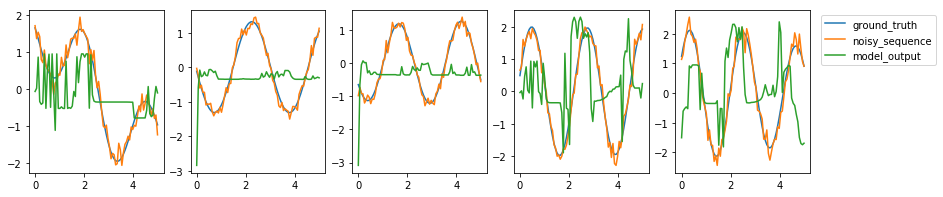

epoch: 80, validation loss:7416.6962890625


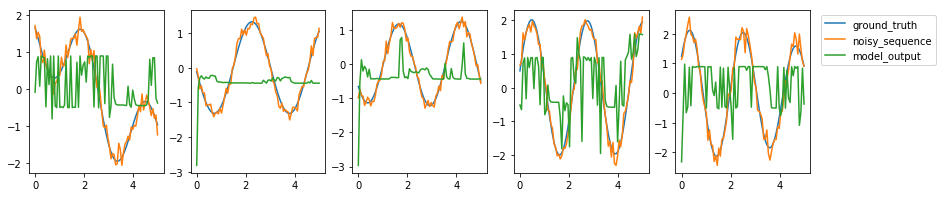

epoch: 81, validation loss:8377.05859375


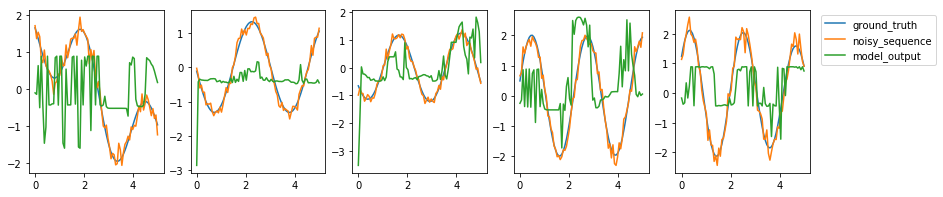

epoch: 82, validation loss:8133.34423828125


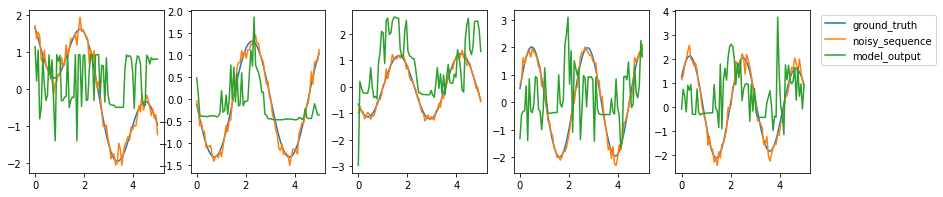

epoch: 83, validation loss:8677.1298828125


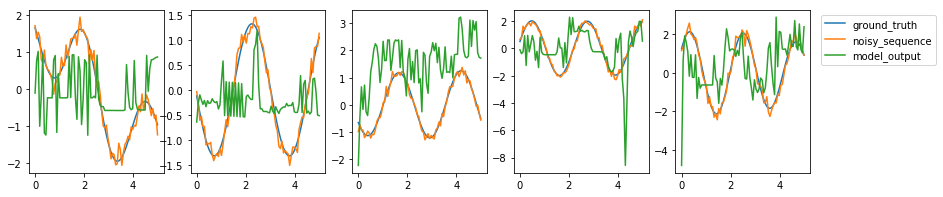

epoch: 84, validation loss:8224.796875


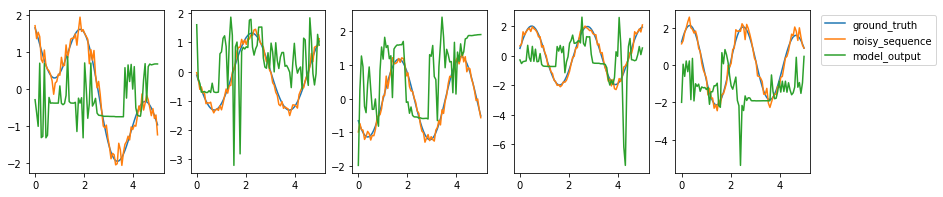

epoch: 85, validation loss:14154.41015625


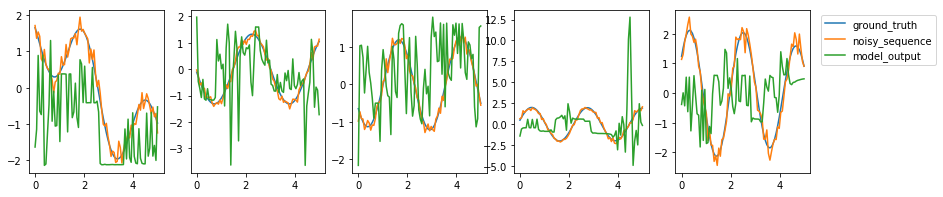

epoch: 86, validation loss:19612.255859375


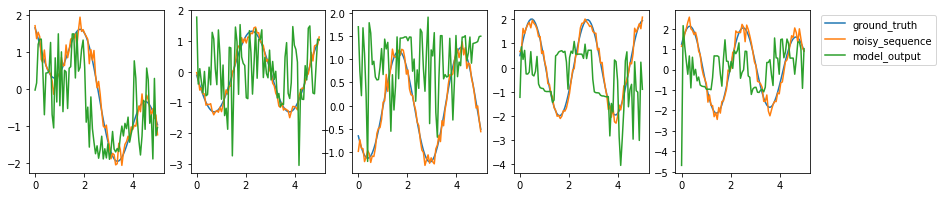

epoch: 87, validation loss:16610.986328125


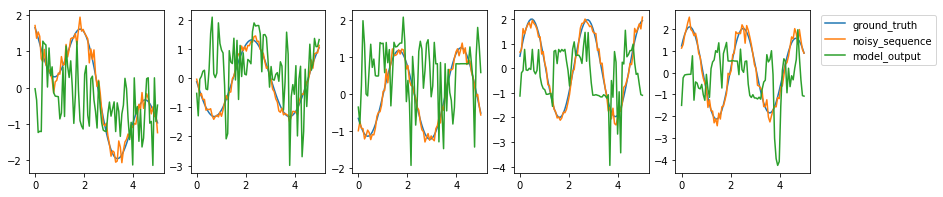

epoch: 88, validation loss:15256.3466796875


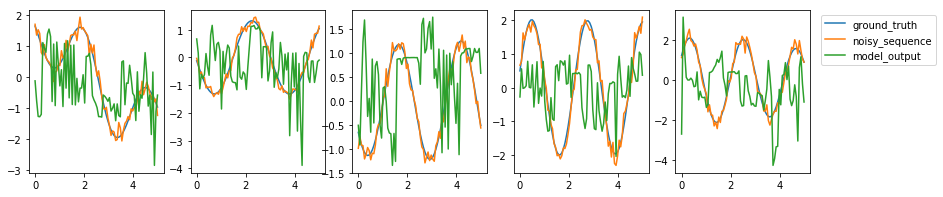

epoch: 89, validation loss:22875.712890625


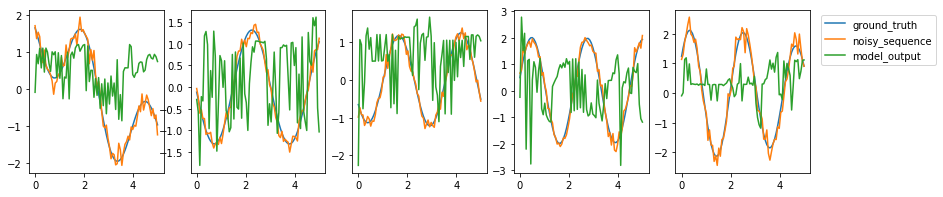

epoch: 90, validation loss:14751.2705078125


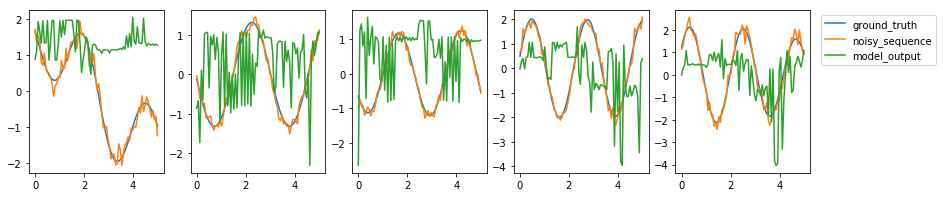

epoch: 91, validation loss:15503.0703125


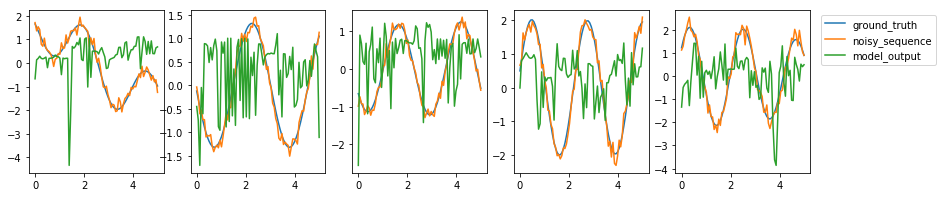

epoch: 92, validation loss:18533.9296875


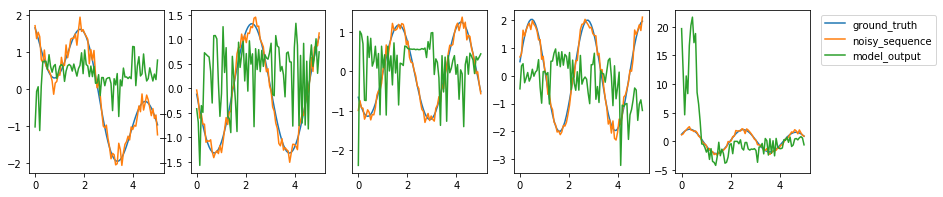

epoch: 93, validation loss:18750.05078125


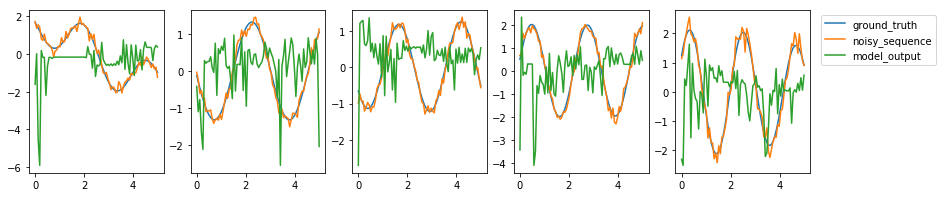

epoch: 94, validation loss:18410.33203125


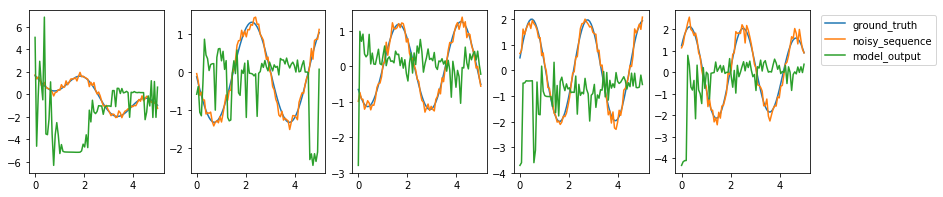

epoch: 95, validation loss:24407.736328125


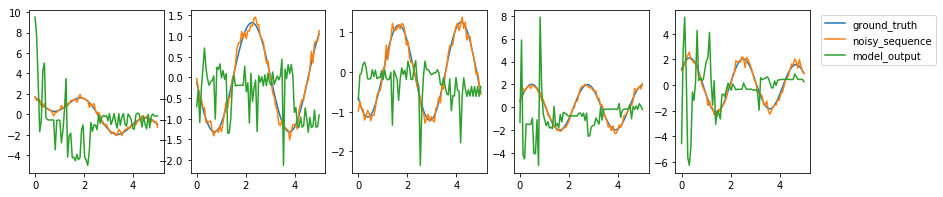

epoch: 96, validation loss:22702.96484375


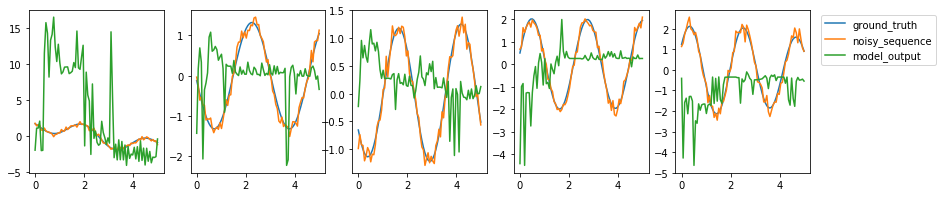

epoch: 97, validation loss:26788.05859375


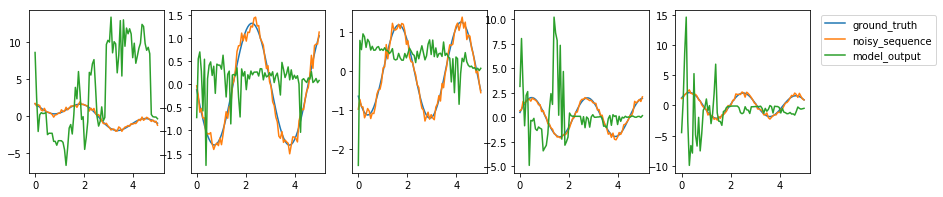

epoch: 98, validation loss:22291.66796875


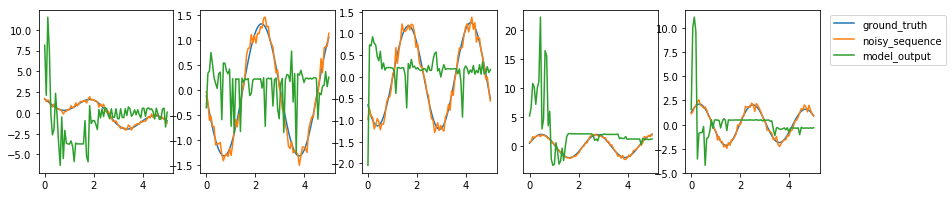

epoch: 99, validation loss:20531.79296875


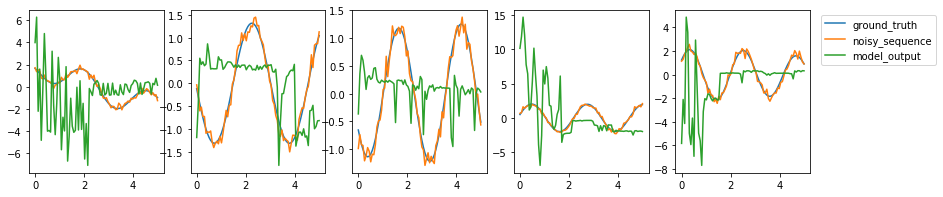

epoch: 100, validation loss:22679.900390625


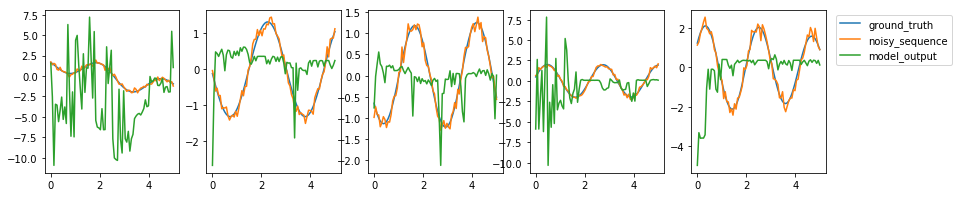

In [10]:
# don't forget to create a new model each time!
# START TODO #############

# Reducing the batch size from 20 to 10

batch_size = 10 # <- CHANGED
num_epochs = 101
learning_rate = 0.005

model_2 = NoiseRemovalModel(hidden_size=40, shift=10)
optimizer = optim.Adam(model_2.parameters(), lr=learning_rate, betas=(0.6, 0.87))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
print("cuda avialable :", torch.cuda.is_available())
train(model_2, optimizer, scheduler, num_epochs, batch_size)


cuda avialable : False
epoch: 0, validation loss:5279.50634765625


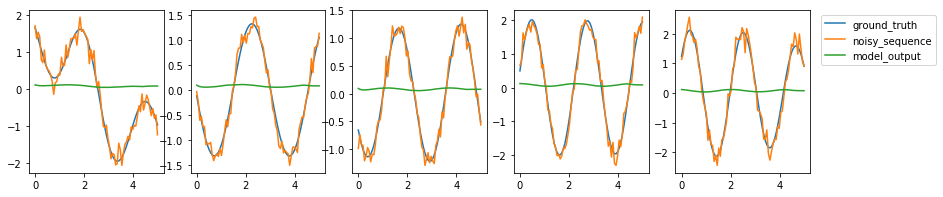

epoch: 1, validation loss:4361.40869140625


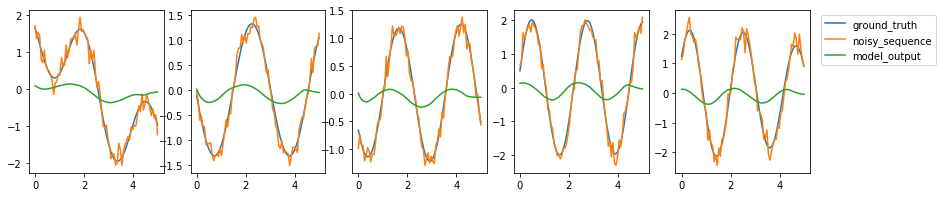

epoch: 2, validation loss:2900.54052734375


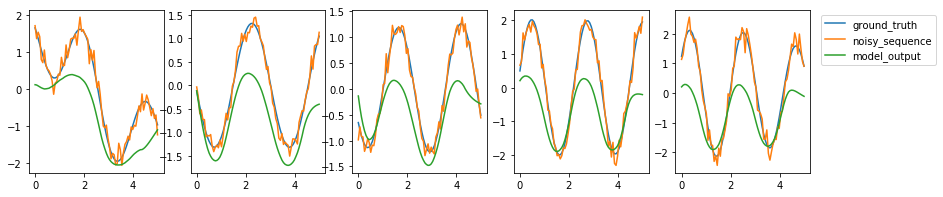

epoch: 3, validation loss:2894.442138671875


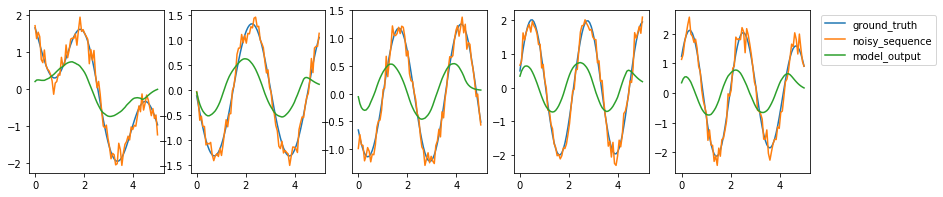

epoch: 4, validation loss:2453.47412109375


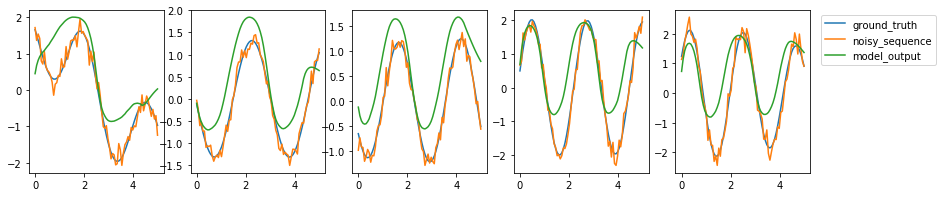

epoch: 5, validation loss:1839.6014404296875


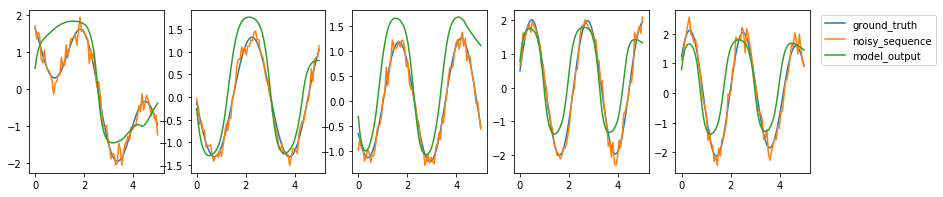

epoch: 6, validation loss:2312.636474609375


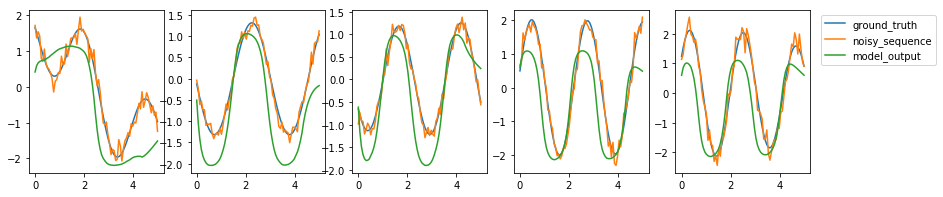

epoch: 7, validation loss:2439.014892578125


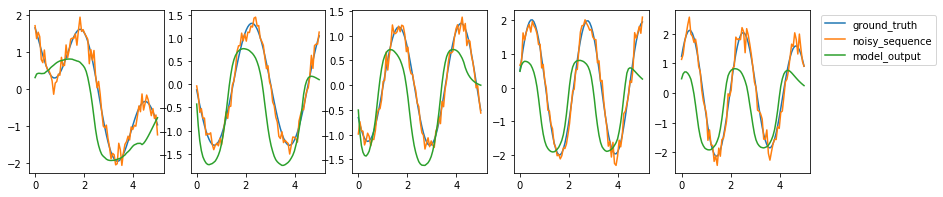

epoch: 8, validation loss:2718.777587890625


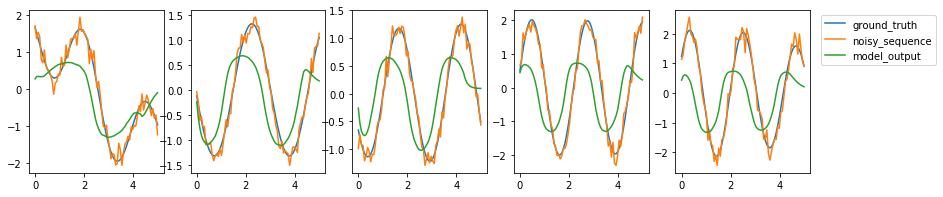

epoch: 9, validation loss:2828.64013671875


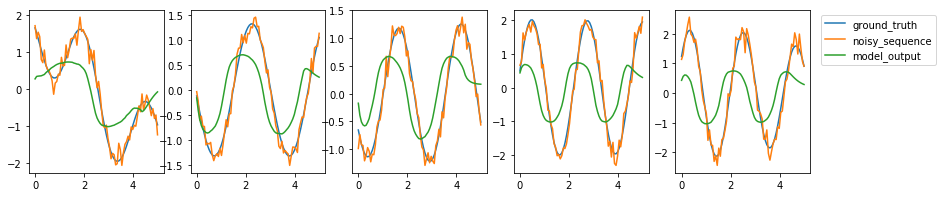

epoch: 10, validation loss:2497.537353515625


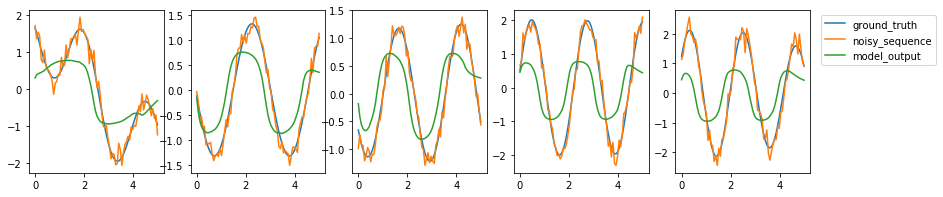

epoch: 11, validation loss:2050.51806640625


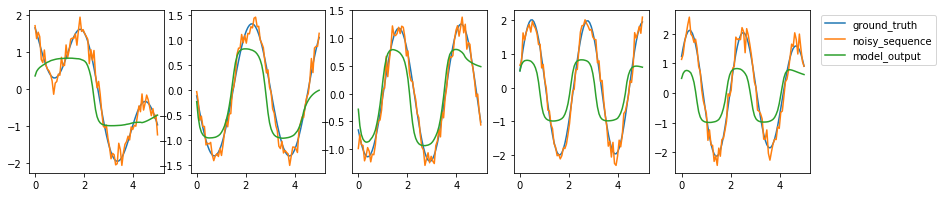

epoch: 12, validation loss:2276.481689453125


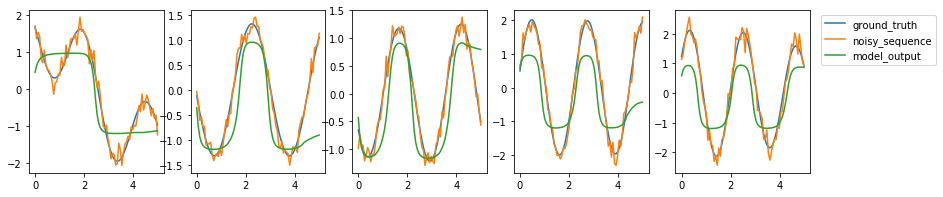

epoch: 13, validation loss:2069.020751953125


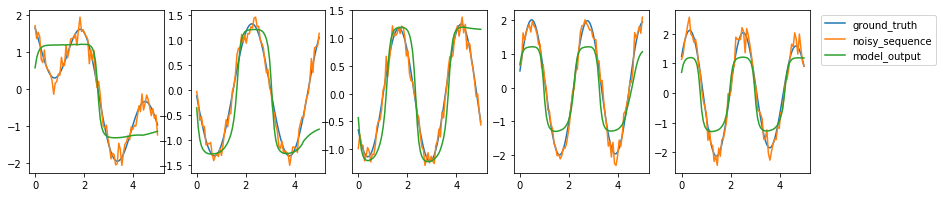

epoch: 14, validation loss:2566.98974609375


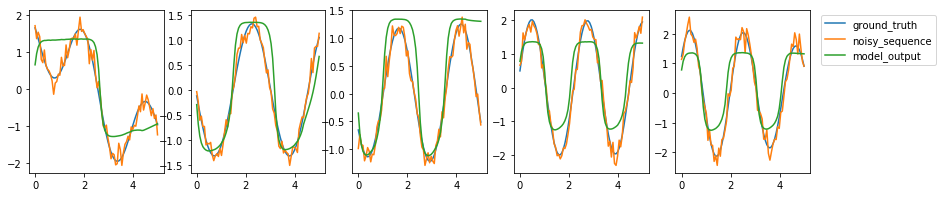

epoch: 15, validation loss:1930.060302734375


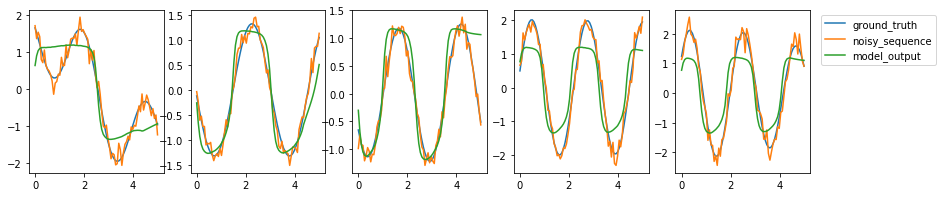

epoch: 16, validation loss:1828.9307861328125


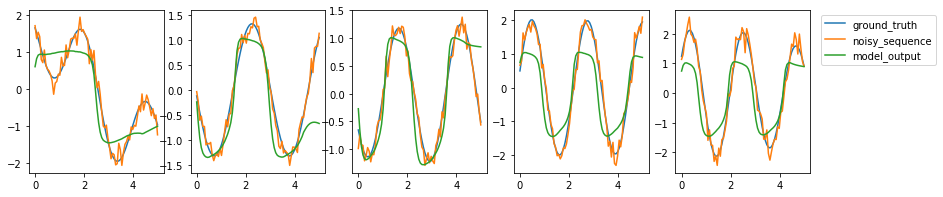

epoch: 17, validation loss:1841.7088623046875


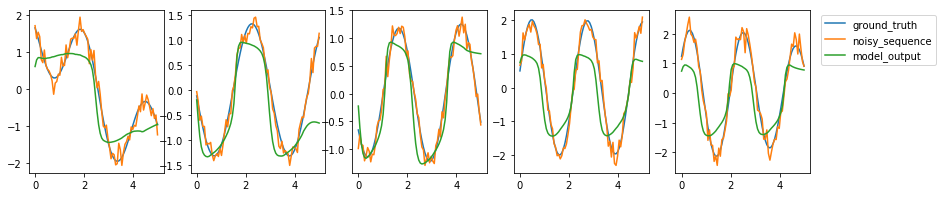

epoch: 18, validation loss:1546.992919921875


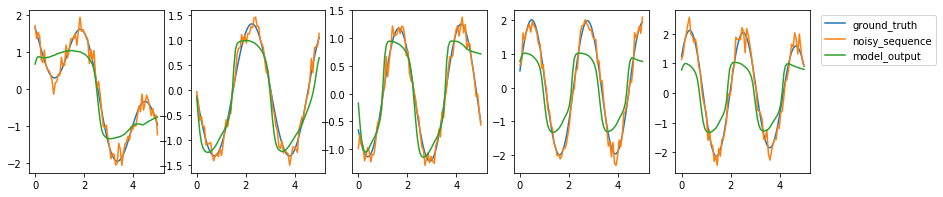

epoch: 19, validation loss:1670.99853515625


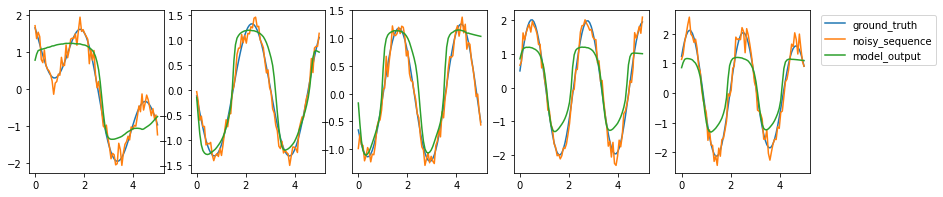

epoch: 20, validation loss:1455.1854248046875


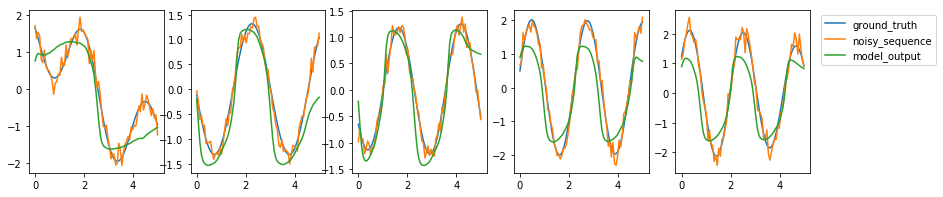

epoch: 21, validation loss:1416.9268798828125


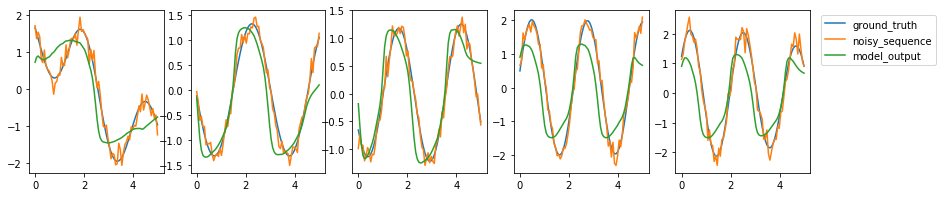

epoch: 22, validation loss:1362.2332763671875


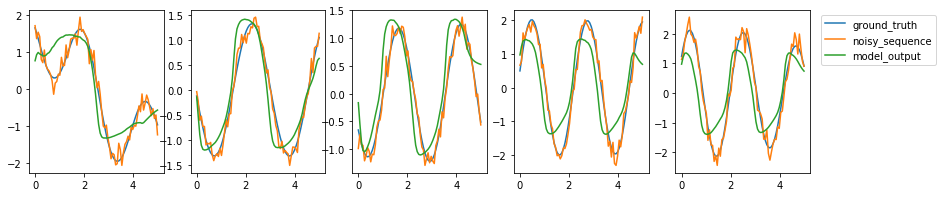

epoch: 23, validation loss:1450.4810791015625


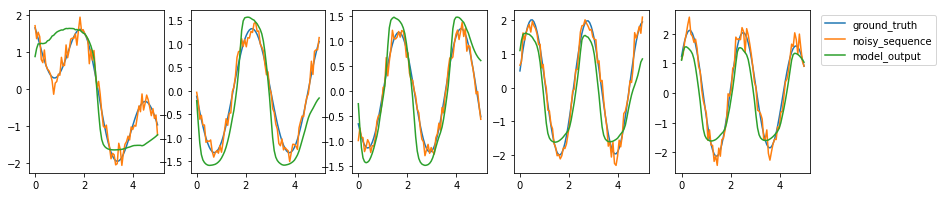

epoch: 24, validation loss:1154.720458984375


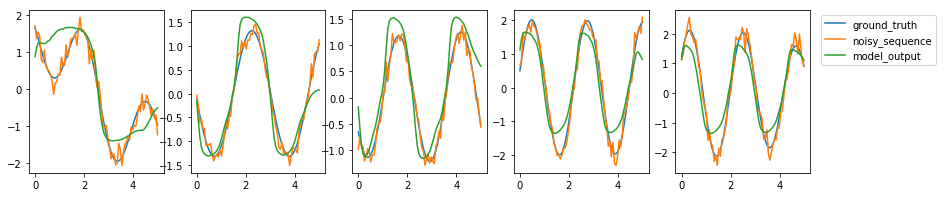

epoch: 25, validation loss:1210.3040771484375


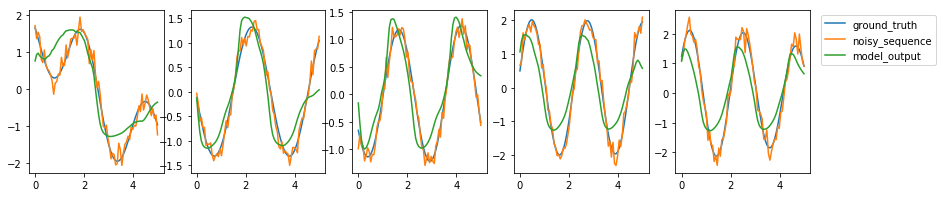

epoch: 26, validation loss:1438.3875732421875


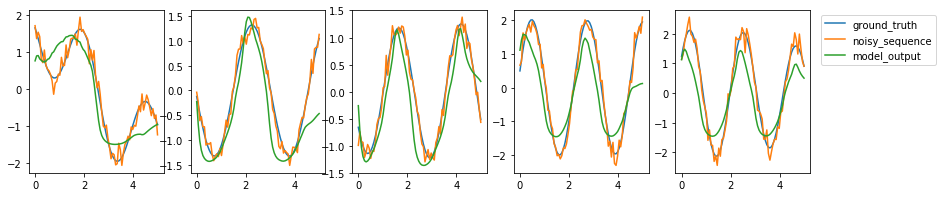

epoch: 27, validation loss:1050.32373046875


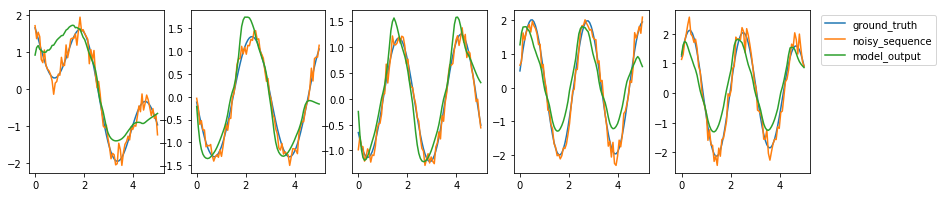

epoch: 28, validation loss:1066.9708251953125


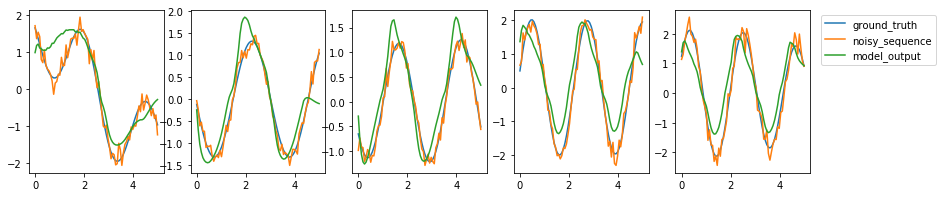

epoch: 29, validation loss:1333.0897216796875


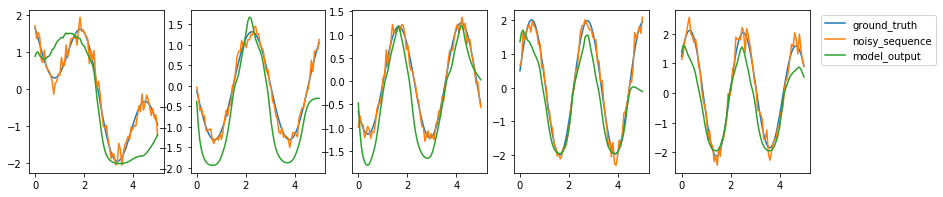

epoch: 30, validation loss:1019.0203857421875


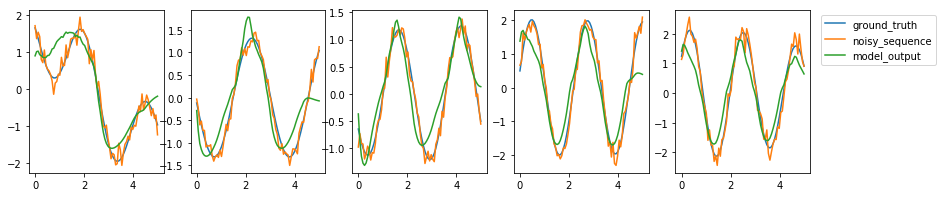

epoch: 31, validation loss:884.4976806640625


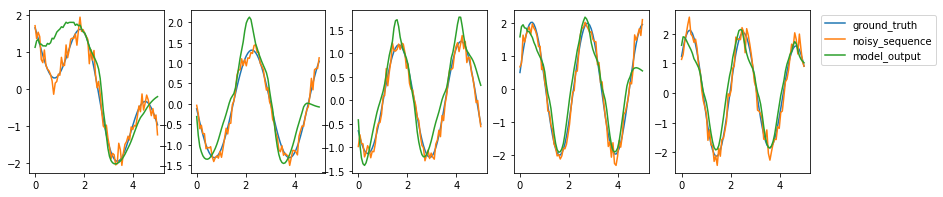

epoch: 32, validation loss:1216.106201171875


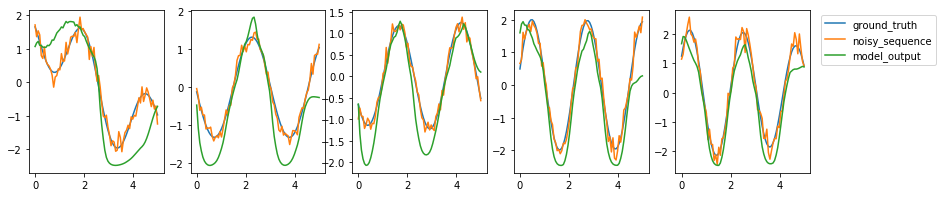

epoch: 33, validation loss:916.0682373046875


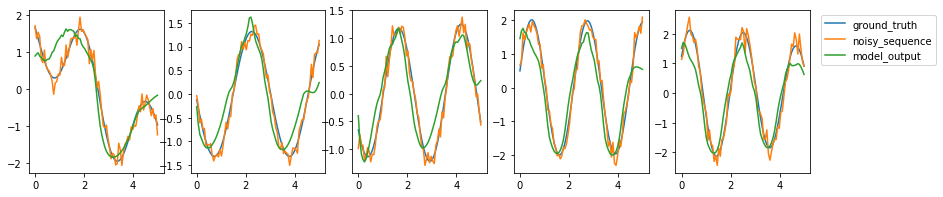

epoch: 34, validation loss:742.6255493164062


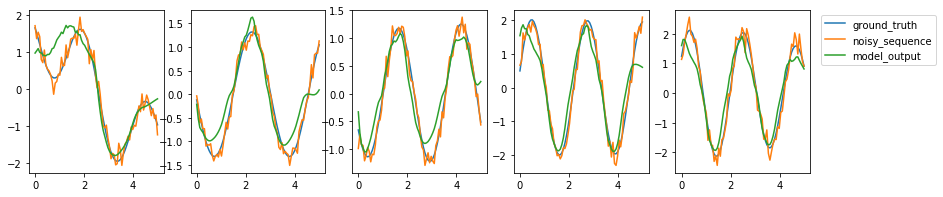

epoch: 35, validation loss:1109.425048828125


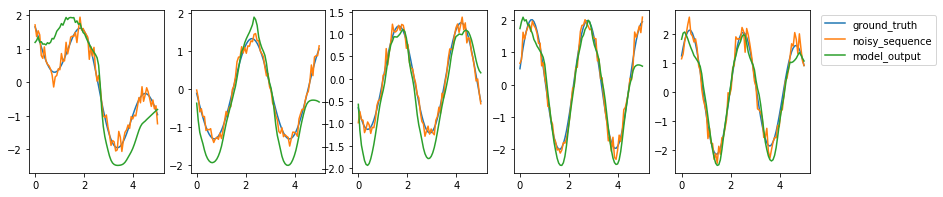

epoch: 36, validation loss:563.715576171875


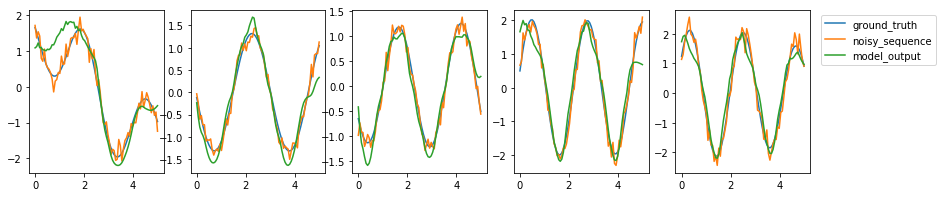

epoch: 37, validation loss:953.709228515625


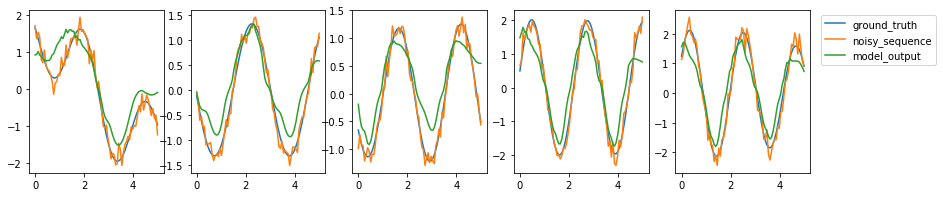

epoch: 38, validation loss:498.5950622558594


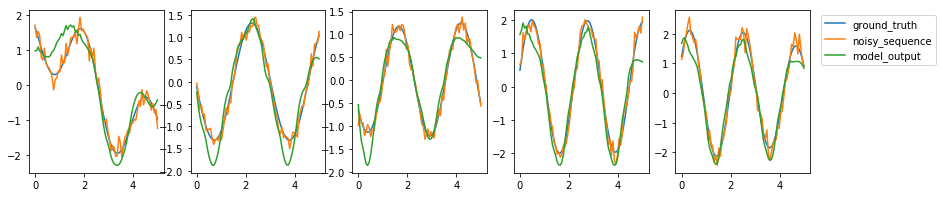

epoch: 39, validation loss:895.0194091796875


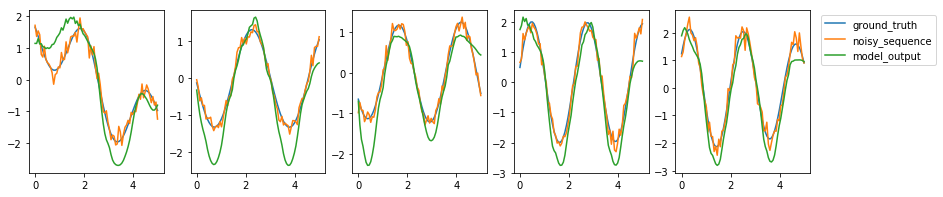

epoch: 40, validation loss:430.2192077636719


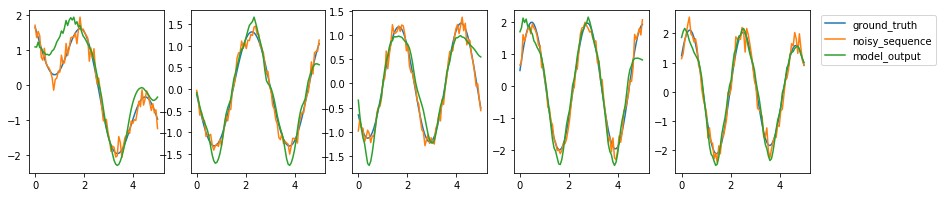

epoch: 41, validation loss:769.2874755859375


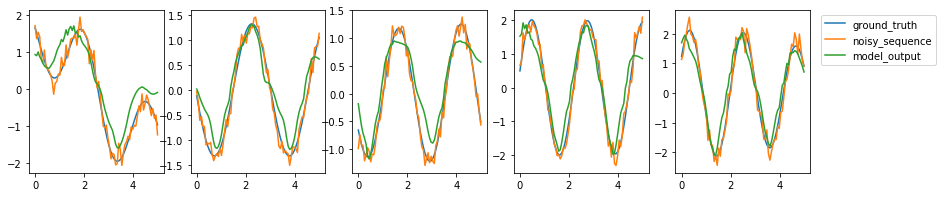

epoch: 42, validation loss:431.505615234375


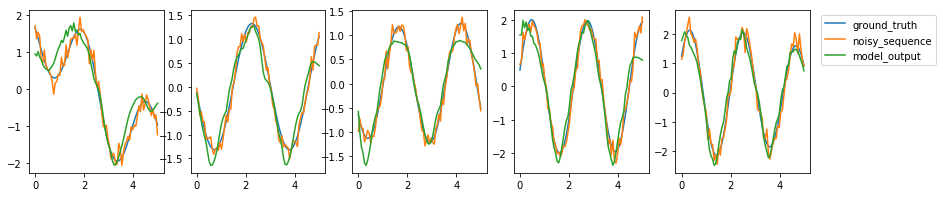

epoch: 43, validation loss:604.2161254882812


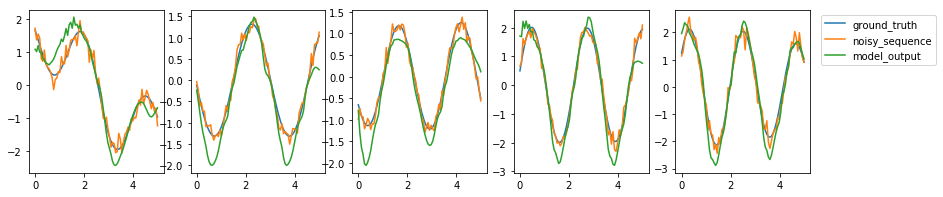

epoch: 44, validation loss:405.2032775878906


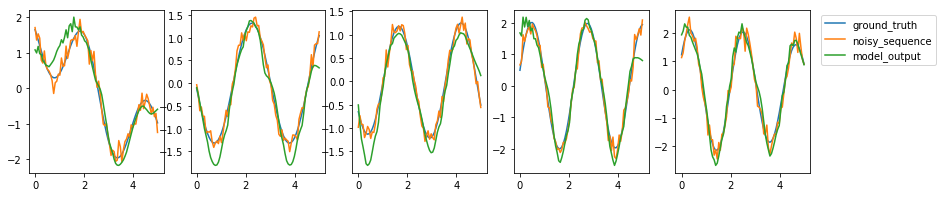

epoch: 45, validation loss:486.81207275390625


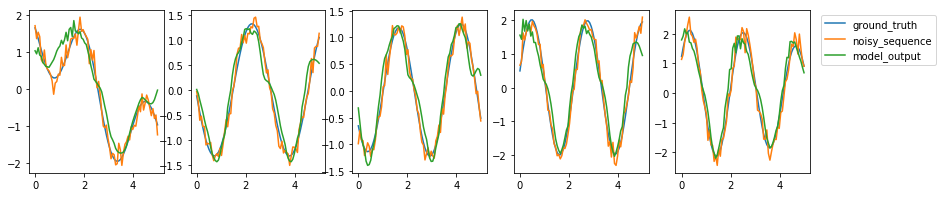

epoch: 46, validation loss:454.97052001953125


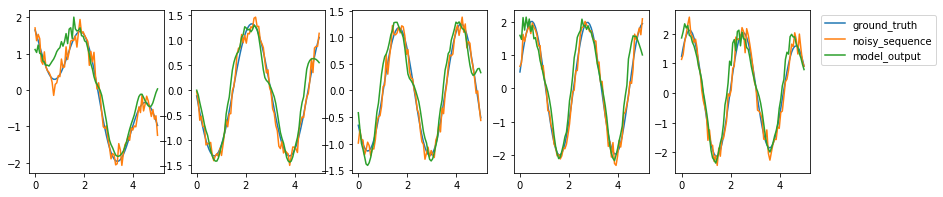

epoch: 47, validation loss:363.6182556152344


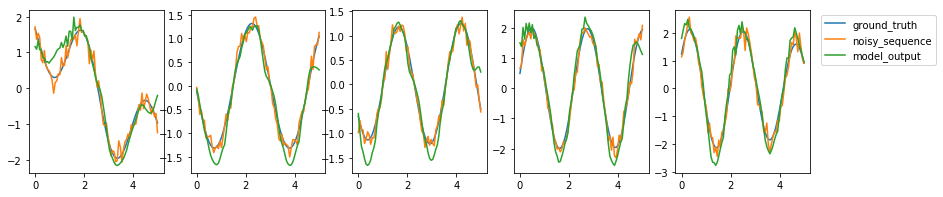

epoch: 48, validation loss:413.0188903808594


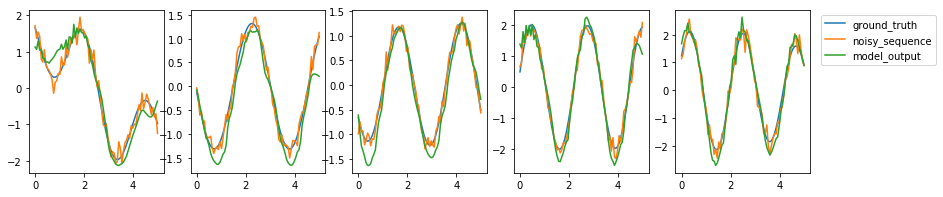

epoch: 49, validation loss:316.0068664550781


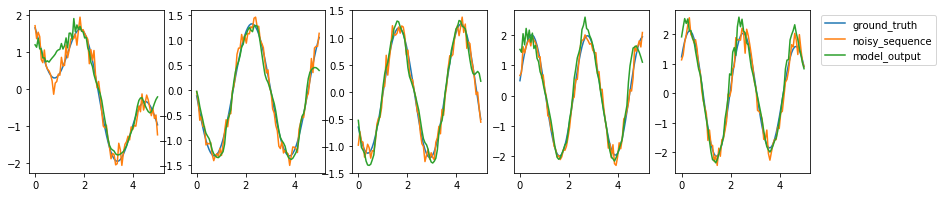

epoch: 50, validation loss:327.3223876953125


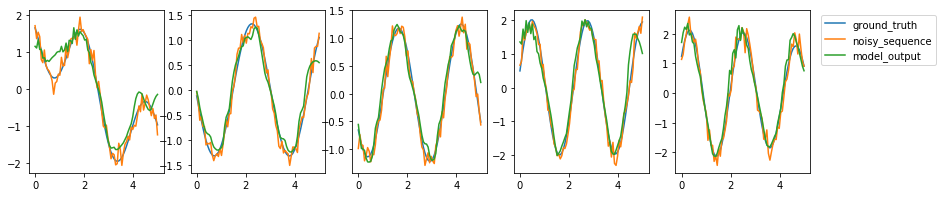

epoch: 51, validation loss:238.45594787597656


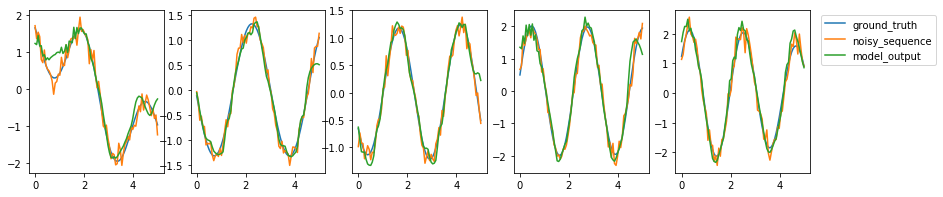

epoch: 52, validation loss:281.78594970703125


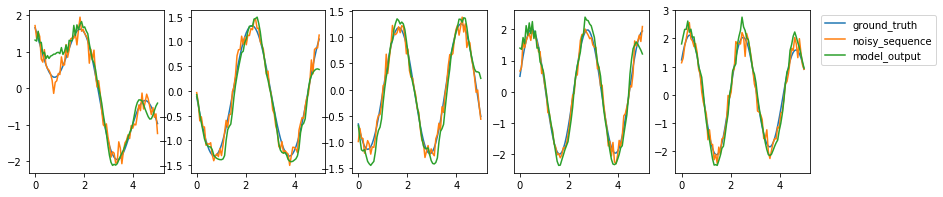

epoch: 53, validation loss:223.28016662597656


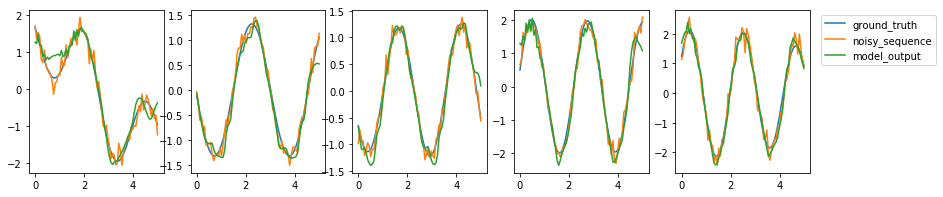

epoch: 54, validation loss:253.48057556152344


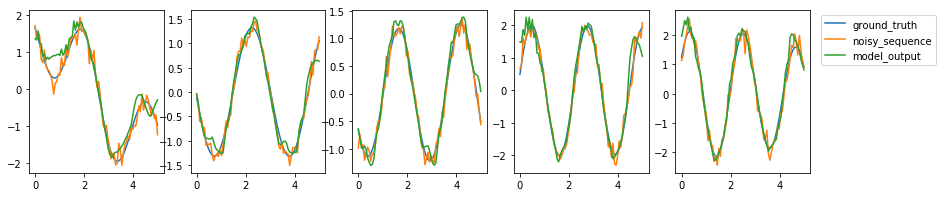

epoch: 55, validation loss:198.9373321533203


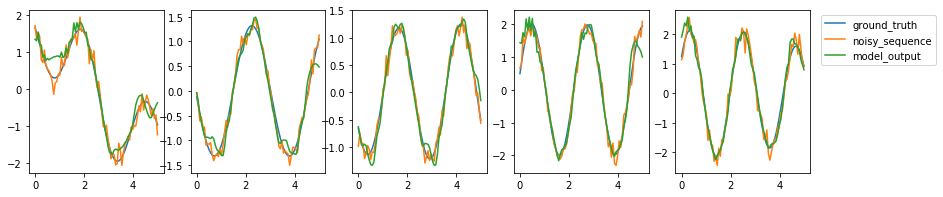

epoch: 56, validation loss:204.42845153808594


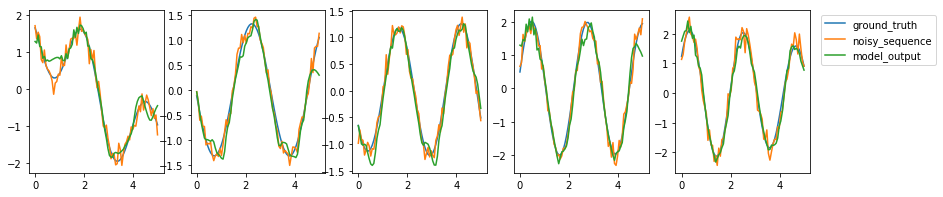

epoch: 57, validation loss:213.21751403808594


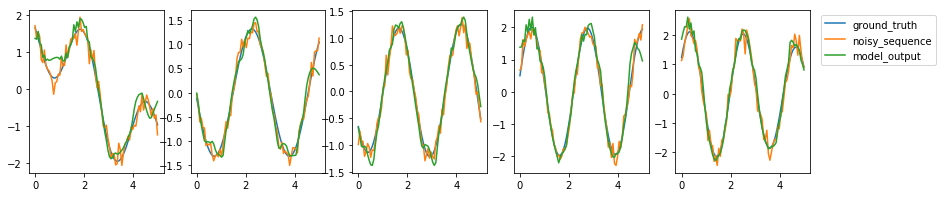

epoch: 58, validation loss:204.50180053710938


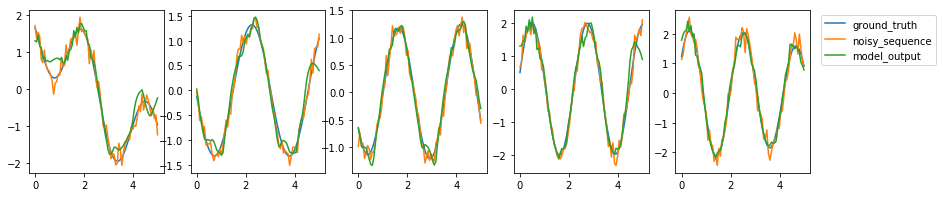

epoch: 59, validation loss:199.1309051513672


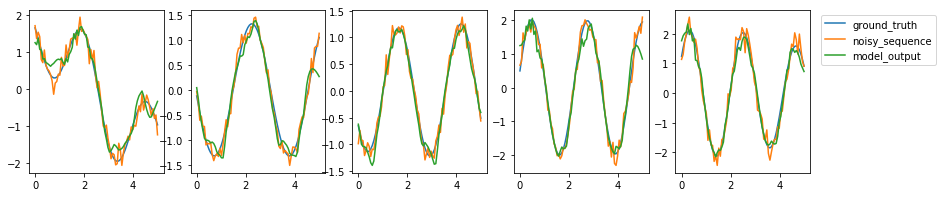

epoch: 60, validation loss:204.9109649658203


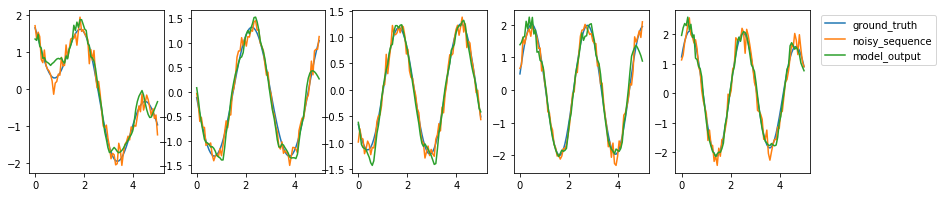

epoch: 61, validation loss:190.9373321533203


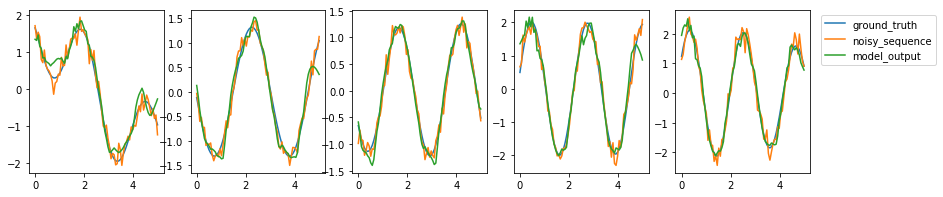

epoch: 62, validation loss:194.01112365722656


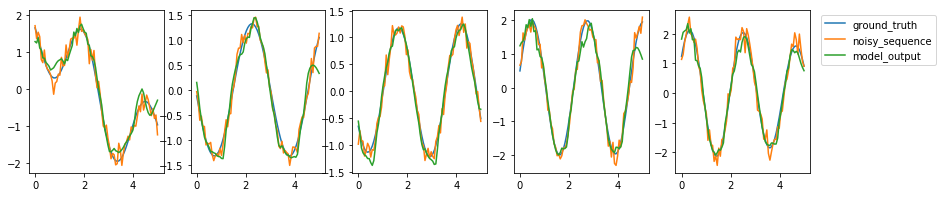

epoch: 63, validation loss:173.82342529296875


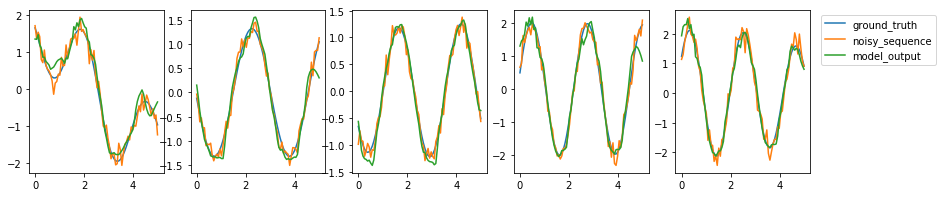

epoch: 64, validation loss:178.12933349609375


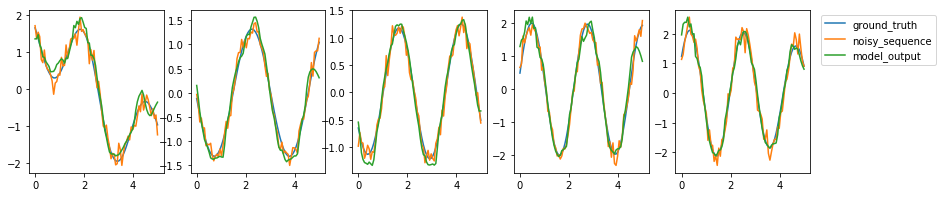

epoch: 65, validation loss:171.88790893554688


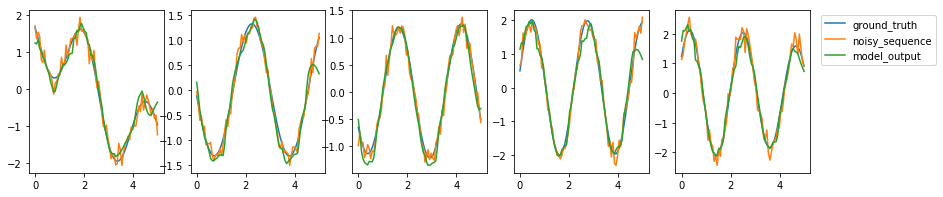

epoch: 66, validation loss:159.90084838867188


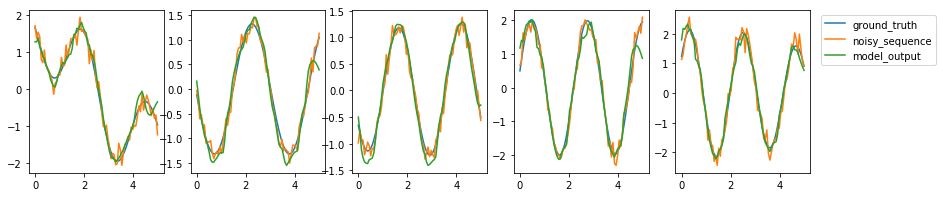

epoch: 67, validation loss:155.62767028808594


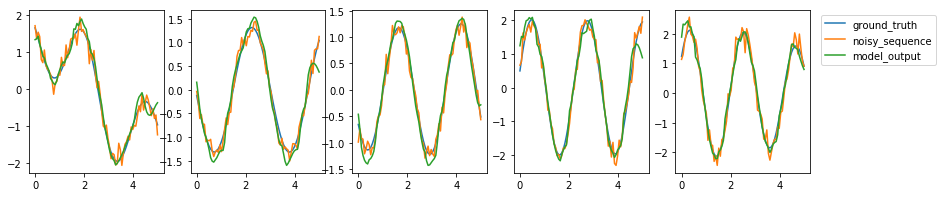

epoch: 68, validation loss:149.9758758544922


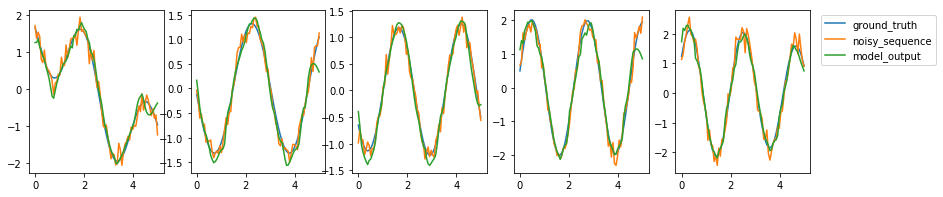

epoch: 69, validation loss:146.28067016601562


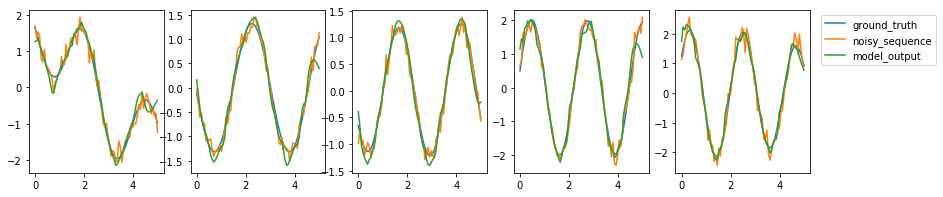

epoch: 70, validation loss:144.0374755859375


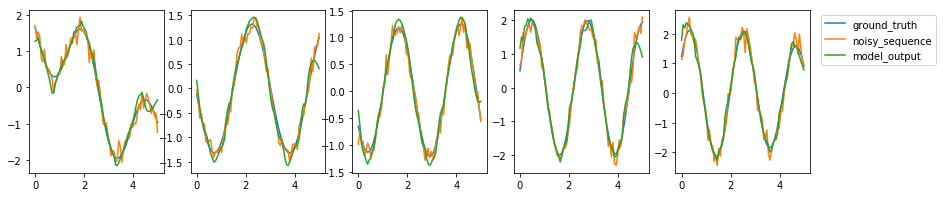

epoch: 71, validation loss:144.90390014648438


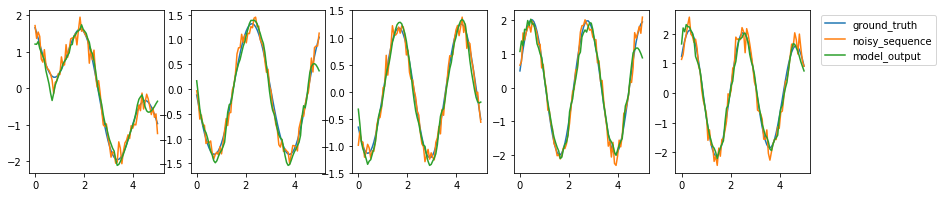

epoch: 72, validation loss:141.9345245361328


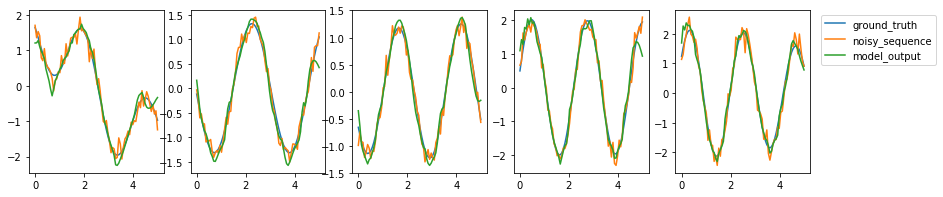

epoch: 73, validation loss:136.96116638183594


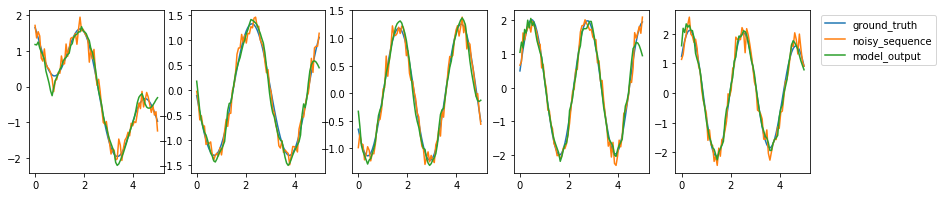

epoch: 74, validation loss:139.00750732421875


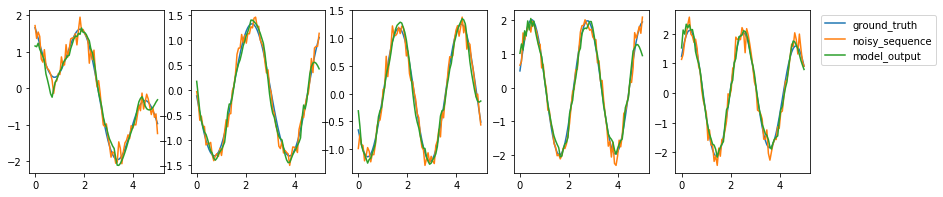

epoch: 75, validation loss:146.33883666992188


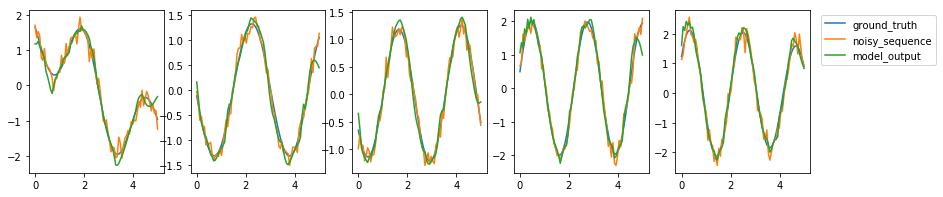

epoch: 76, validation loss:133.6559600830078


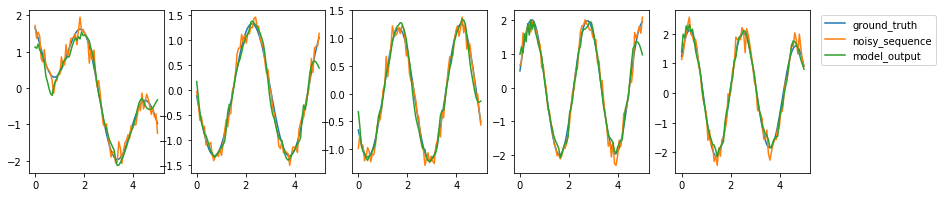

epoch: 77, validation loss:133.87557983398438


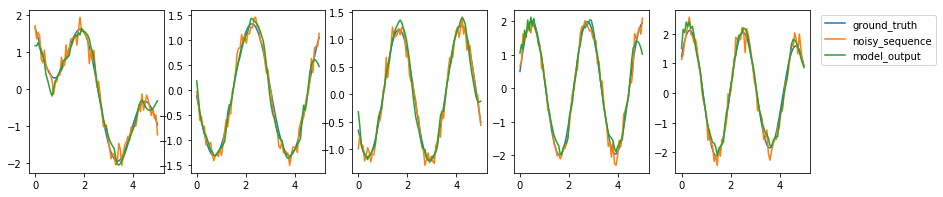

epoch: 78, validation loss:137.943359375


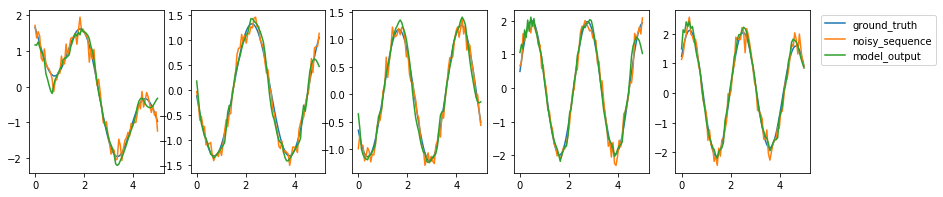

epoch: 79, validation loss:128.51077270507812


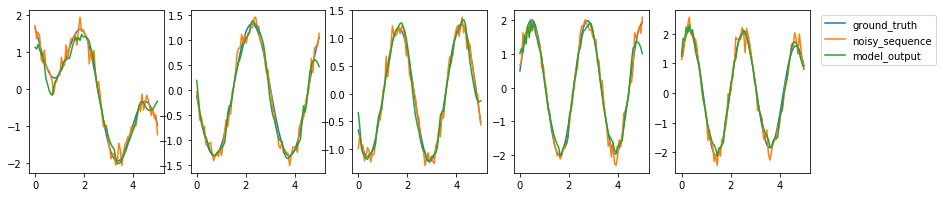

epoch: 80, validation loss:130.52127075195312


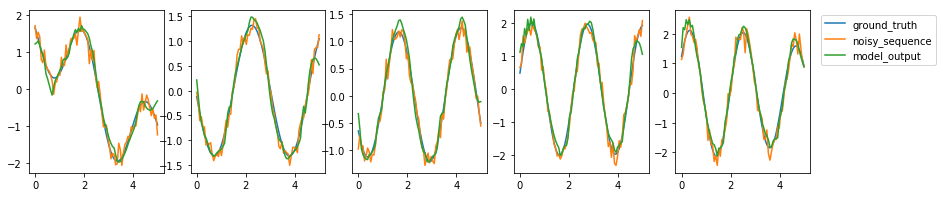

epoch: 81, validation loss:121.79824829101562


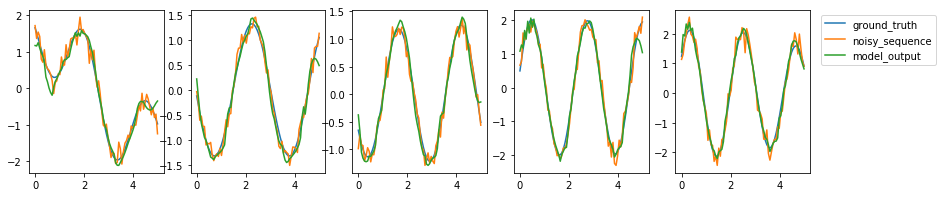

epoch: 82, validation loss:119.37200164794922


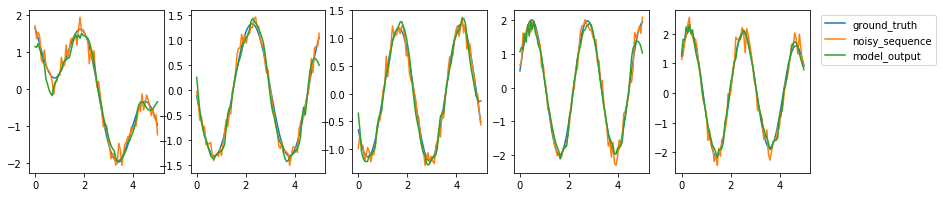

epoch: 83, validation loss:132.2876739501953


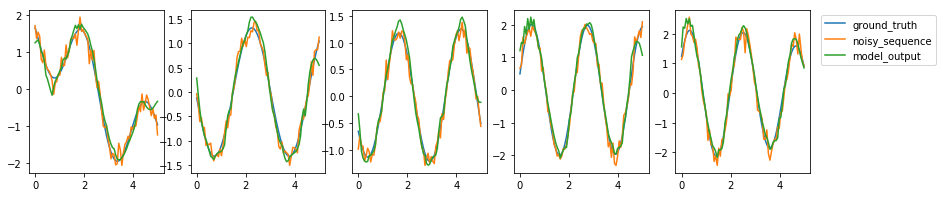

epoch: 84, validation loss:118.4131851196289


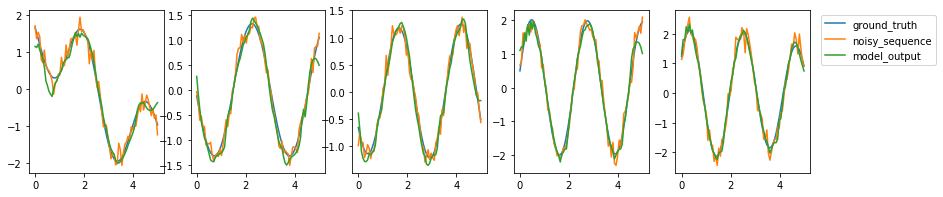

epoch: 85, validation loss:113.82770538330078


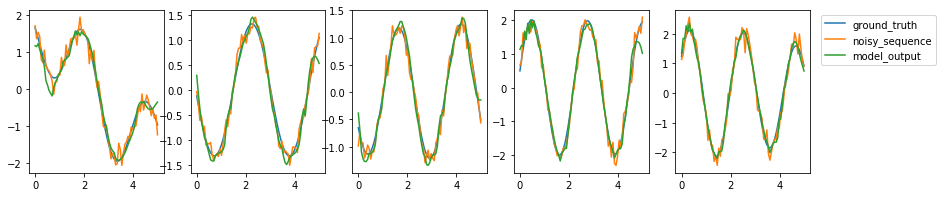

epoch: 86, validation loss:132.24374389648438


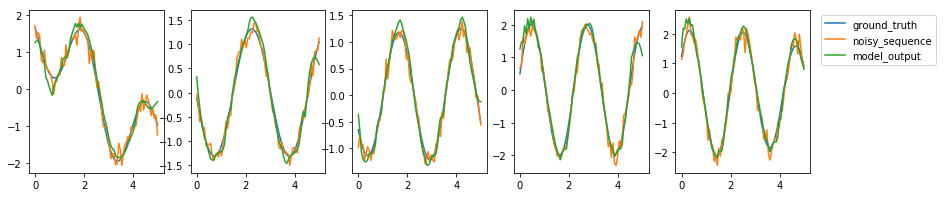

epoch: 87, validation loss:122.53813171386719


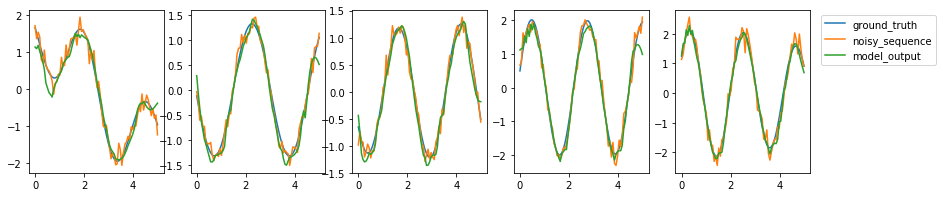

epoch: 88, validation loss:109.72491455078125


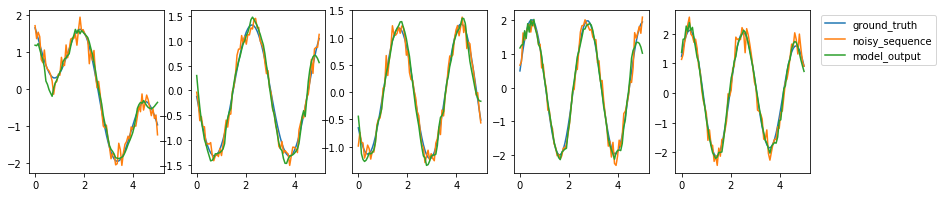

epoch: 89, validation loss:131.3427734375


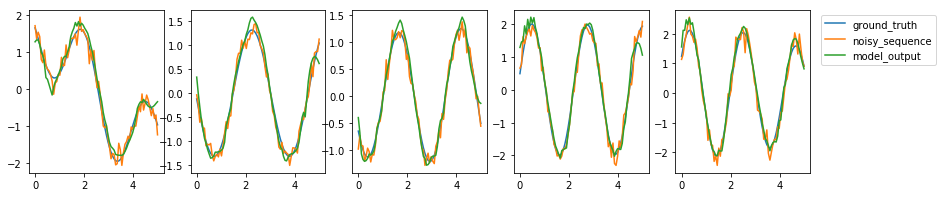

epoch: 90, validation loss:120.41804504394531


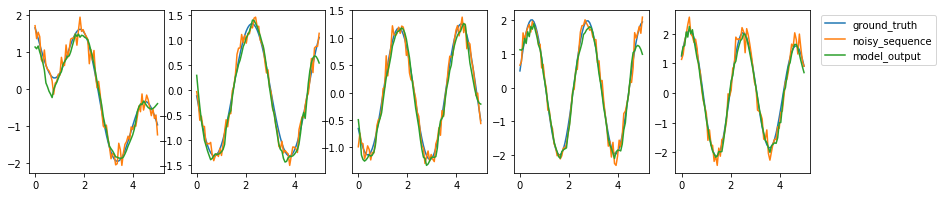

epoch: 91, validation loss:108.77981567382812


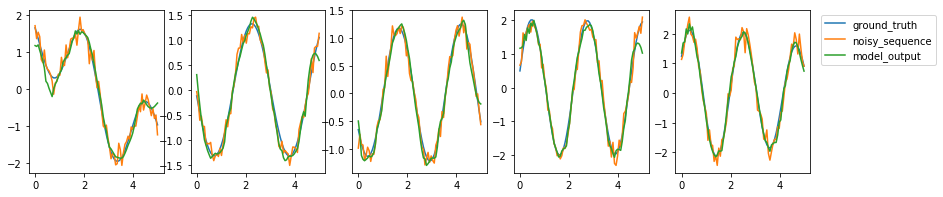

epoch: 92, validation loss:138.119384765625


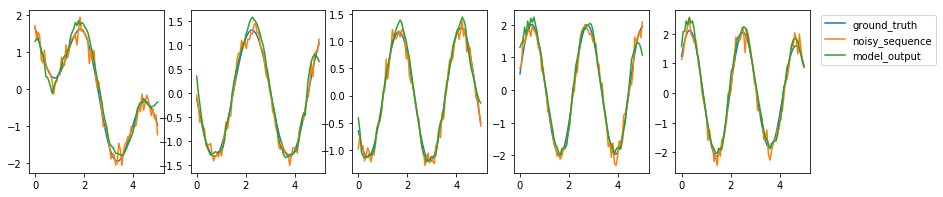

epoch: 93, validation loss:113.1723403930664


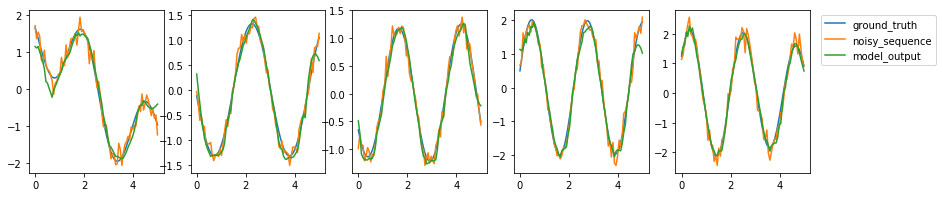

epoch: 94, validation loss:120.26224517822266


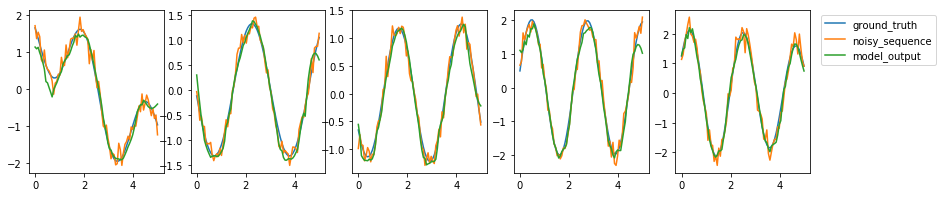

epoch: 95, validation loss:132.11480712890625


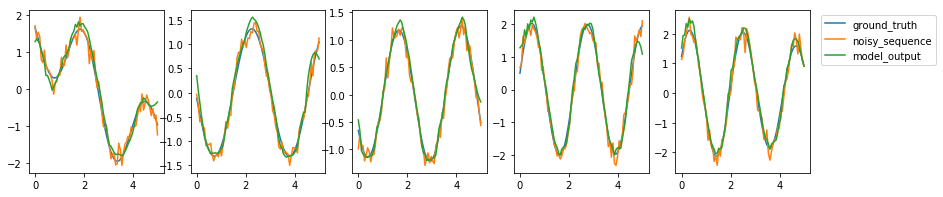

epoch: 96, validation loss:106.6220474243164


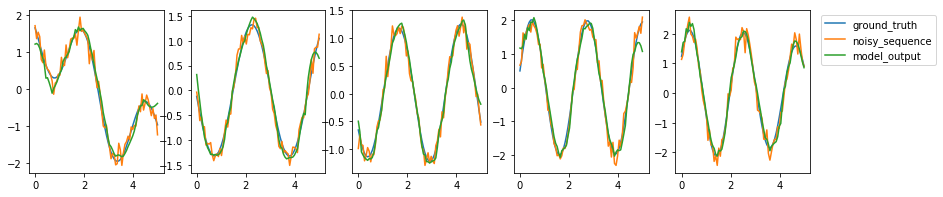

epoch: 97, validation loss:128.33621215820312


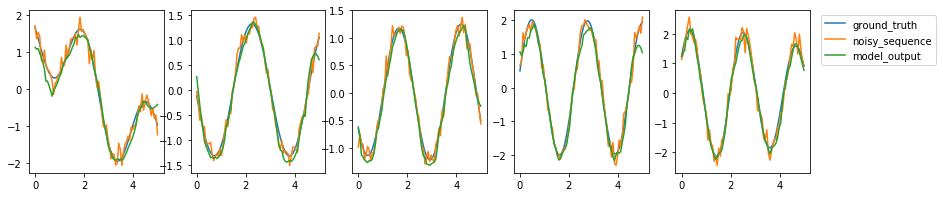

epoch: 98, validation loss:108.90166473388672


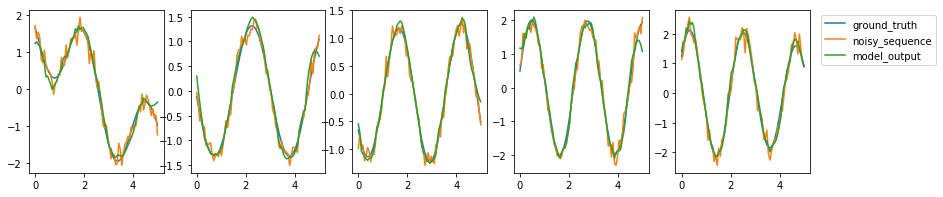

epoch: 99, validation loss:116.55390167236328


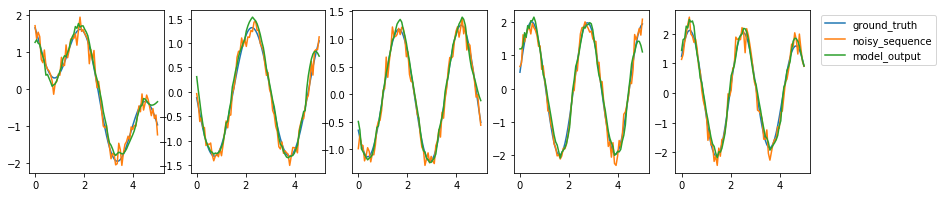

epoch: 100, validation loss:110.08097839355469


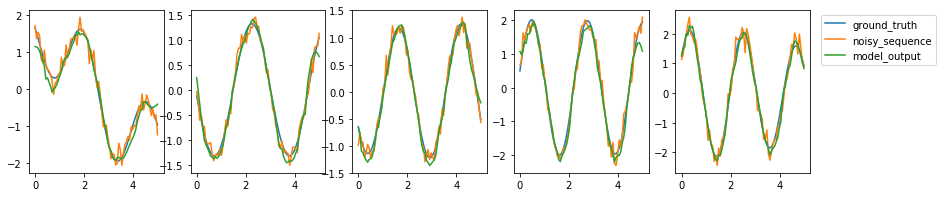

In [11]:
# Reducing the learning rate to 0.001

batch_size = 20
num_epochs = 101
learning_rate = 0.001 # <- CHANGED

model_3 = NoiseRemovalModel(hidden_size=40, shift=10)
optimizer = optim.Adam(model_3.parameters(), lr=learning_rate, betas=(0.6, 0.87))
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
print("cuda avialable :", torch.cuda.is_available())
train(model_3, optimizer, scheduler, num_epochs, batch_size)